# Packages used

In [1]:
!conda list
!which python
!python --version
!jupyter kernelspec list

# packages in environment at /Users/douglas/anaconda3/envs/jupyter_venv:
#
# Name                    Version                   Build  Channel
adjusttext                1.2.0              pyhd8ed1ab_0    conda-forge
anyio                     4.2.0           py312hecd8cb5_0  
appnope                   0.1.3           py312hecd8cb5_1001  
argon2-cffi               21.3.0             pyhd3eb1b0_0  
argon2-cffi-bindings      21.2.0          py312h6c40b1e_0  
asttokens                 2.0.5              pyhd3eb1b0_0  
async-lru                 2.0.4           py312hecd8cb5_0  
attrs                     23.1.0          py312hecd8cb5_0  
babel                     2.11.0          py312hecd8cb5_0  
beautifulsoup4            4.12.3          py312hecd8cb5_0  
blas                      1.0                    openblas  
bleach                    4.1.0              pyhd3eb1b0_0  
bottleneck                1.3.7           py312h32608ca_0  
brotli                    1.0.9                h6c40b1e_8  
br

# Data
Input: NutriTech clinical data, flx_df files for each group (e.g., flx_df_W5D2T0_.csv)

# Loading the nutritech data

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Load the entire Excel file
file_path = '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 12/NutriTech_otherdata_AVG.xlsx'
xls = pd.ExcelFile(file_path)

# Print the sheet names to see what sheets are available
print(xls.sheet_names)

# Load a sheet into a DataFrame by sheet name
df_week5_before = pd.read_excel(xls, sheet_name='week5_before_intervention', header = 1)
df_week13_after = pd.read_excel(xls, sheet_name='week13_after_intervention', header = 1)


['week5_before_intervention', 'week13_after_intervention']


## W5D2T0 PCA + nutritech data label

### Match Nutritech names and pw_flx columnnames

In [ ]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D2T0_'
pw_flx1 = pd.read_csv('pw_flx1.csv')
columns_to_compare = ['Age', 'BMI ', 'fasting triglyceride',  'IL1b-D1', 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2']

#Index(['name', 'Age', 'Gender', 'Body weight ', 'Body height ', 'BMI ',
 #      'Start group', 'fasting glucose', '2hr glucose', 'fasting insulin',
  #     'fasting triglyceride', 'HOMA-IR', 'Matsuda', 'IGI', 'CRP-D1',
   #    'E-Selectin-D1', 'IL18-D1', 'IL1b-D1', 'TNF-alpha-D1', 'VCAM-1-D1',
    #   'adiponectin-D1', 'ICAM-D2', 'ICAM1-D3', 'IL1-D2', 'IL1-D3', 'IL10-D2',
     #  'IL10-D3', 'IL6-D2', 'IL6-D3', 'IL8-D2', 'IL8-D3', 'MCP1-D2', 'MCP1-D3',
      # 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2',
       #'MCP1-(D2+D3)/2', 'ICAM1-(D2+D3)/2'],
      #dtype='object')


# Load the entire Excel file
file_path = '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/NutriTech_otherdata.xlsx'
xls = pd.ExcelFile(file_path)

# Print the sheet names to see what sheets are available
print(xls.sheet_names)

# Load a sheet into a DataFrame by sheet name
df_week5_before = pd.read_excel(xls, sheet_name='week5_before_intervention', header = 1)

# Extract the participant IDs from NutriTech data (assuming they are in 'name' column)
nutritech_ids = df_week5_before['name'].tolist()
# Extract the participant IDs from pw_flx1.csv column names
pw_flx1_ids = pw_flx1.columns.str.extract(r'(NT\d+)_')[0]

# Initialize lists to capture missing IDs and unmatched columns
missing_ids = []
unmatched_columns = pw_flx1.columns.tolist()

# Map the NutriTech IDs to the corresponding columns in pw_flx1.csv
mapping = {}
for nt_id in nutritech_ids:
    if nt_id in pw_flx1_ids.values:
        matched_column = pw_flx1.columns[pw_flx1_ids[pw_flx1_ids == nt_id].index[0]]
        mapping[nt_id] = matched_column
        unmatched_columns.remove(matched_column)
    else:
        missing_ids.append(nt_id)

# Print results
print("Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:")
print(mapping)

if missing_ids:
    print("\nWarning: The following NutriTech IDs were not found in pw_flx1.csv:")
    print(missing_ids)

if unmatched_columns:
    print("\nWarning: The following columns in pw_flx1.csv did not match any NutriTech IDs:")
    print(unmatched_columns)

for NT_data in columns_to_compare:
    # Example: Define labels based on NT data ranges
    df_week5_before[f'{NT_data}_range'] = pd.qcut(df_week5_before[f'{NT_data}'], 5, labels=['Bottom 20%', '20-40%', '40-60%', '60-80%', 'Top 20%'])

    # Extract corresponding labels for the columns in pw_flx1.csv based on the mapping
    pca_labels = []
    for column in pw_flx1.columns:
        matched_id = next((key for key, value in mapping.items() if value == column), None)
        if matched_id:
            label = df_week5_before.loc[df_week5_before['name'] == matched_id, f'{NT_data}_range'].values[0]
            pca_labels.append(label)
        else:
            pca_labels.append('Unknown')

    # Perform PCA
    pca = PCA(n_components=3)
    pcaData = pca.fit_transform(pw_flx1.T)  # Transpose to make samples as rows
    print(pca.explained_variance_ratio_)

    title_font = {
        'weight': 'medium',
        'size': 12,
    }
    axis_font = {
        'weight': 'normal',
        'size': 10,
    }

    # Color coding based on NT data ranges or other labels
    colors = []
    for label in pca_labels:
        if label == 'Bottom 20%':
            colors.append('blue')
        elif label == '20-40%':
            colors.append('green')
        elif label == '40-60%':
            colors.append('yellow')
        elif label == '60-80%':
            colors.append('orange')
        elif label == 'Top 20%':
            colors.append('red')
        else:
            colors.append('gray')  # For unknown or missing labels

    # Plot PCA scatter plot
    fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
    for i in range(len(pca_labels)):
        xs = pcaData[i, 0]
        ys = pcaData[i, 1]
        plt.scatter(xs, ys, s=20, marker='o', color=colors[i], alpha=0.8)

    # Add legend
    handles = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='Bottom 20%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='20-40%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='yellow', markersize=10, label='40-60%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', markersize=10, label='60-80%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Top 20%'),
    ]
    plt.legend(handles=handles, title=f'{NT_data}_ranges')

    plt.title(f'{file_ID}_{NT_data} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', title_font)
    plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), axis_font)
    plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), axis_font)
    plt.figtext(0.5, -0.23, (f'Figure 1. PCA results for the flux correlations.\n Each point in the scatterplot represents a participant\'s context-specific model.\n\n The explained variances of the first and second principal components were {pca.explained_variance_ratio_[0]*100:.2f}% and {pca.explained_variance_ratio_[1]*100:.2f}%, respectively, resulting in a combined variance of {((pca.explained_variance_ratio_[0]*100)+(pca.explained_variance_ratio_[1]*100)):.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)
    #plt.savefig(f'{file_ID}fig.1_{NT_data}_PCA_for_Flux_Correlation.png', dpi=1000)

    ####################### Create a 4x4 plot matrix of PC1, PC2, PC3, and PC4
    # Perform PCA
    pca = PCA(n_components=4)
    pcaData = pca.fit_transform(pw_flx1.T)
    explained_variance = pca.explained_variance_ratio_

    fig, axs = plt.subplots(4, 4, figsize=(20, 20))

    pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
    components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

    for i in range(4):
        for j in range(4):
            if i == j:
                for k, c in zip(components[i], colors):
                    axs[i, j].hist(k, bins=20, color=c, alpha=0.8)
            else:
                for x, y, c in zip(components[j], components[i], colors):
                    axs[i, j].scatter(x, y, color=c, s=20, alpha=0.8)
            if i == 3:
                axs[i, j].set_xlabel(pc_labels[j])
            if j == 0:
                axs[i, j].set_ylabel(pc_labels[i])

    # Add a legend
    handles = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='Bottom 20%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='20-40%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='yellow', markersize=10, label='40-60%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', markersize=10, label='60-80%'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Top 20%'),
    ]
    fig.legend(handles=handles, title=f'{NT_data}_ranges', loc='upper right')

    plt.suptitle(f'{file_ID}_{NT_data} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
    plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                             f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                             f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                             f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

    #plt.savefig(f'{file_ID}fig.2_{NT_data}_Pairwise_Scatter_Plots_of_PC1_to_PC4.png', dpi=1000)
    plt.show()







### W5D2T0 colourgradient 

['week5_before_intervention', 'week13_after_intervention']
Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:
{'NT001': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T0/NT001_W5D2T0', 'NT002': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T0/NT002_W5D2T0', 'NT006': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T0/NT006_W5D2T0', 'NT008': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinfo

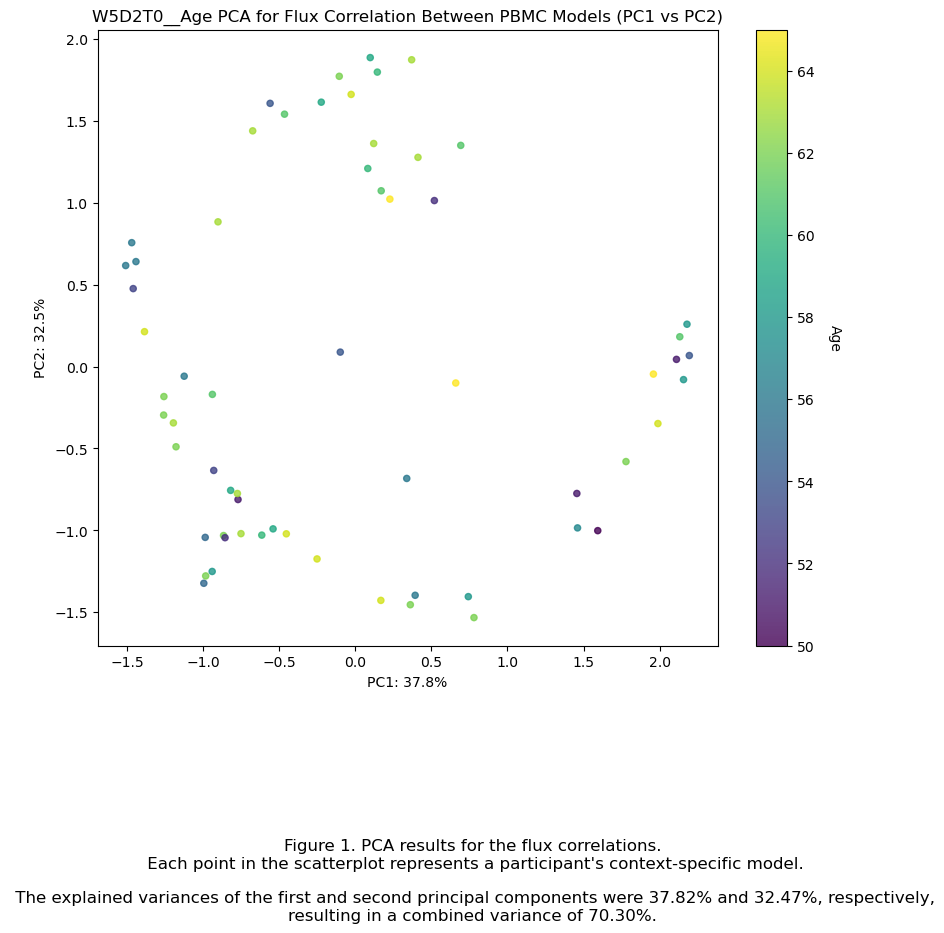

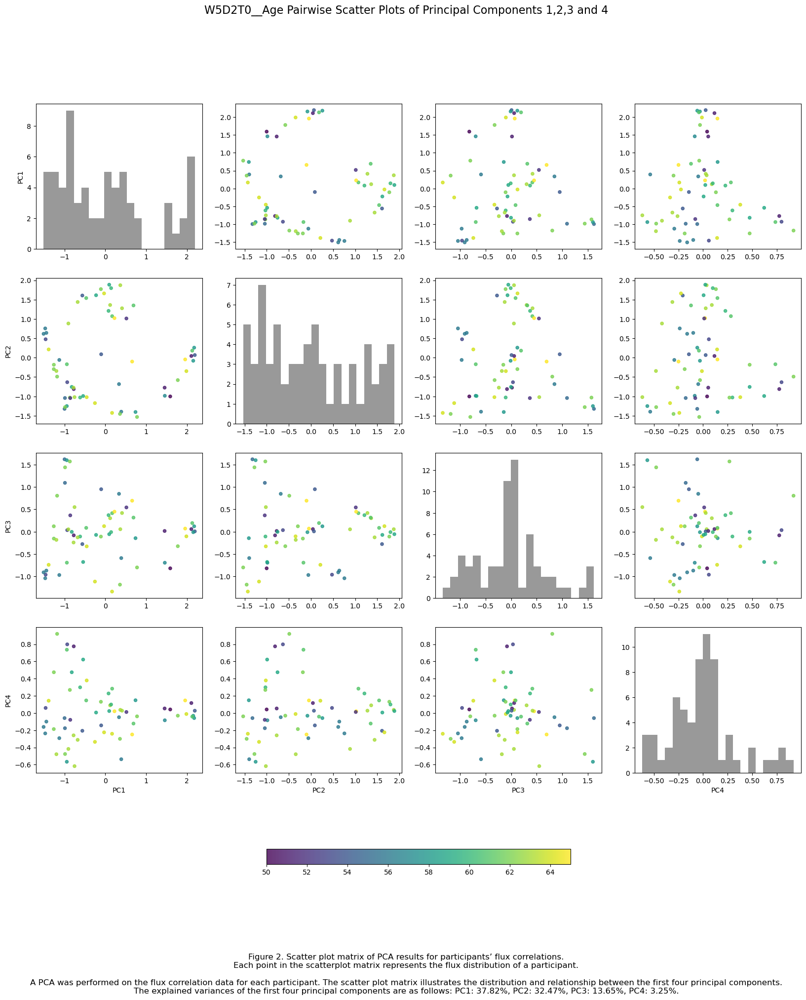

[0.37824503 0.32473143 0.13652004]


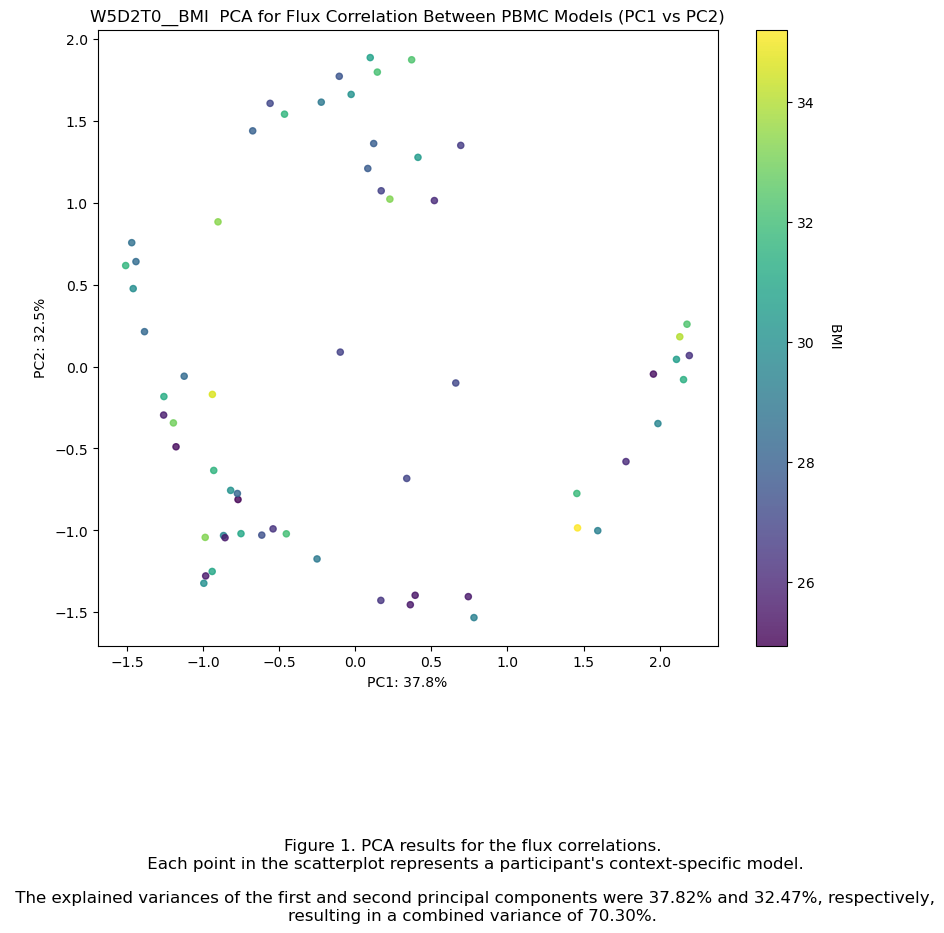

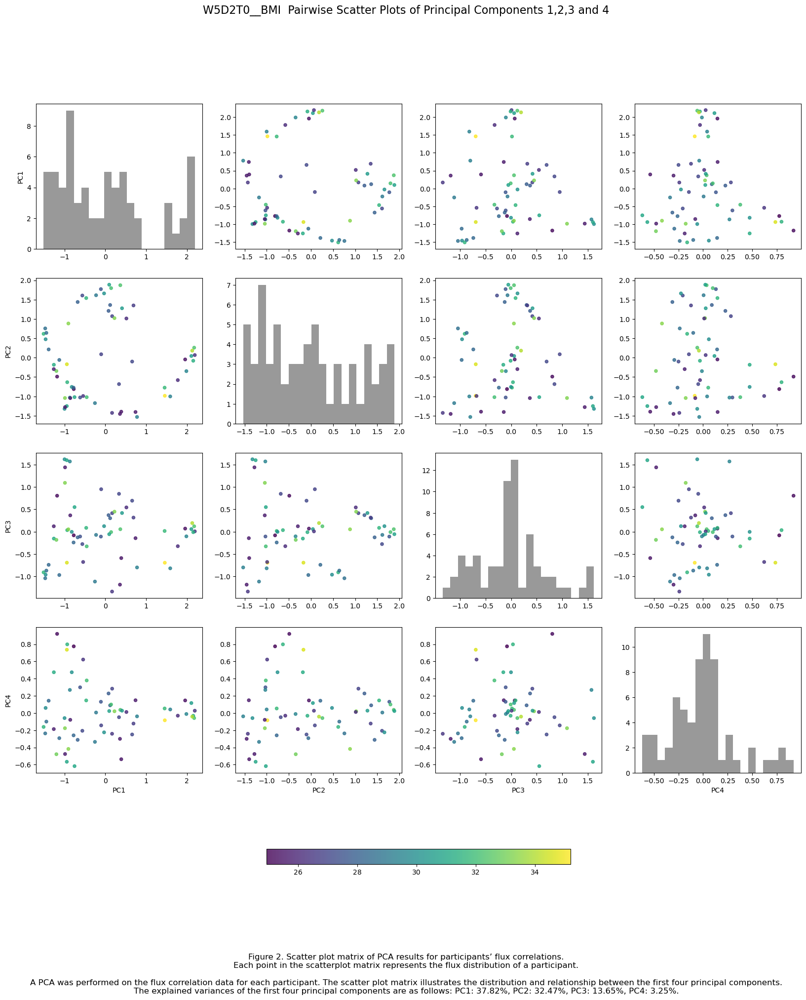

[0.37824503 0.32473143 0.13652004]


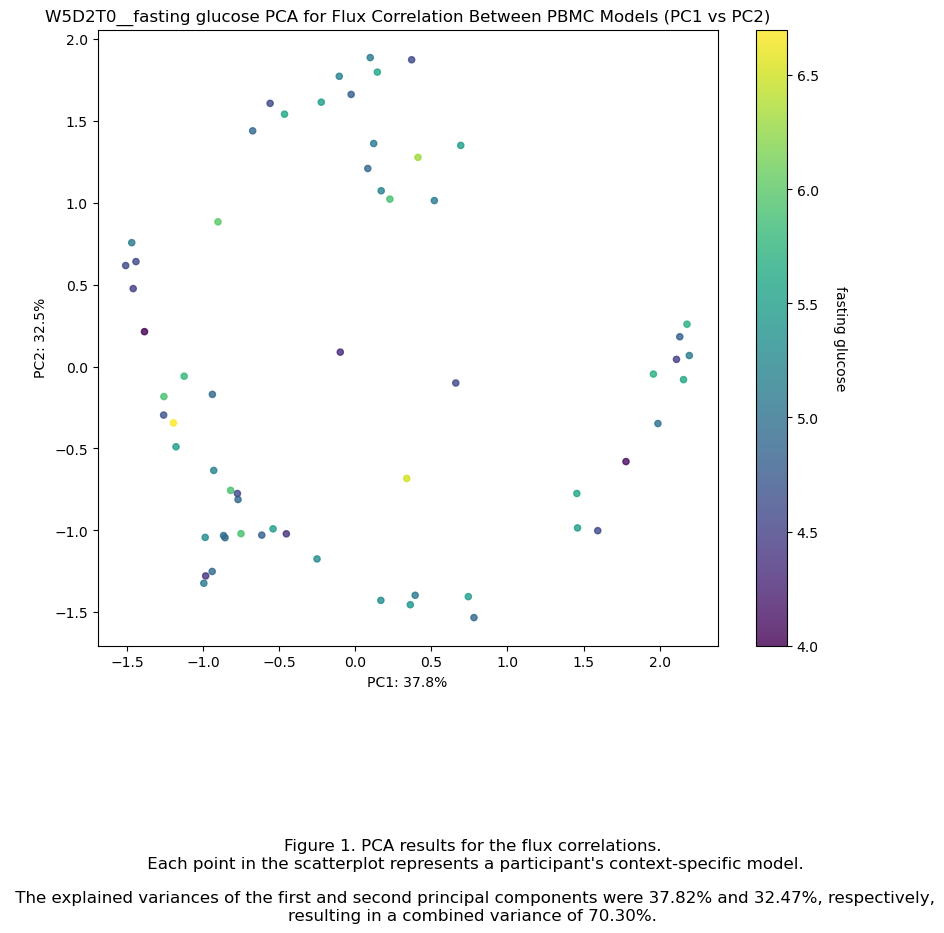

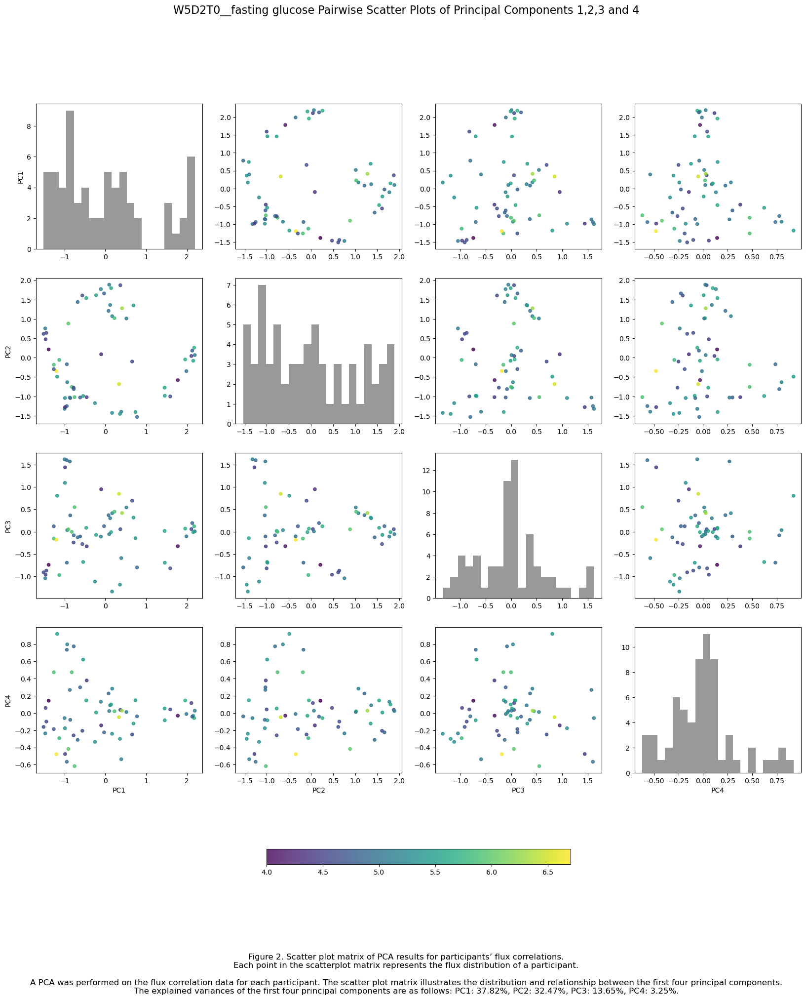

[0.37824503 0.32473143 0.13652004]


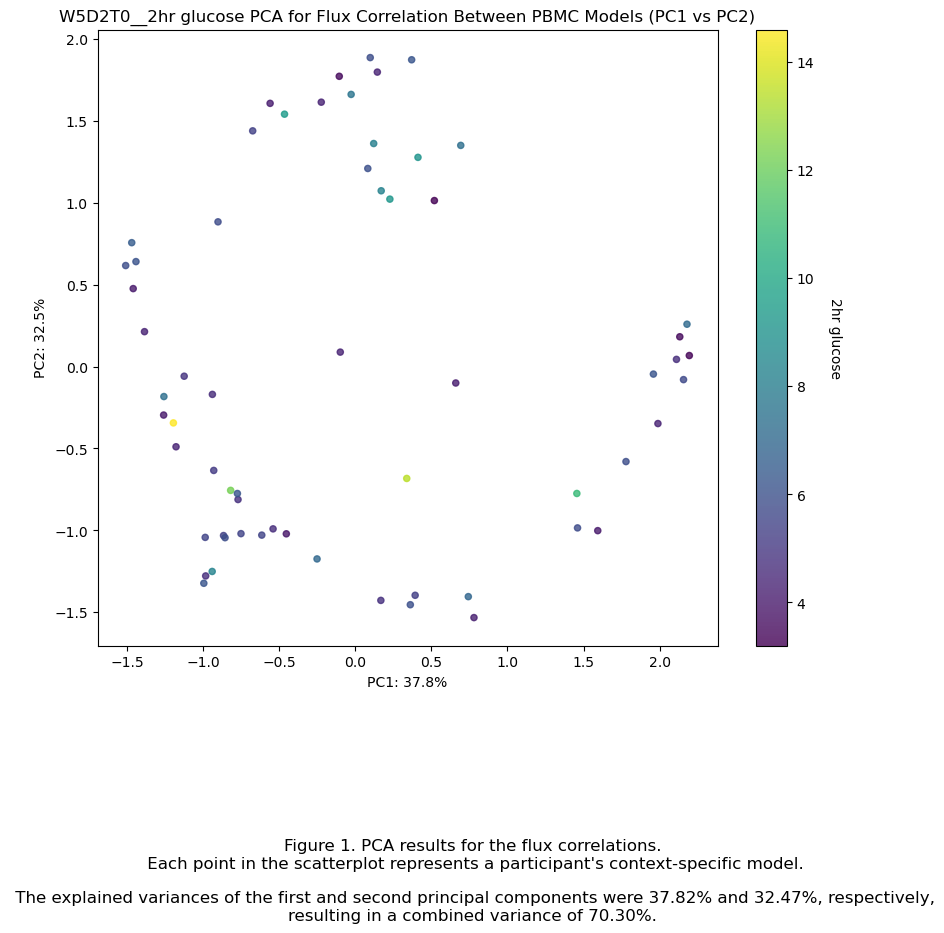

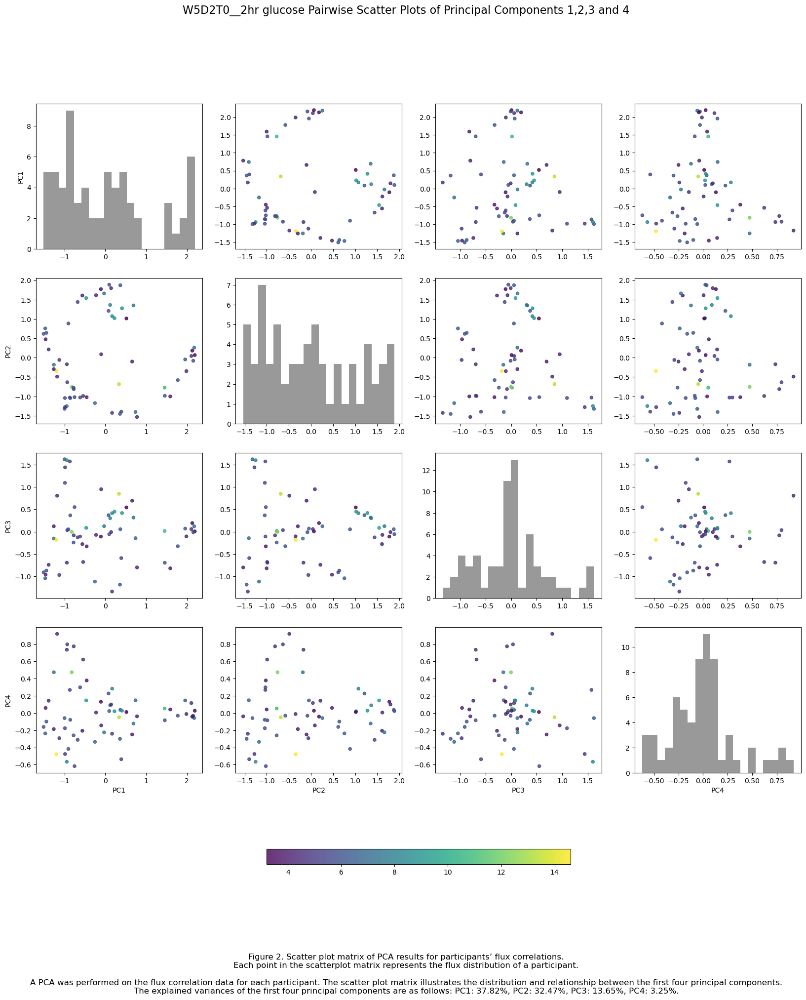

[0.37824503 0.32473143 0.13652004]


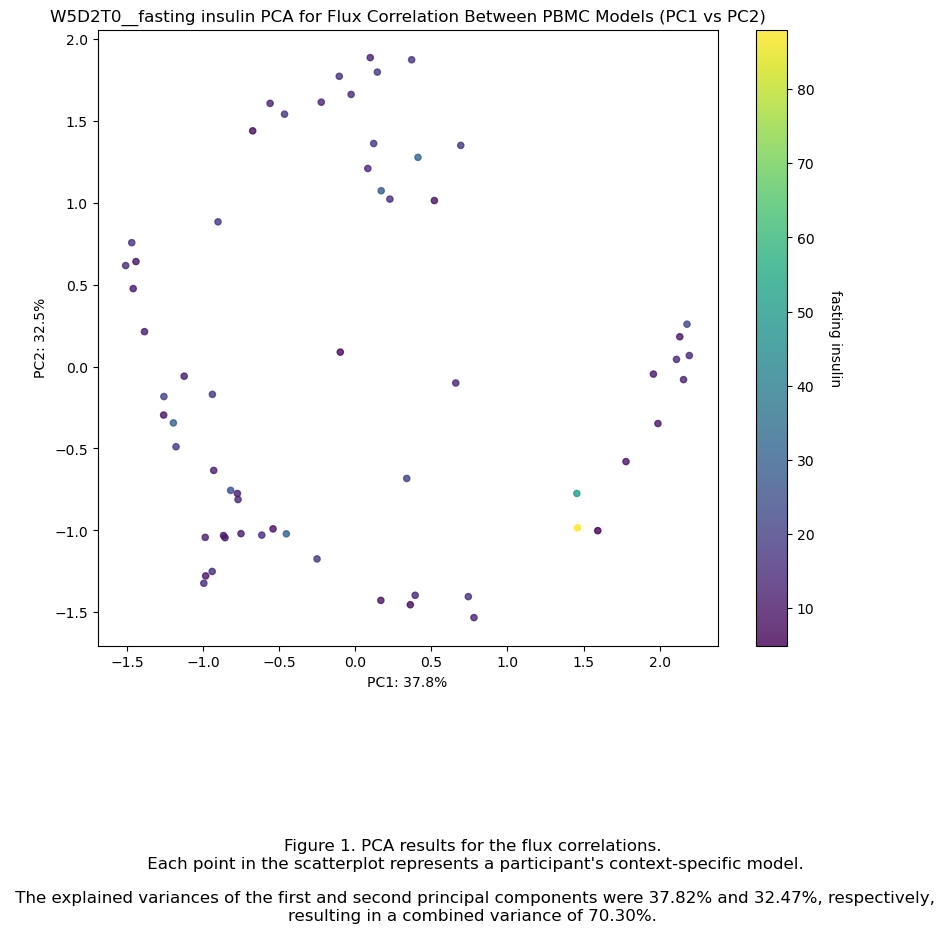

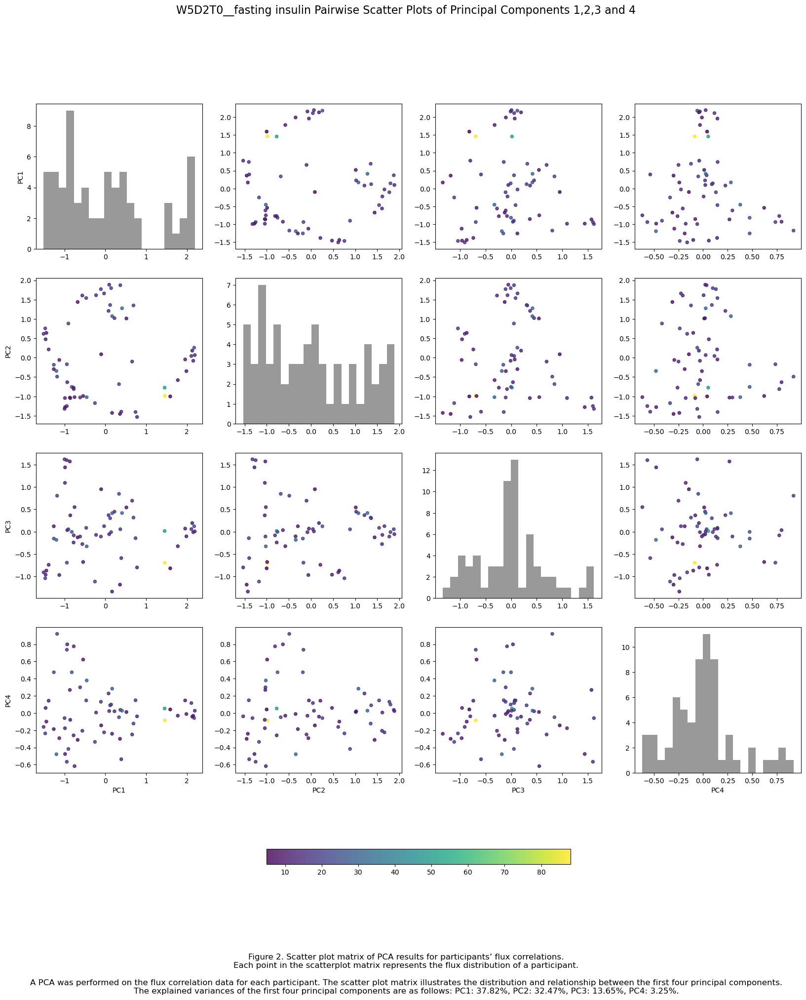

[0.37824503 0.32473143 0.13652004]


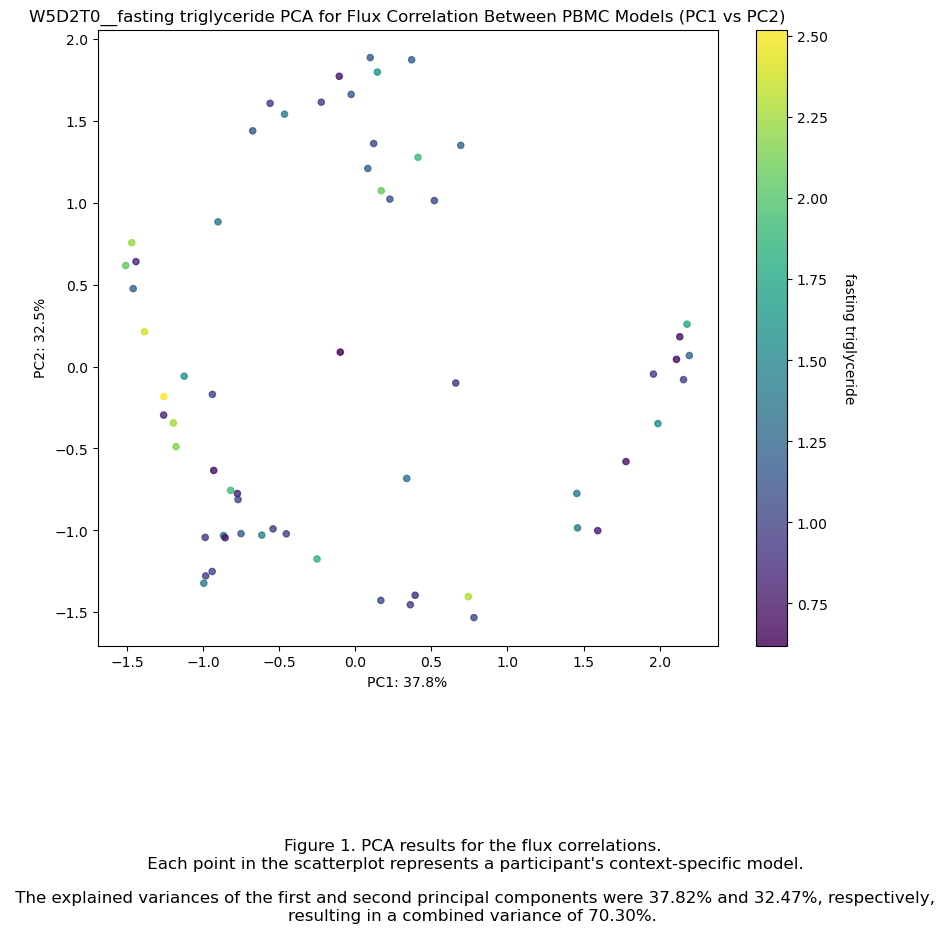

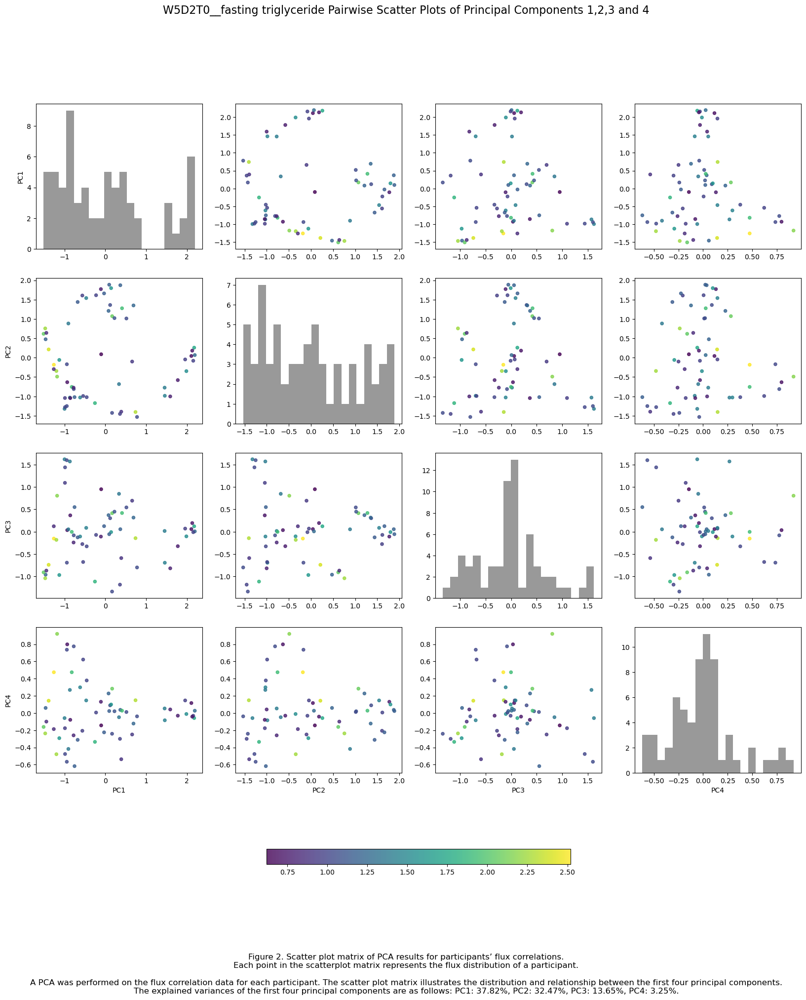

[0.37824503 0.32473143 0.13652004]


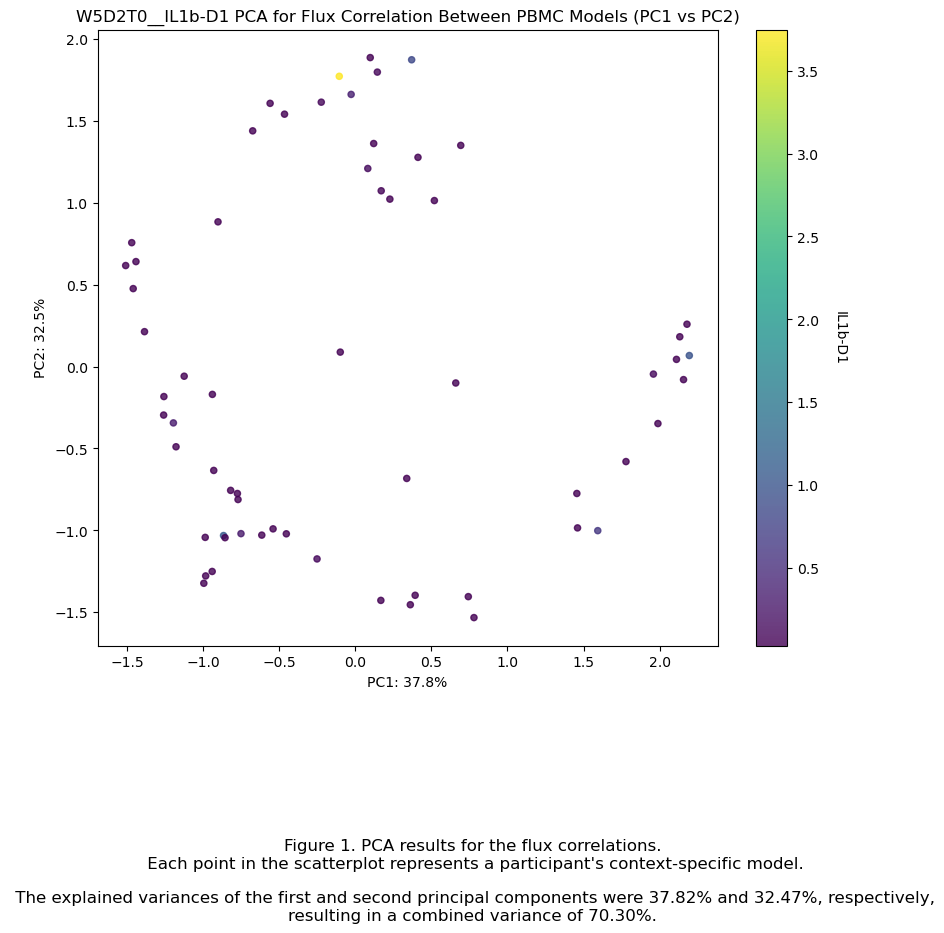

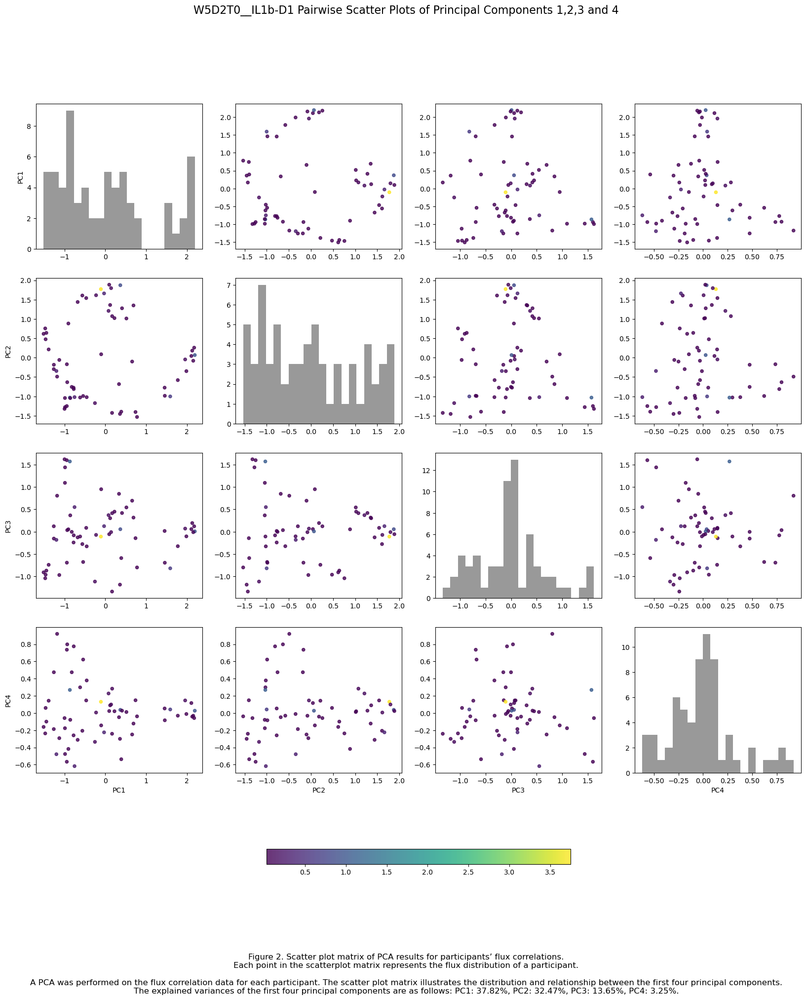

KeyError: 'IL1-(D2+D3)/2'

In [4]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D2T0_'
pw_flx1 = pd.read_csv('pw_flx1.csv')
columns_to_compare = ['Age', 'BMI ', 'fasting glucose', '2hr glucose', 
                      'fasting insulin', 'fasting triglyceride',  'IL1b-D1', 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2', 
                      'MCP1-(D2+D3)/2', 'ICAM1-(D2+D3)/2']

#columns_to_compare = ['Age','Body weight ', 'Body height ', 'BMI ', 'fasting glucose', '2hr glucose',
                      #'fasting insulin', 'fasting triglyceride', 'HOMA-IR', 'Matsuda', 'IGI', 'CRP-D1',
                      #'E-Selectin-D1', 'IL18-D1', 'IL1b-D1', 'TNF-alpha-D1', 'VCAM-1-D1',
                      #'adiponectin-D1', 'ICAM-D2', 'ICAM1-D3', 'IL1-D2', 'IL1-D3', 'IL10-D2',
                      #'IL10-D3', 'IL6-D2', 'IL6-D3', 'IL8-D2', 'IL8-D3', 'MCP1-D2', 'MCP1-D3']


# Load the entire Excel file
file_path = '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/NutriTech_otherdata.xlsx'
xls = pd.ExcelFile(file_path)

# Print the sheet names to see what sheets are available
print(xls.sheet_names)

# Load a sheet into a DataFrame by sheet name
df_week5_before = pd.read_excel(xls, sheet_name='week5_before_intervention', header = 1)

# Extract the participant IDs from NutriTech data (assuming they are in 'name' column)
nutritech_ids = df_week5_before['name'].tolist()
# Extract the participant IDs from pw_flx1.csv column names
pw_flx1_ids = pw_flx1.columns.str.extract(r'(NT\d+)_')[0]

# Initialize lists to capture missing IDs and unmatched columns
missing_ids = []
unmatched_columns = pw_flx1.columns.tolist()

# Map the NutriTech IDs to the corresponding columns in pw_flx1.csv
mapping = {}
for nt_id in nutritech_ids:
    if nt_id in pw_flx1_ids.values:
        matched_column = pw_flx1.columns[pw_flx1_ids[pw_flx1_ids == nt_id].index[0]]
        mapping[nt_id] = matched_column
        unmatched_columns.remove(matched_column)
    else:
        missing_ids.append(nt_id)

# Print results
print("Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:")
print(mapping)

if missing_ids:
    print("\nWarning: The following NutriTech IDs were not found in pw_flx1.csv:")
    print(missing_ids)

if unmatched_columns:
    print("\nWarning: The following columns in pw_flx1.csv did not match any NutriTech IDs:")
    print(unmatched_columns)


for NT_data in columns_to_compare:
    # Extract corresponding labels (numeric values) for the columns in pw_flx1.csv based on the mapping
    pca_labels = []
    for column in pw_flx1.columns:
        matched_id = next((key for key, value in mapping.items() if value == column), None)
        if matched_id:
            label = df_week5_before.loc[df_week5_before['name'] == matched_id, NT_data].values[0]
            pca_labels.append(label)
        else:
            pca_labels.append(np.nan)  # Handle missing data

    # Perform PCA
    pca = PCA(n_components=3)
    pcaData = pca.fit_transform(pw_flx1.T)  # Transpose to make samples as rows
    print(pca.explained_variance_ratio_)

    # Normalize pca_labels for color mapping
    norm = plt.Normalize(vmin=min(pca_labels), vmax=max(pca_labels))
    cmap = plt.cm.viridis  # You can choose any colormap

    title_font = {
        'weight': 'medium',
        'size': 12,
    }
    axis_font = {
        'weight': 'normal',
        'size': 10,
    }

    # Plot PCA scatter plot with color gradient
    fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
    sc = plt.scatter(pcaData[:, 0], pcaData[:, 1], s=20, marker='o', c=pca_labels, cmap=cmap, norm=norm, alpha=0.8)

    # Add color bar
    cbar = plt.colorbar(sc)
    cbar.set_label(f'{NT_data}', rotation=270, labelpad=20)

    plt.title(f'{file_ID}_{NT_data} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', title_font)
    plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), axis_font)
    plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), axis_font)
    plt.figtext(0.5, -0.23, (f'Figure 1. PCA results for the flux correlations.\n Each point in the scatterplot represents a participant\'s context-specific model.\n\n The explained variances of the first and second principal components were {pca.explained_variance_ratio_[0]*100:.2f}% and {pca.explained_variance_ratio_[1]*100:.2f}%, respectively, resulting in a combined variance of {((pca.explained_variance_ratio_[0]*100)+(pca.explained_variance_ratio_[1]*100)):.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)
    #plt.savefig(f'{file_ID}fig.1_{NT_data}_PCA_for_Flux_Correlation.png', dpi=1000)

    ####################### Create a 4x4 plot matrix of PC1, PC2, PC3, and PC4
    # Perform PCA
    pca = PCA(n_components=4)
    pcaData = pca.fit_transform(pw_flx1.T)
    explained_variance = pca.explained_variance_ratio_

    fig, axs = plt.subplots(4, 4, figsize=(20, 20))

    pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
    components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

    for i in range(4):
        for j in range(4):
            if i == j:
                axs[i, j].hist(components[i], bins=20, color='gray', alpha=0.8)  # Histogram does not need color mapping
            else:
                sc = axs[i, j].scatter(components[j], components[i], c=pca_labels, cmap=cmap, norm=norm, s=20, alpha=0.8)
            if i == 3:
                axs[i, j].set_xlabel(pc_labels[j])
            if j == 0:
                axs[i, j].set_ylabel(pc_labels[i])

    # Add a shared color bar
    fig.colorbar(sc, ax=axs, orientation='horizontal', fraction=0.02, pad=0.1)

    plt.suptitle(f'{file_ID}_{NT_data} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
    plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                             f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                             f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                             f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

    #plt.savefig(f'{file_ID}fig.2_{NT_data}_Pairwise_Scatter_Plots_of_PC1_to_PC4.png', dpi=1000)
    plt.show()


# W5D2T120, Nutritech data + colour gradient

['week5_before_intervention', 'week13_after_intervention']
Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:
{'NT001': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T120/NT001_W5D2T120', 'NT002': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T120/NT002_W5D2T120', 'NT006': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D2T120/NT006_W5D2T120', 'NT008': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork

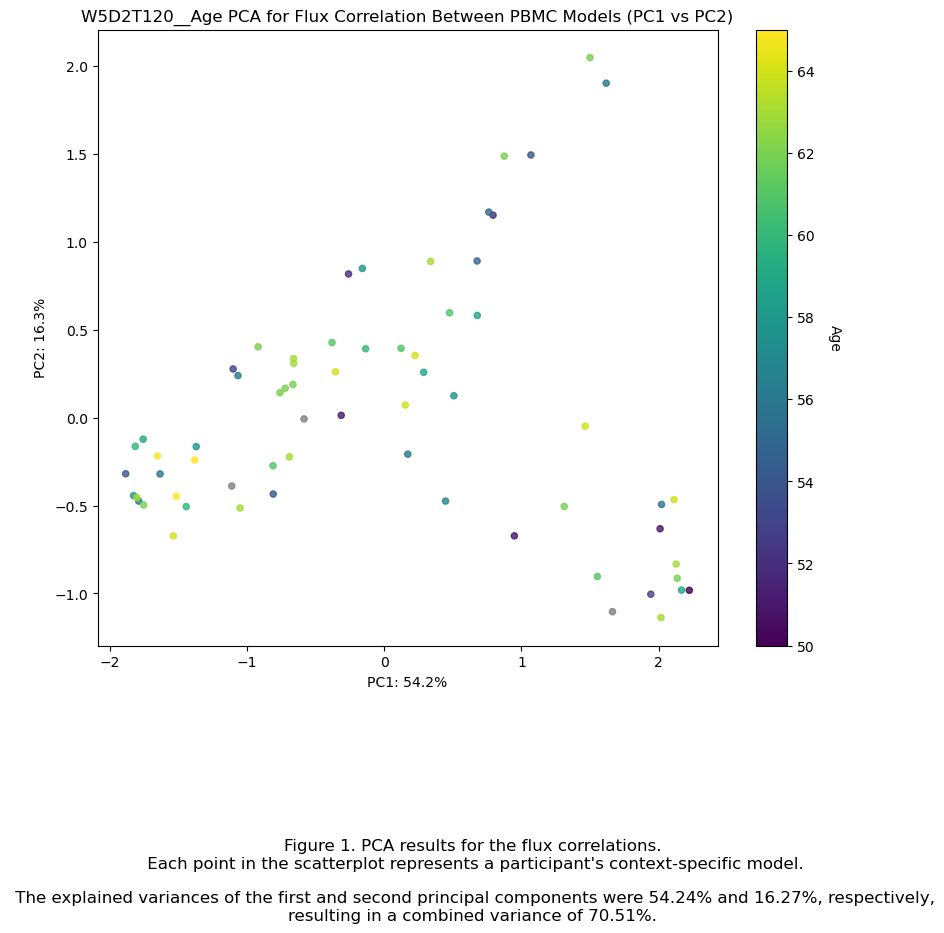

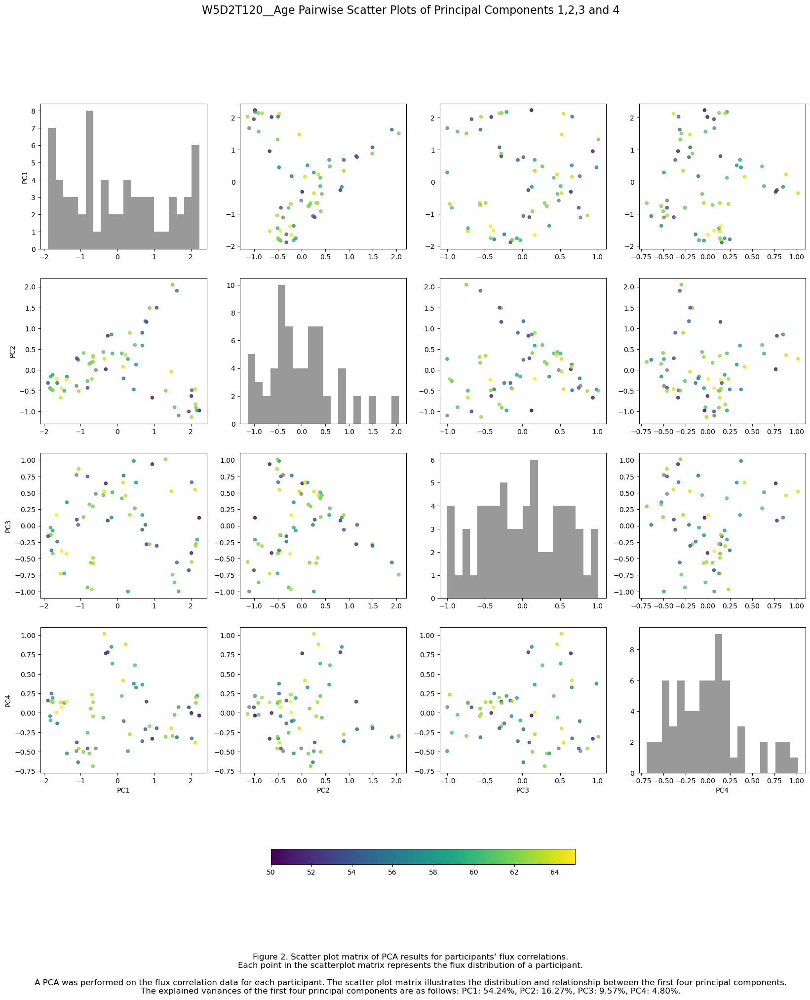

[0.54239113 0.16269086 0.09566434]


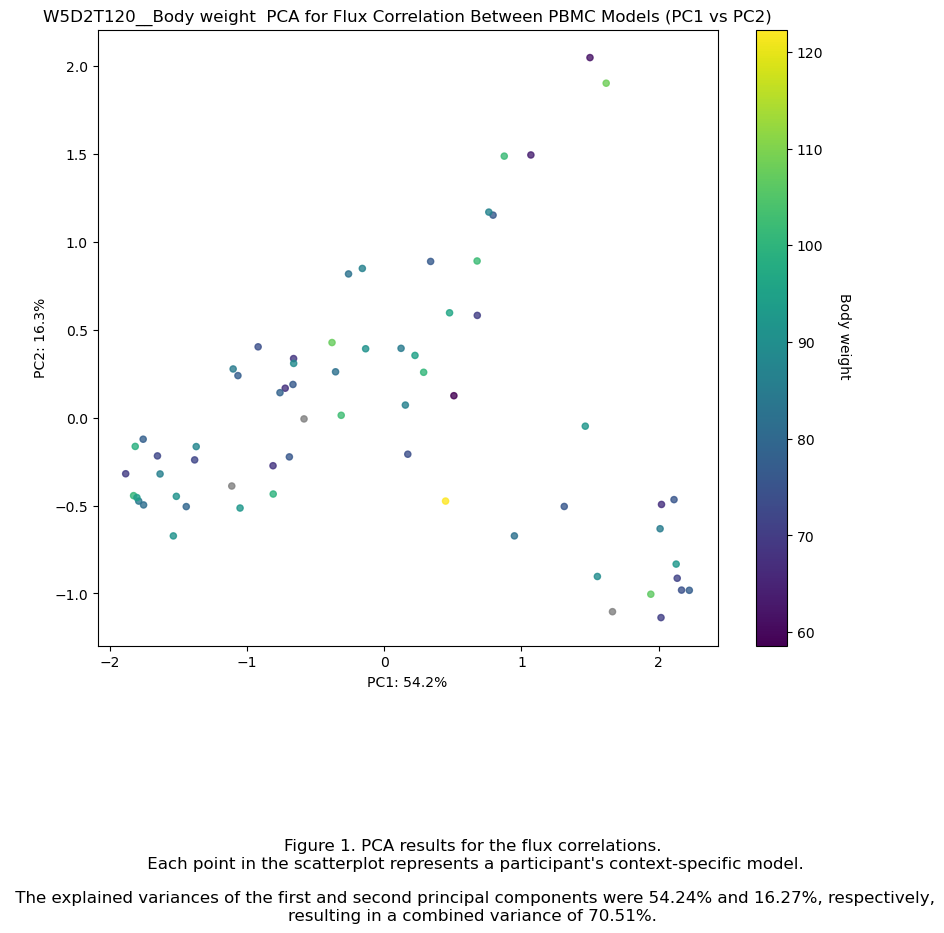

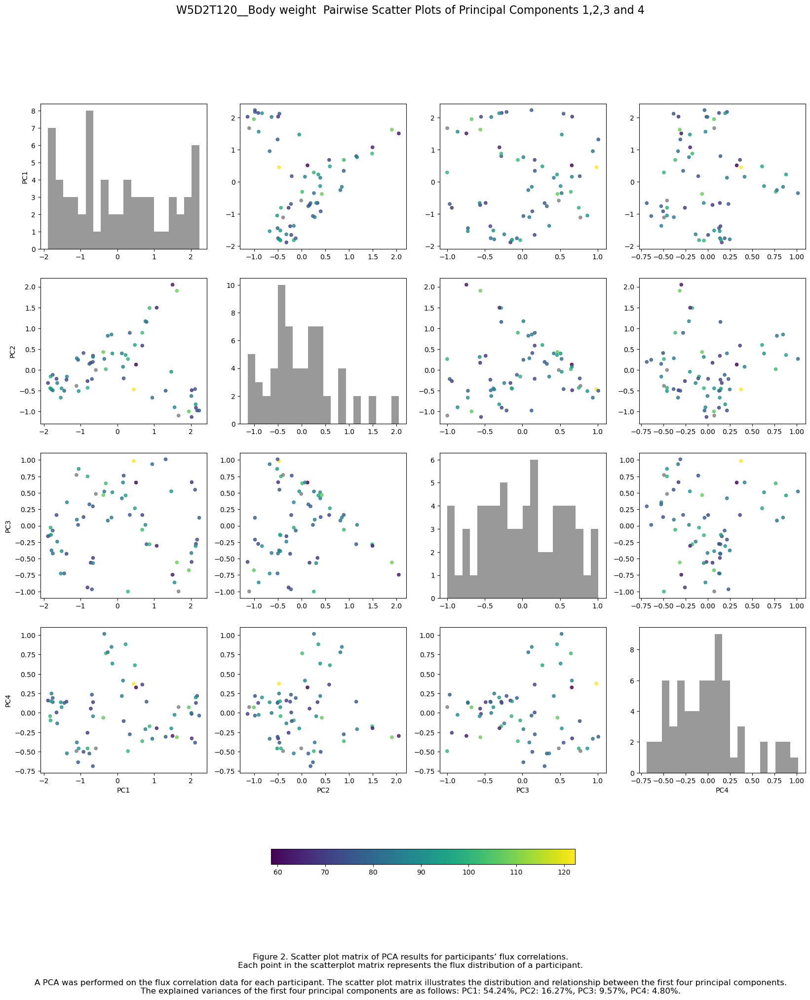

[0.54239113 0.16269086 0.09566434]


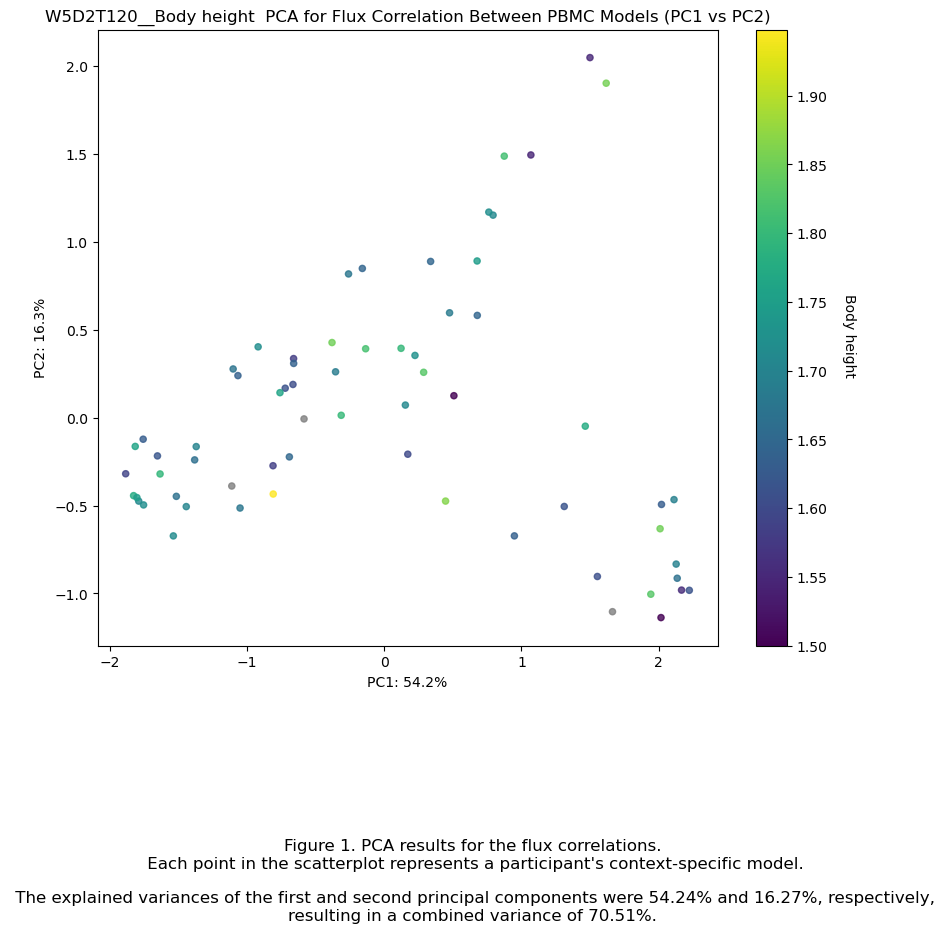

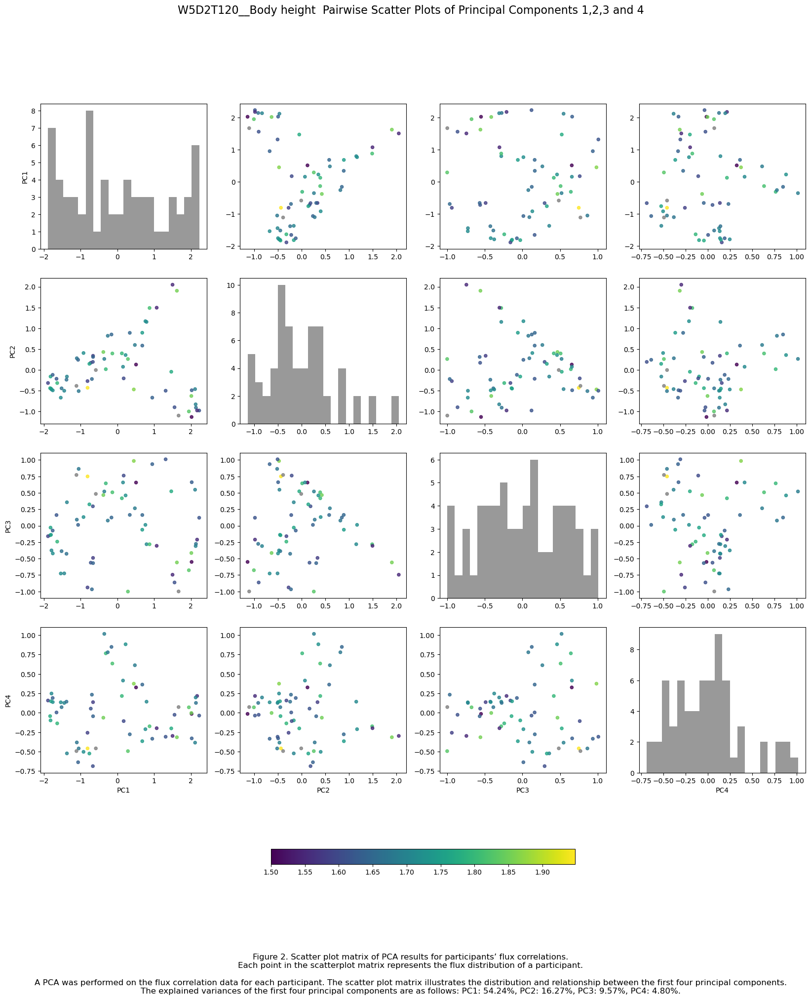

[0.54239113 0.16269086 0.09566434]


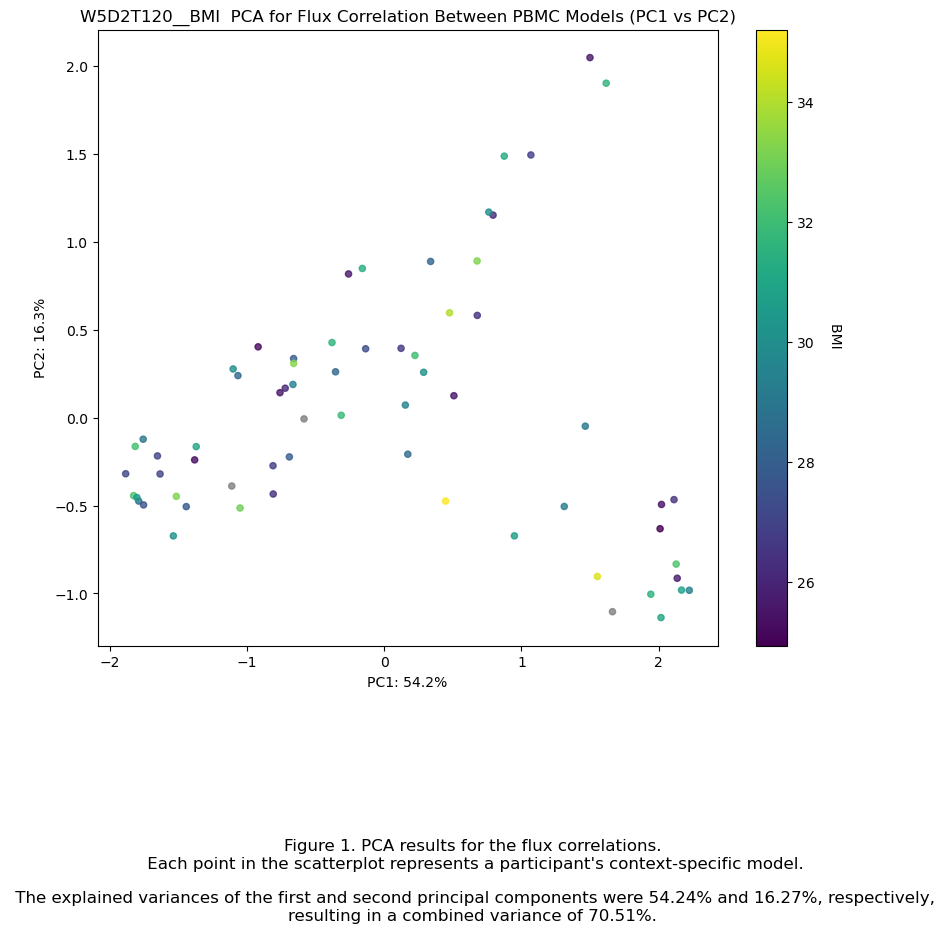

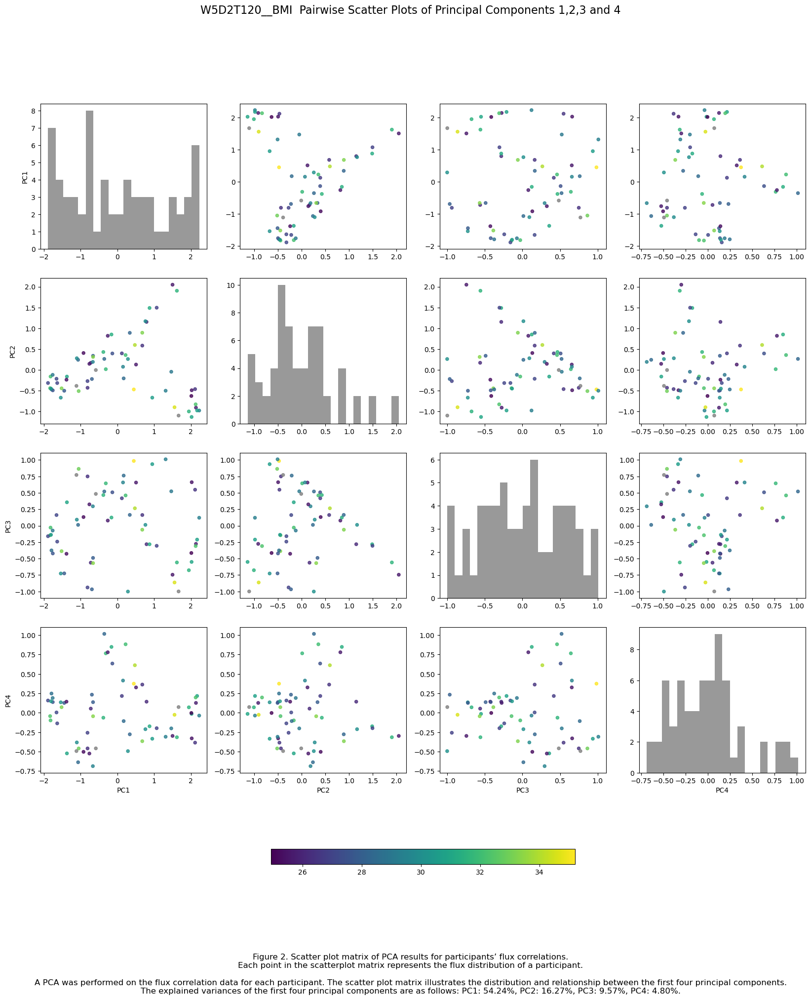

[0.54239113 0.16269086 0.09566434]


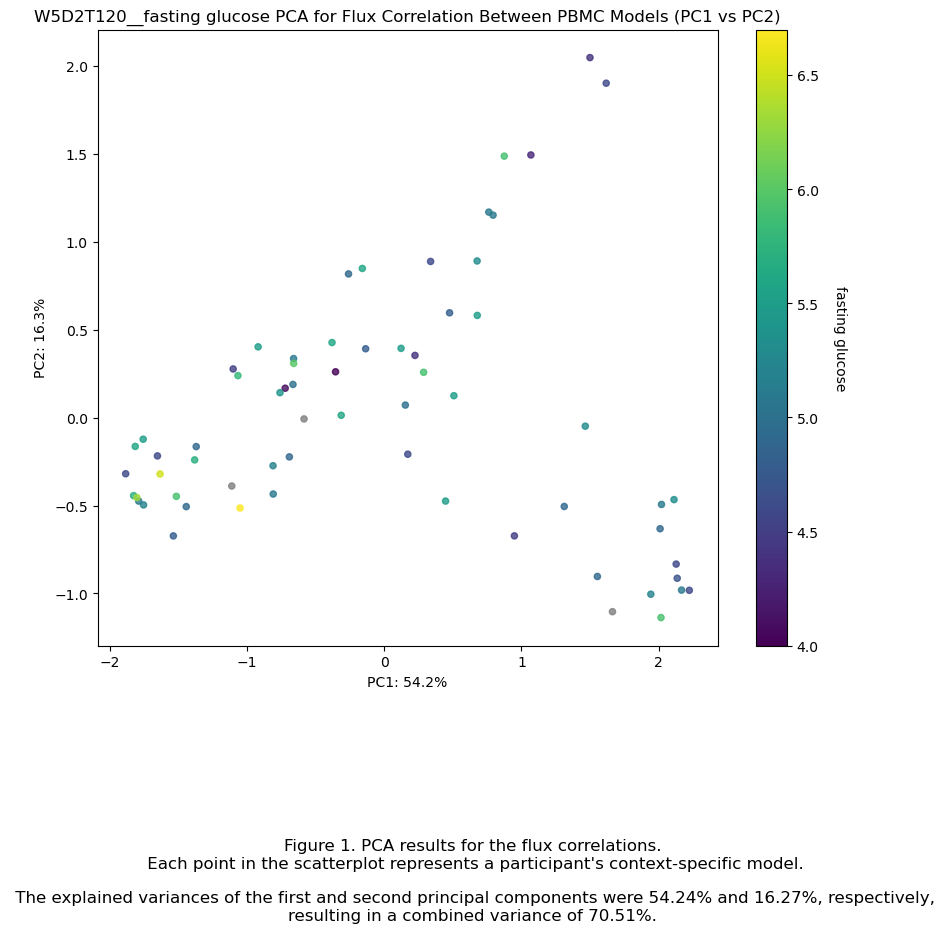

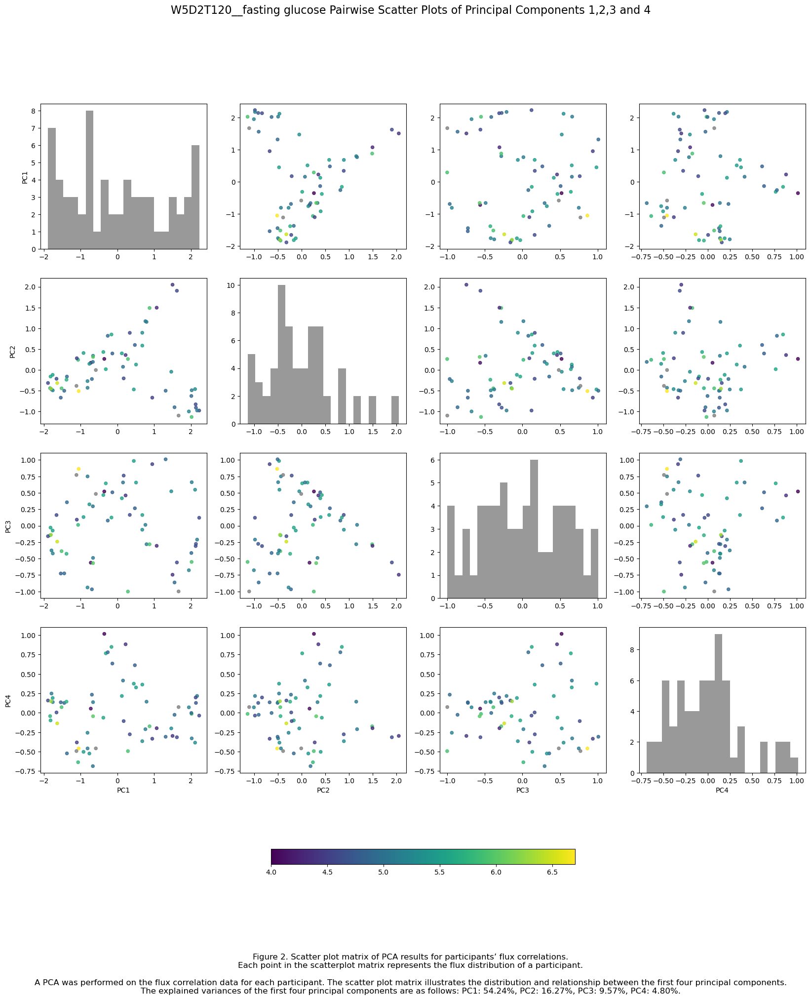

[0.54239113 0.16269086 0.09566434]


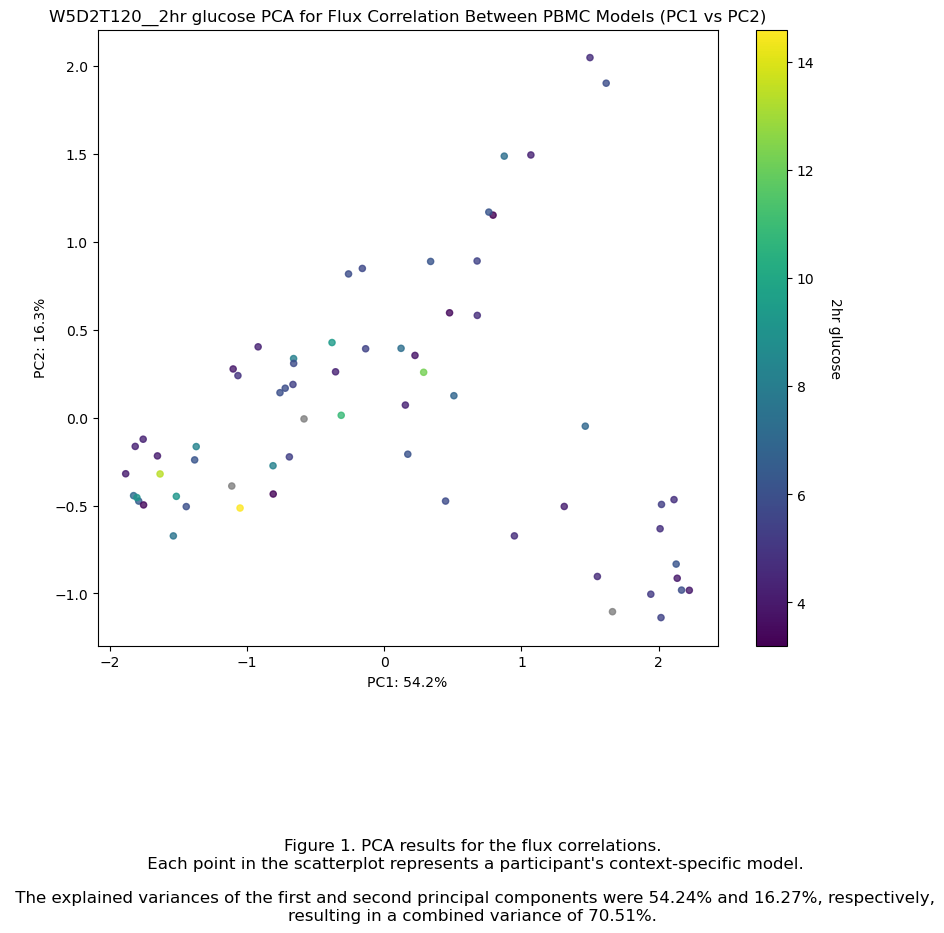

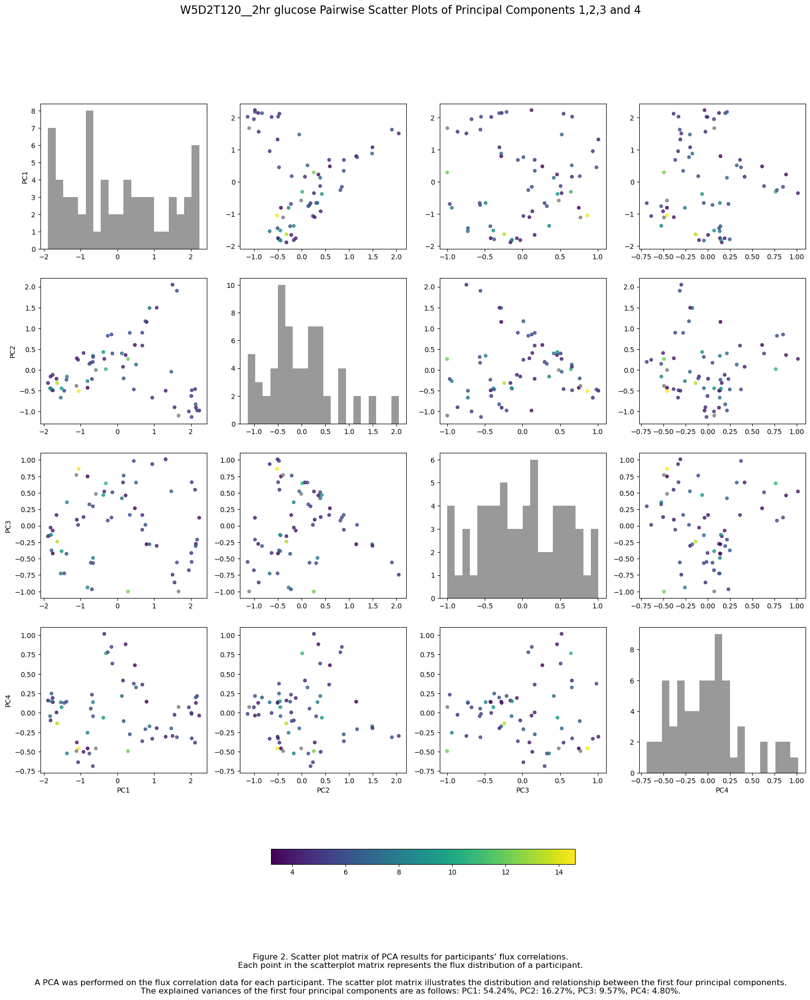

[0.54239113 0.16269086 0.09566434]


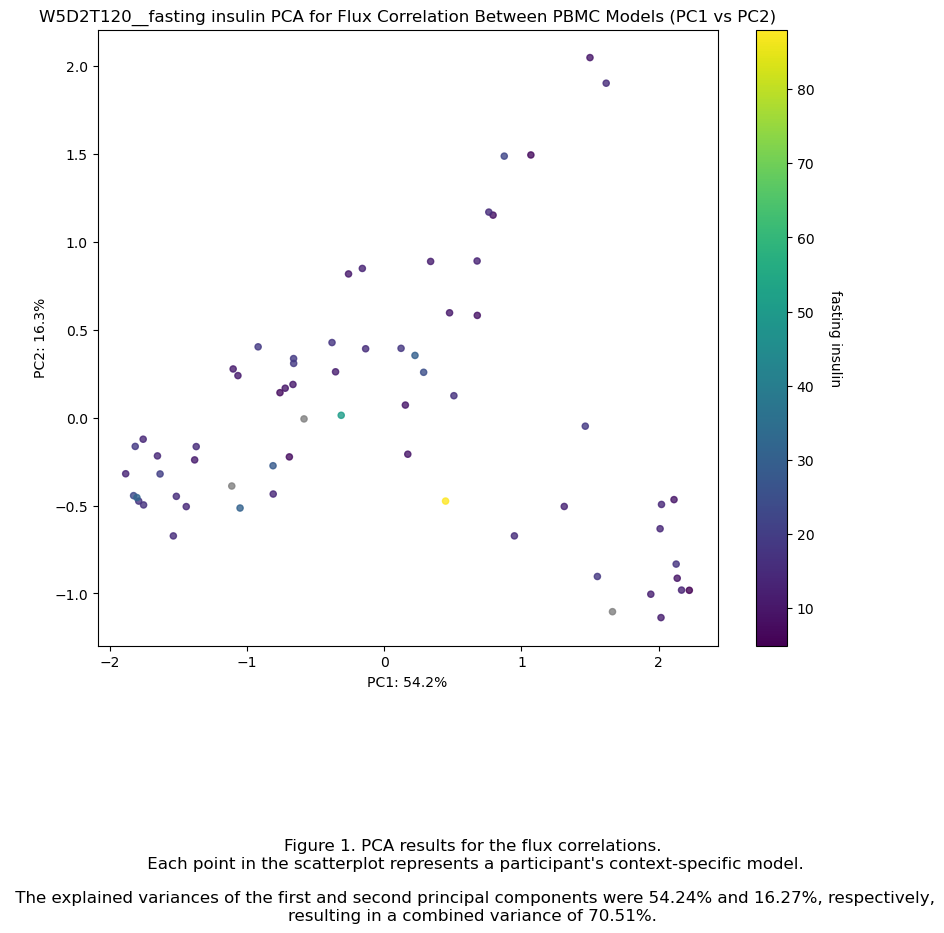

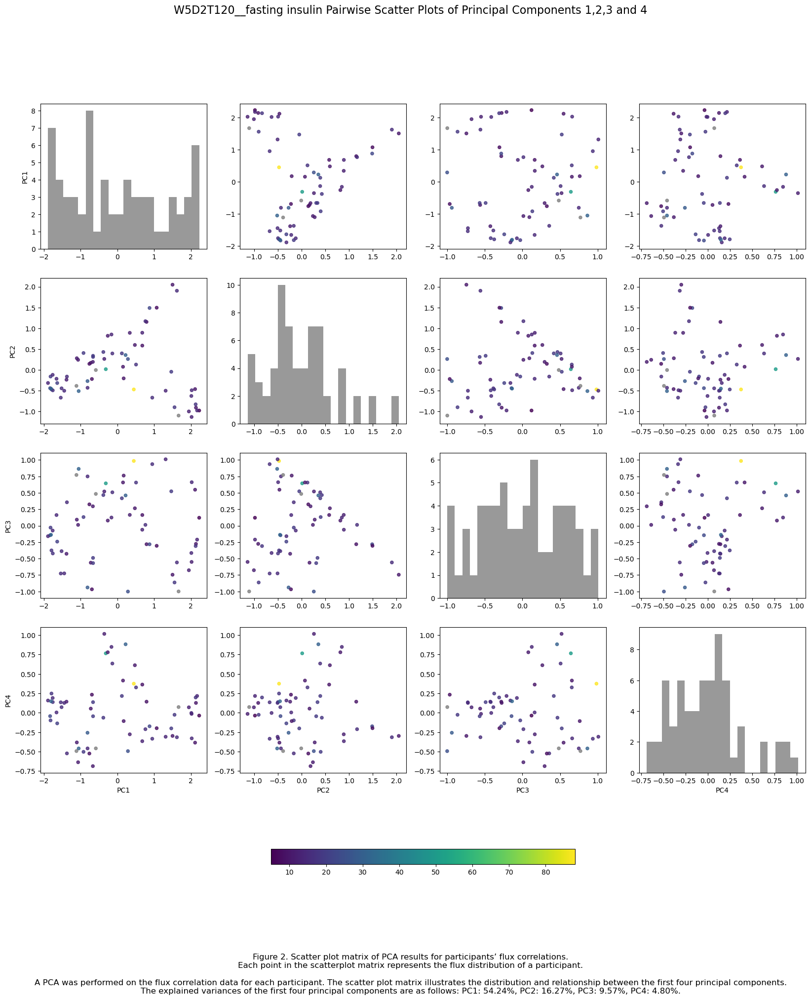

[0.54239113 0.16269086 0.09566434]


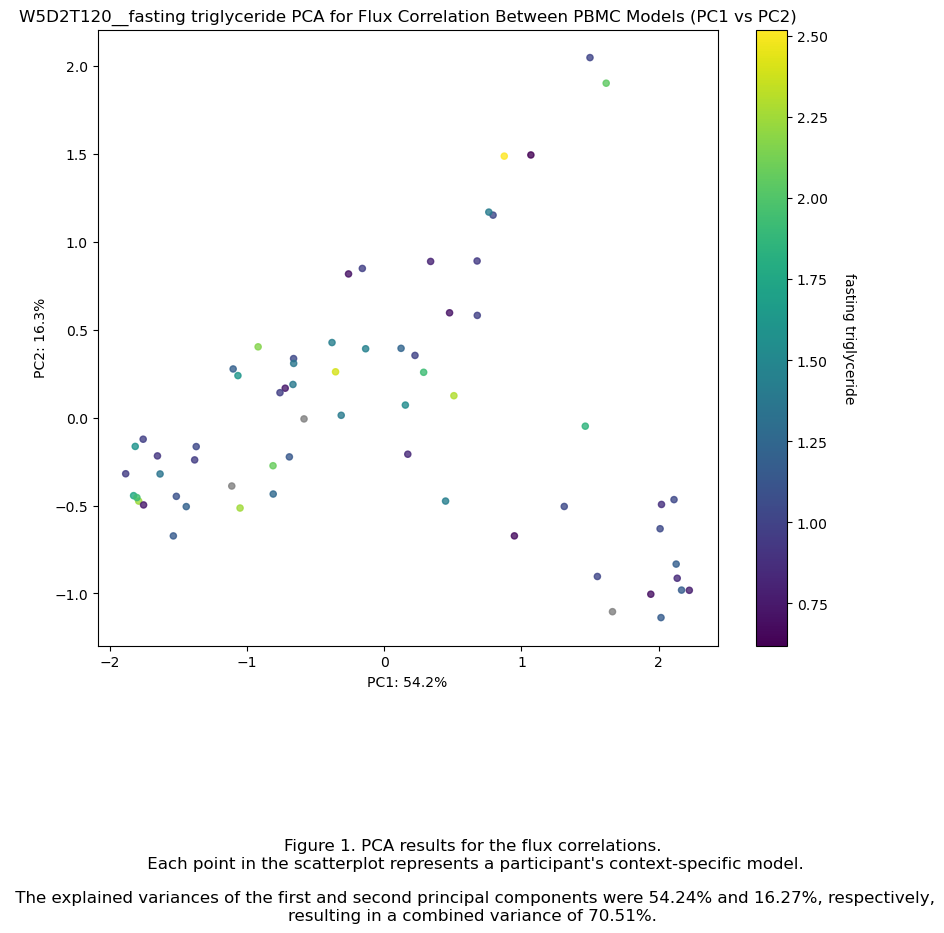

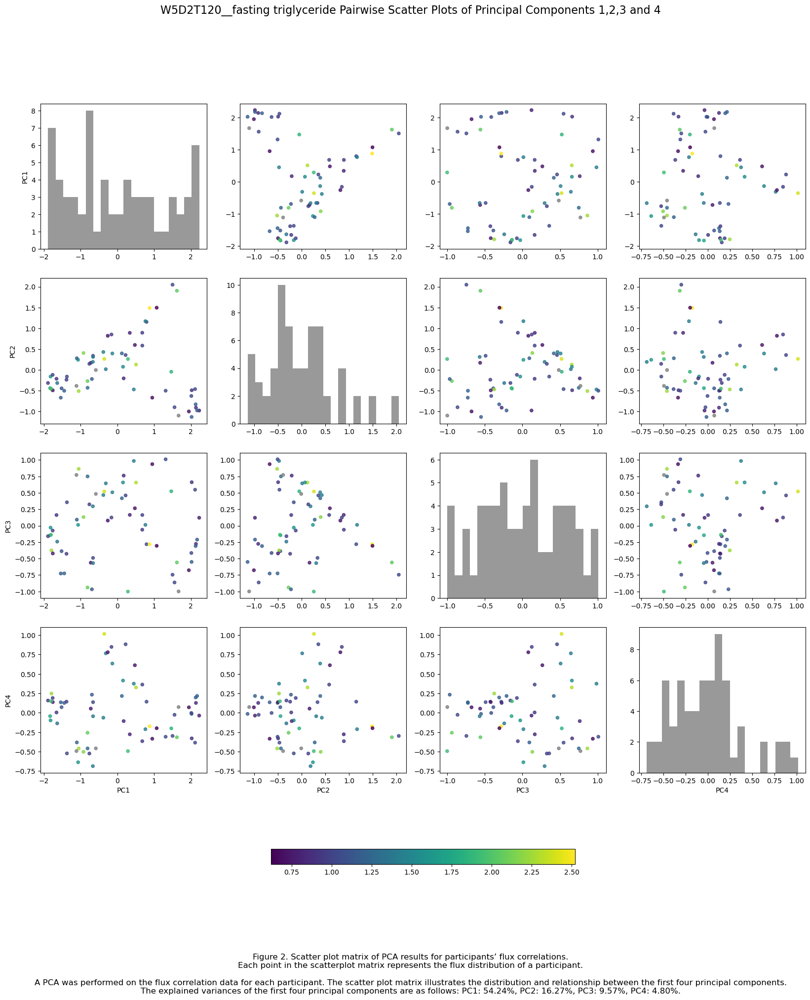

[0.54239113 0.16269086 0.09566434]


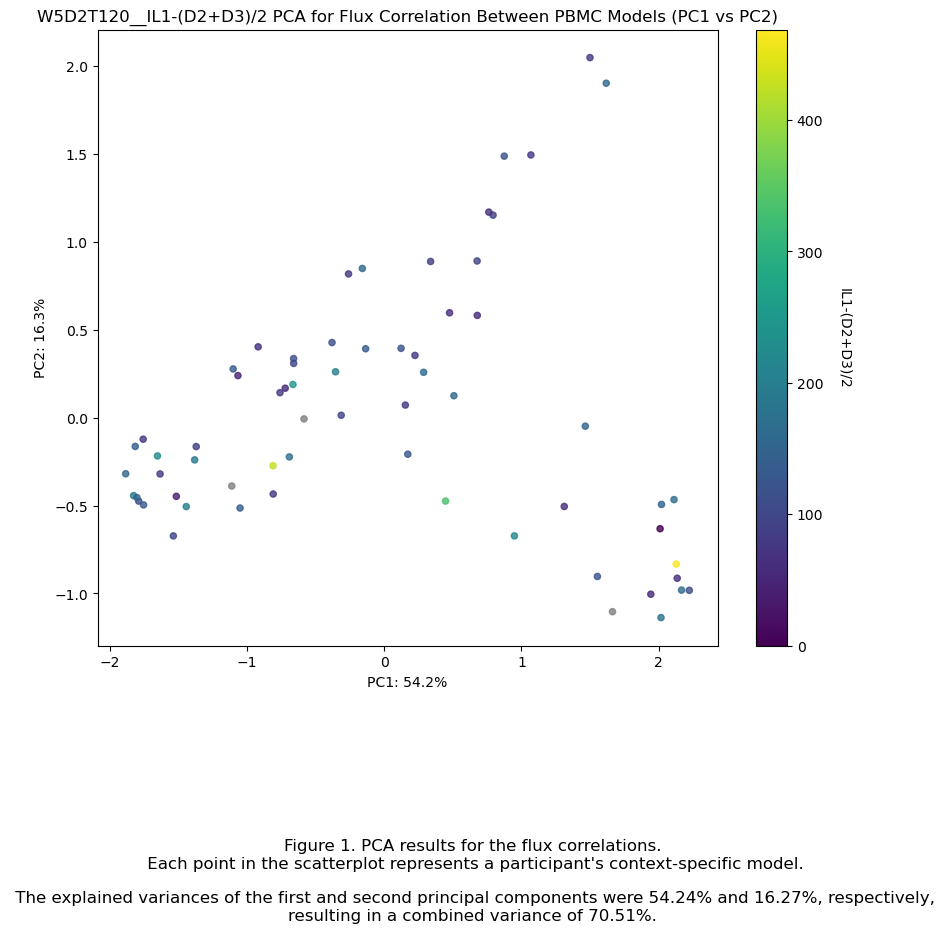

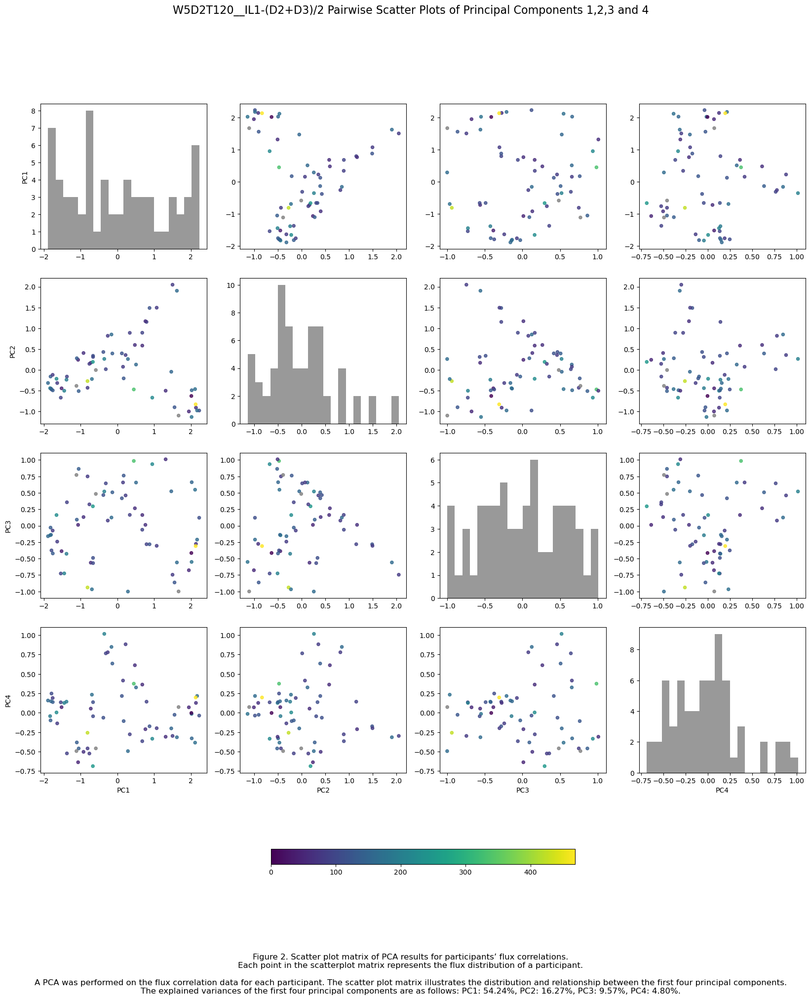

[0.54239113 0.16269086 0.09566434]


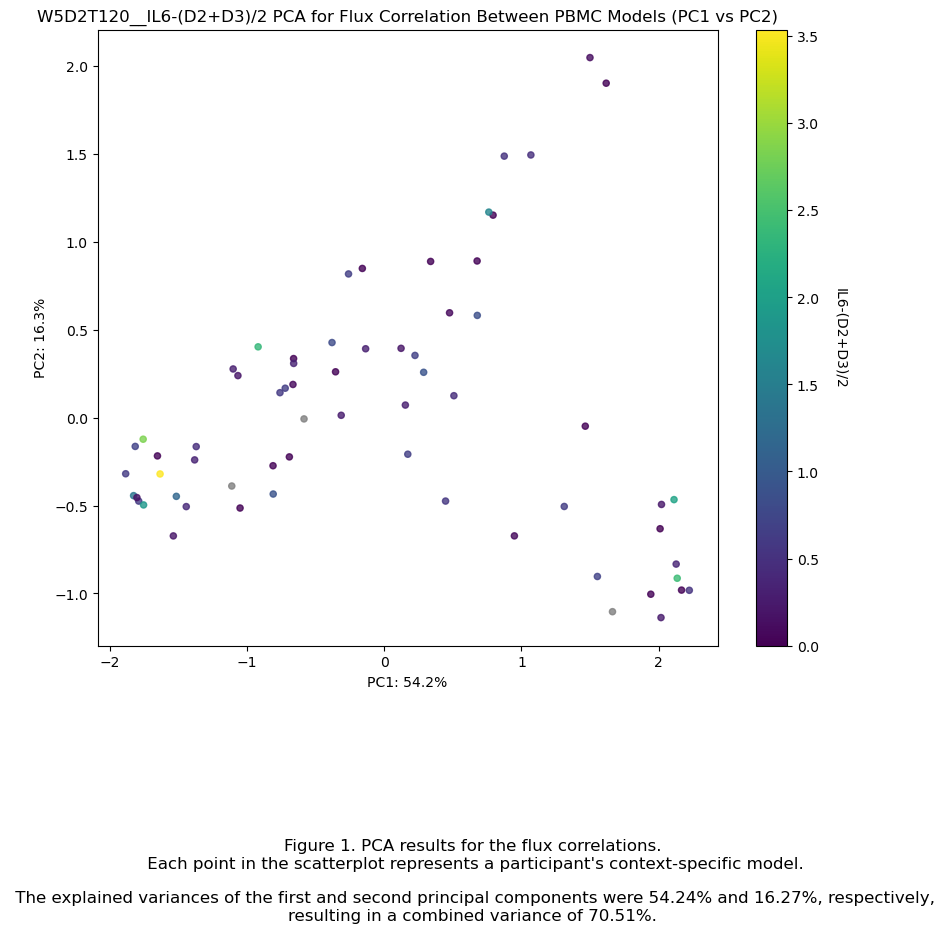

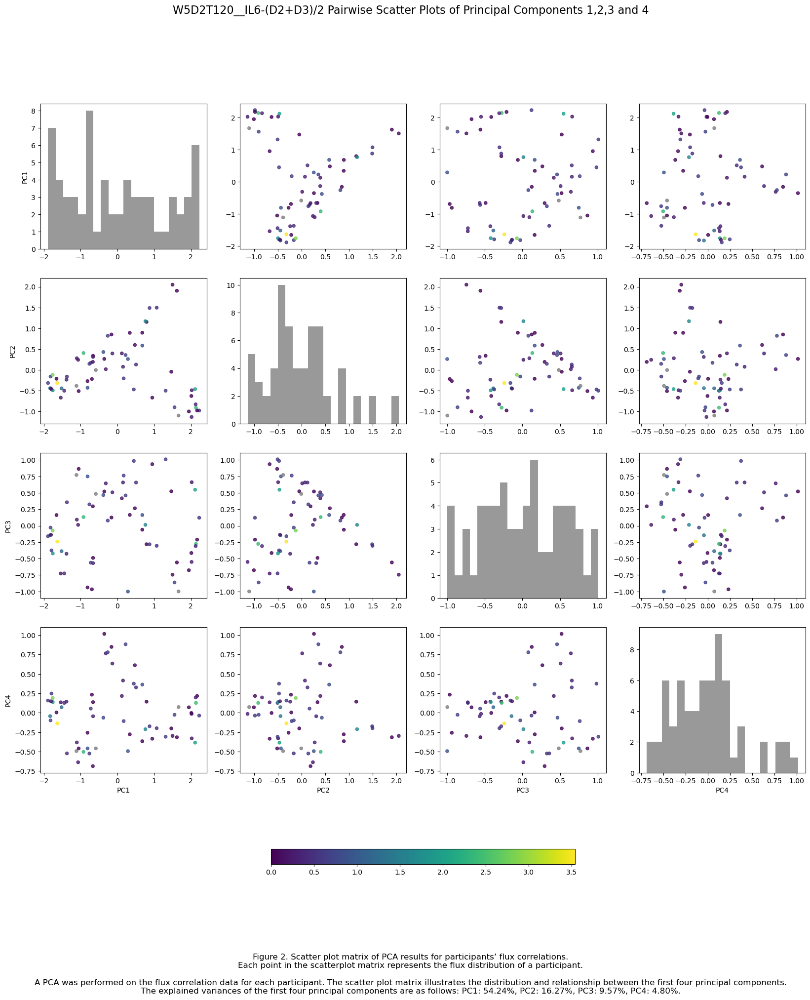

[0.54239113 0.16269086 0.09566434]


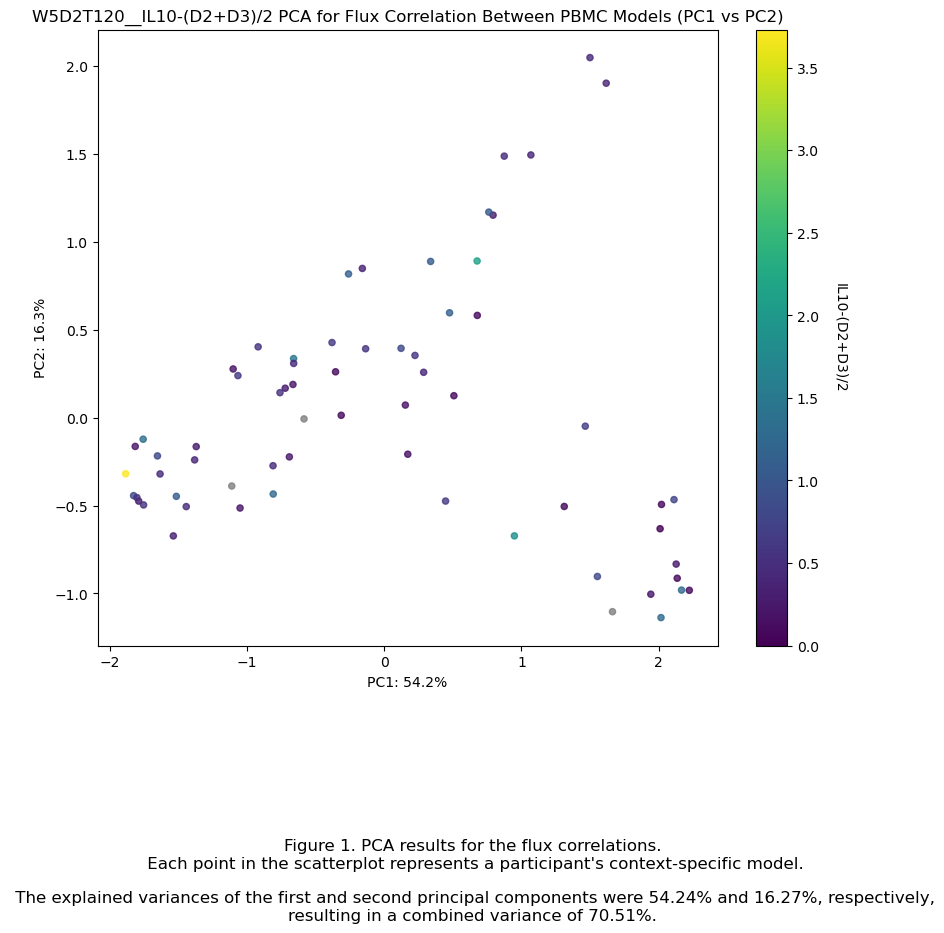

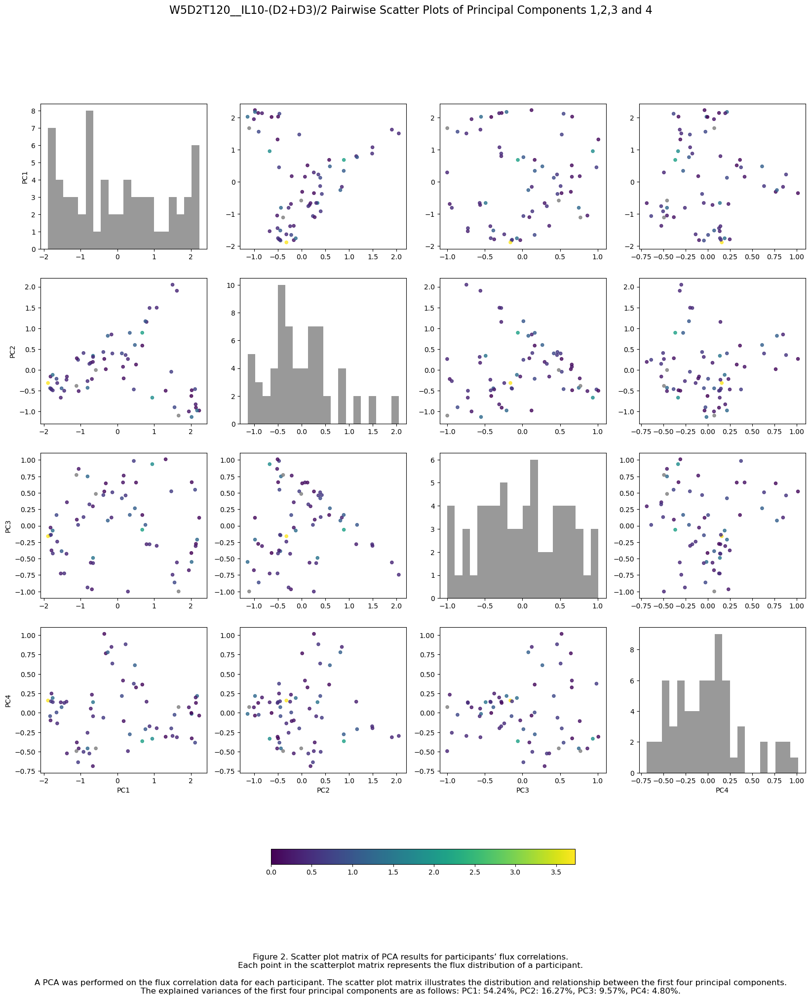

[0.54239113 0.16269086 0.09566434]


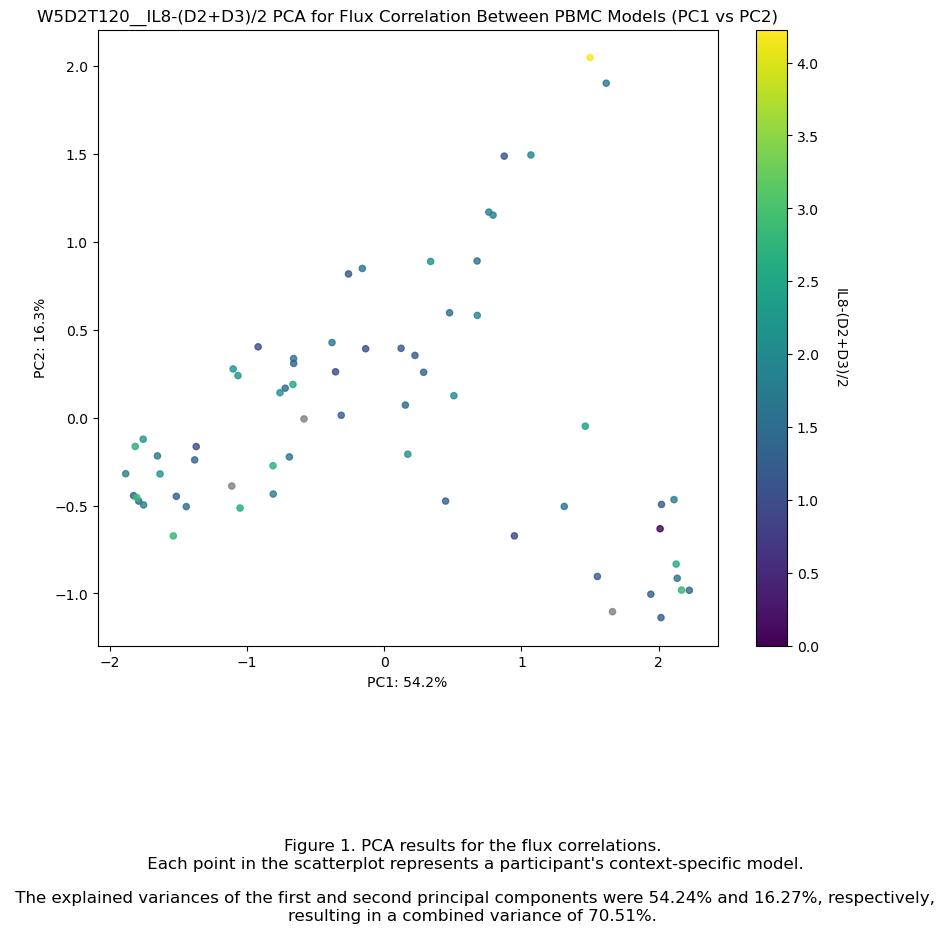

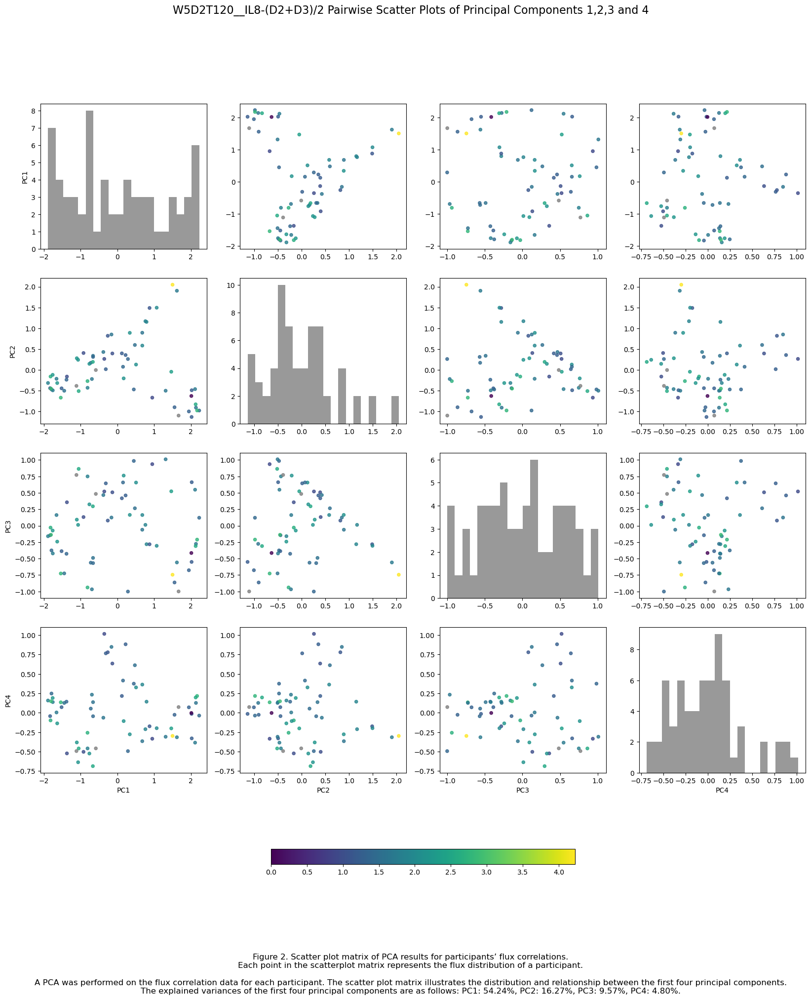

[0.54239113 0.16269086 0.09566434]


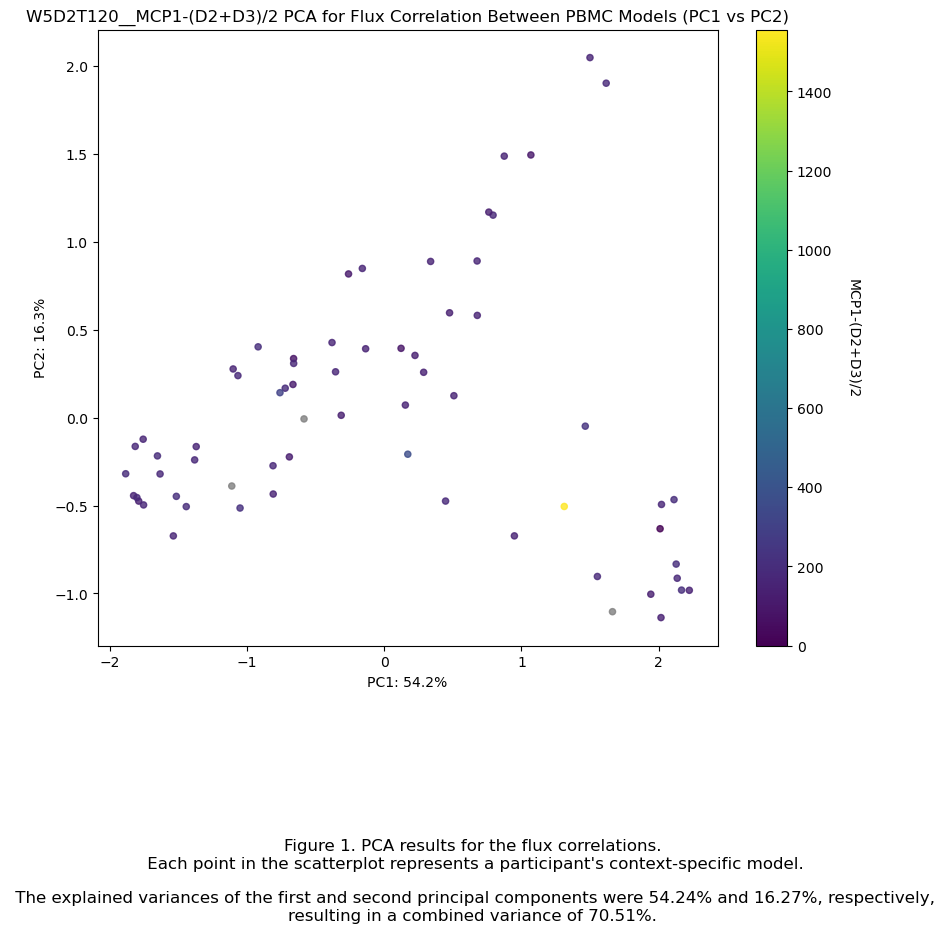

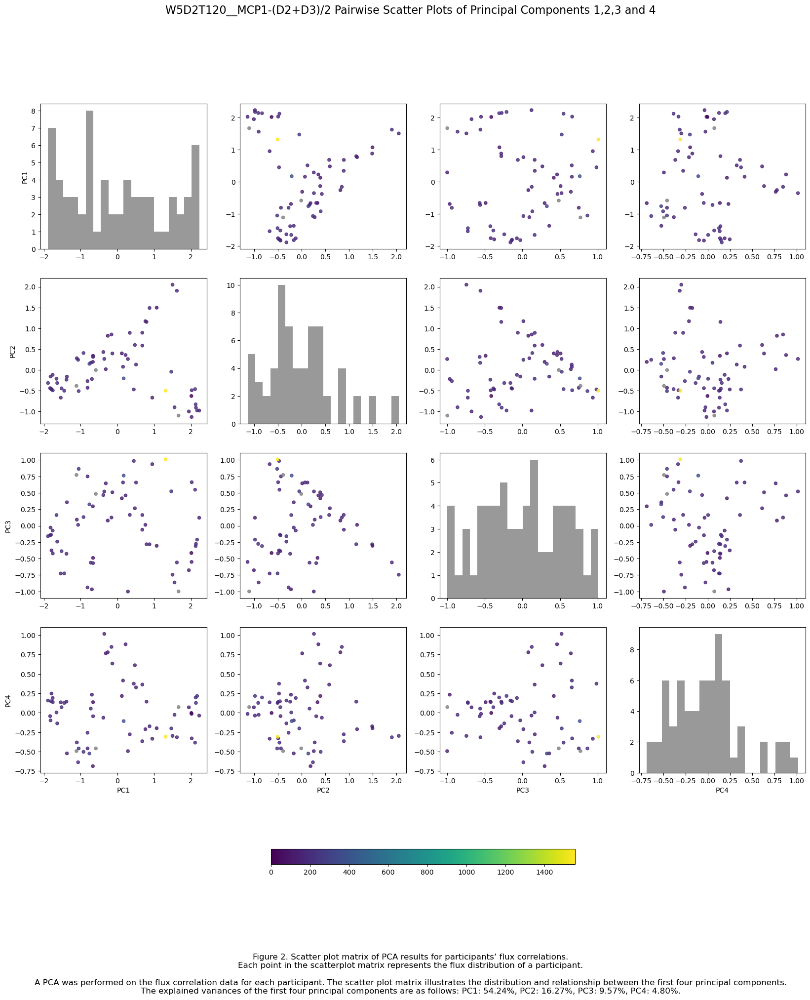

[0.54239113 0.16269086 0.09566434]


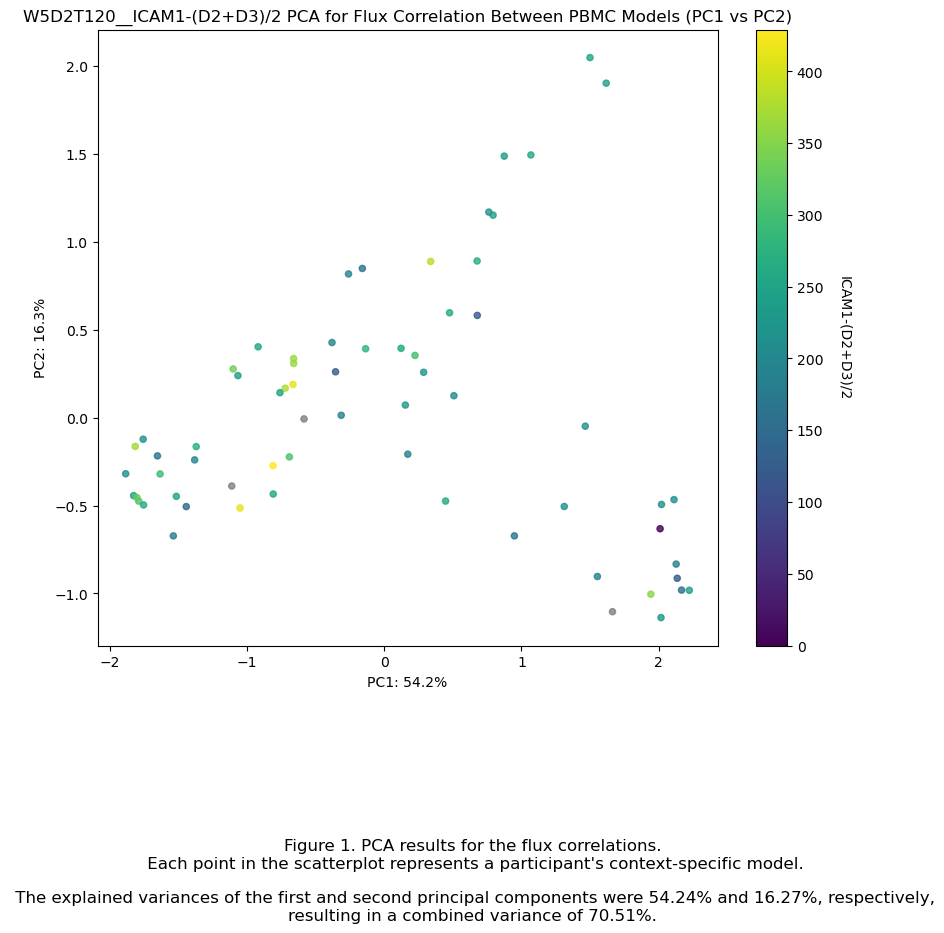

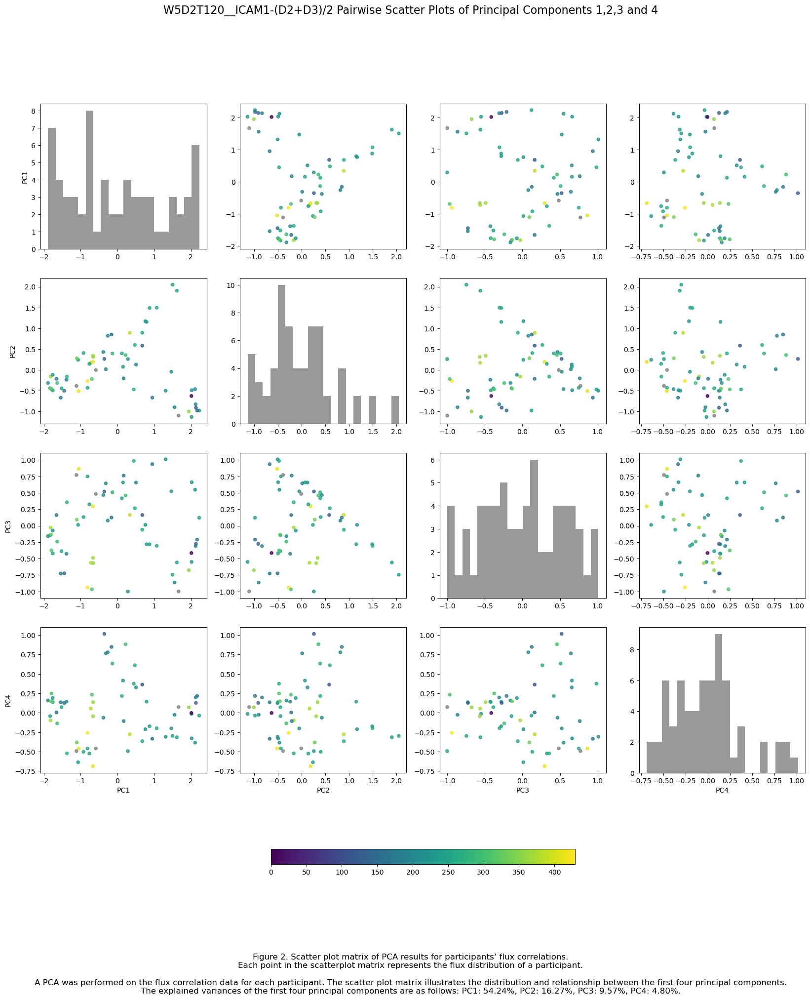

[0.54239113 0.16269086 0.09566434]


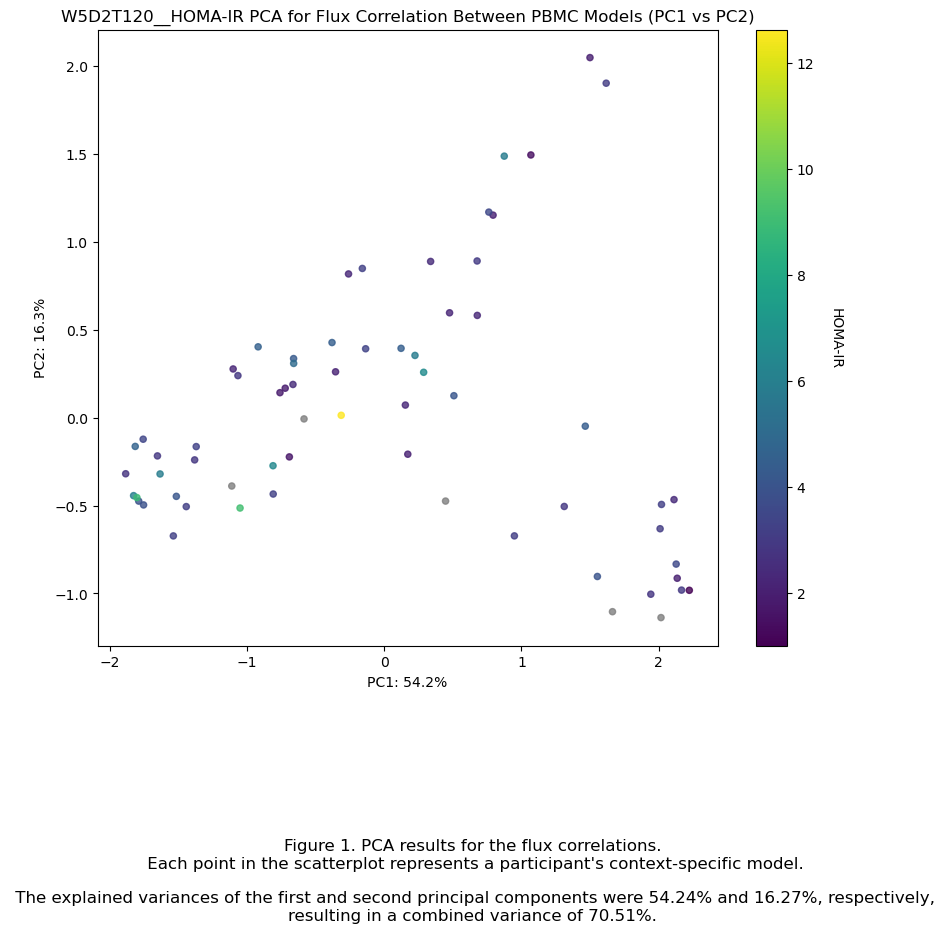

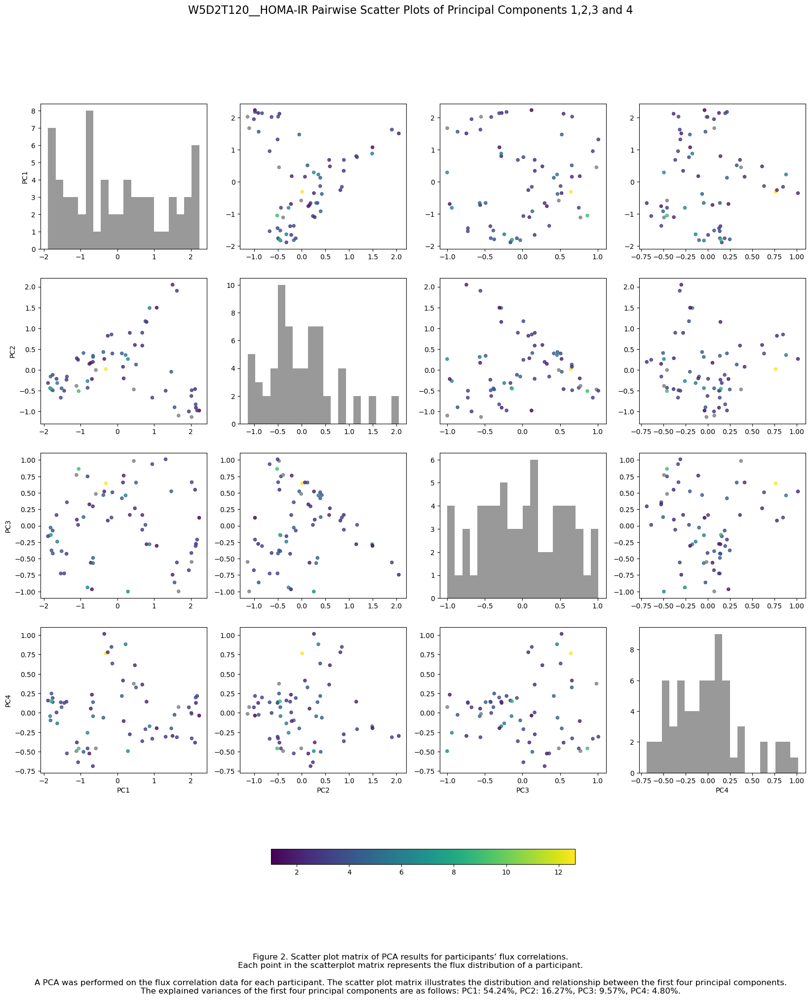

[0.54239113 0.16269086 0.09566434]


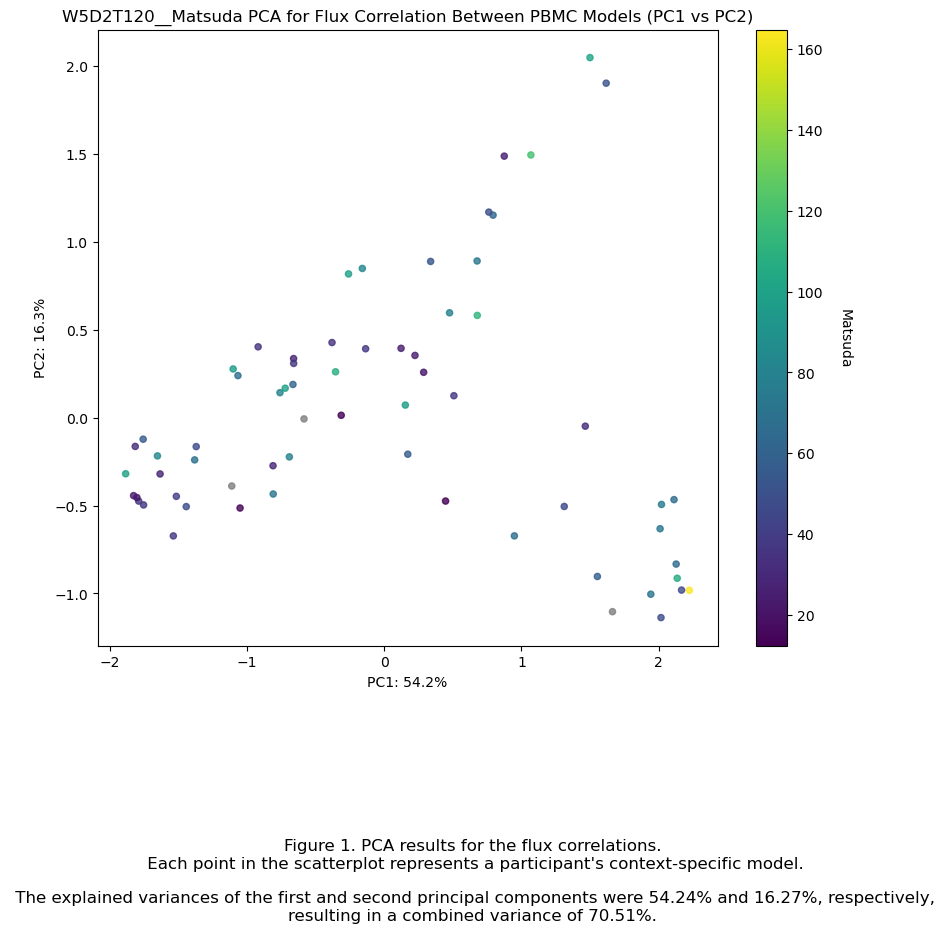

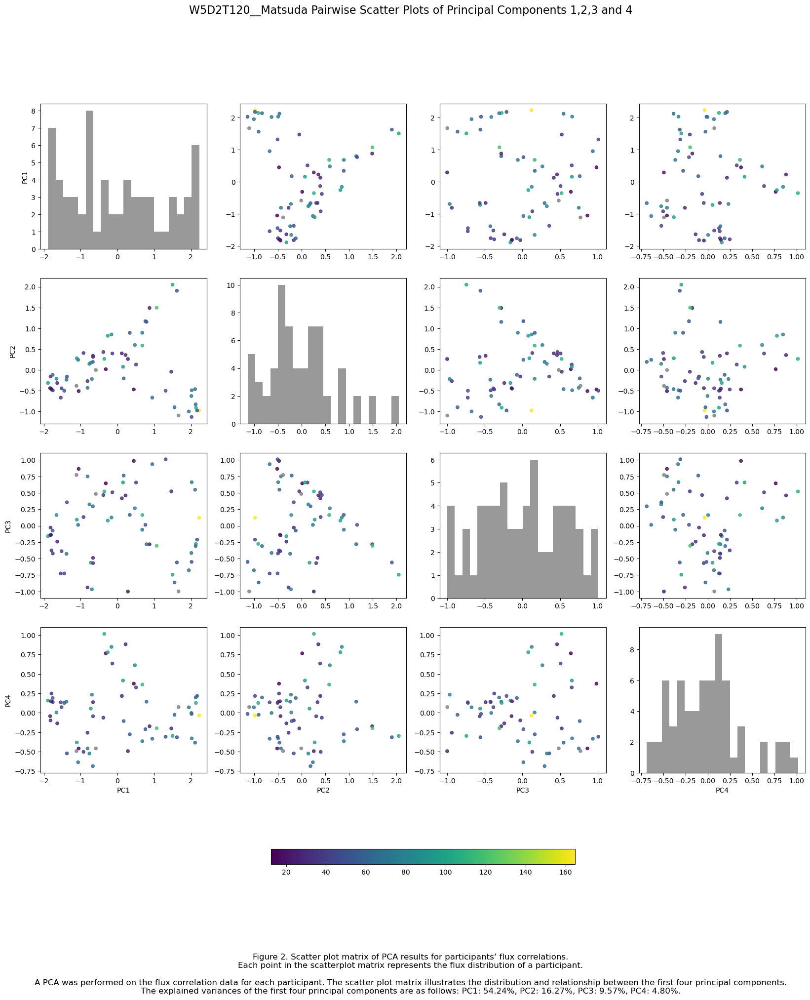

[0.54239113 0.16269086 0.09566434]


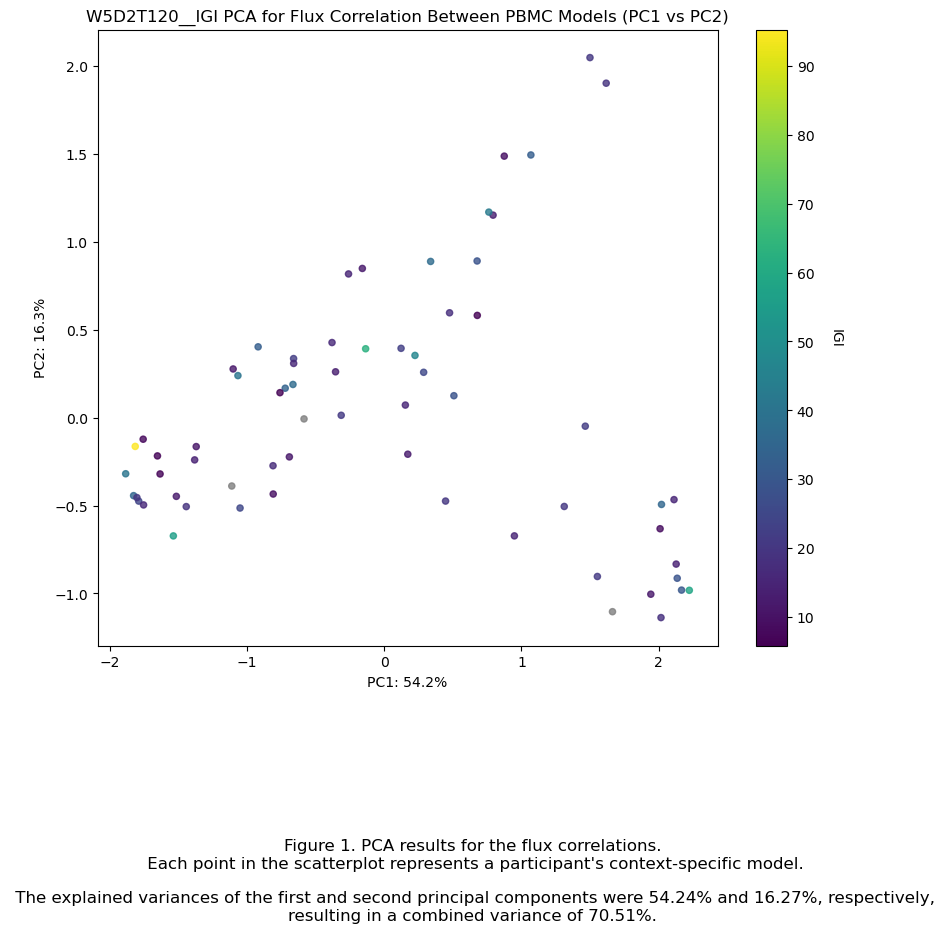

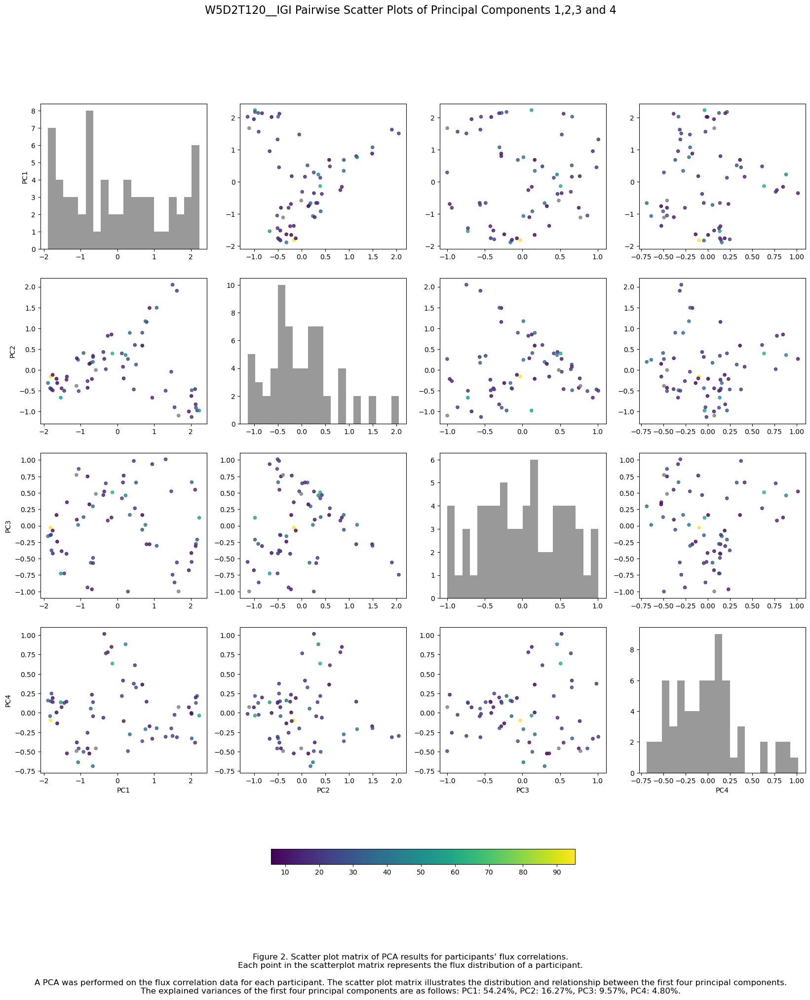

[0.54239113 0.16269086 0.09566434]


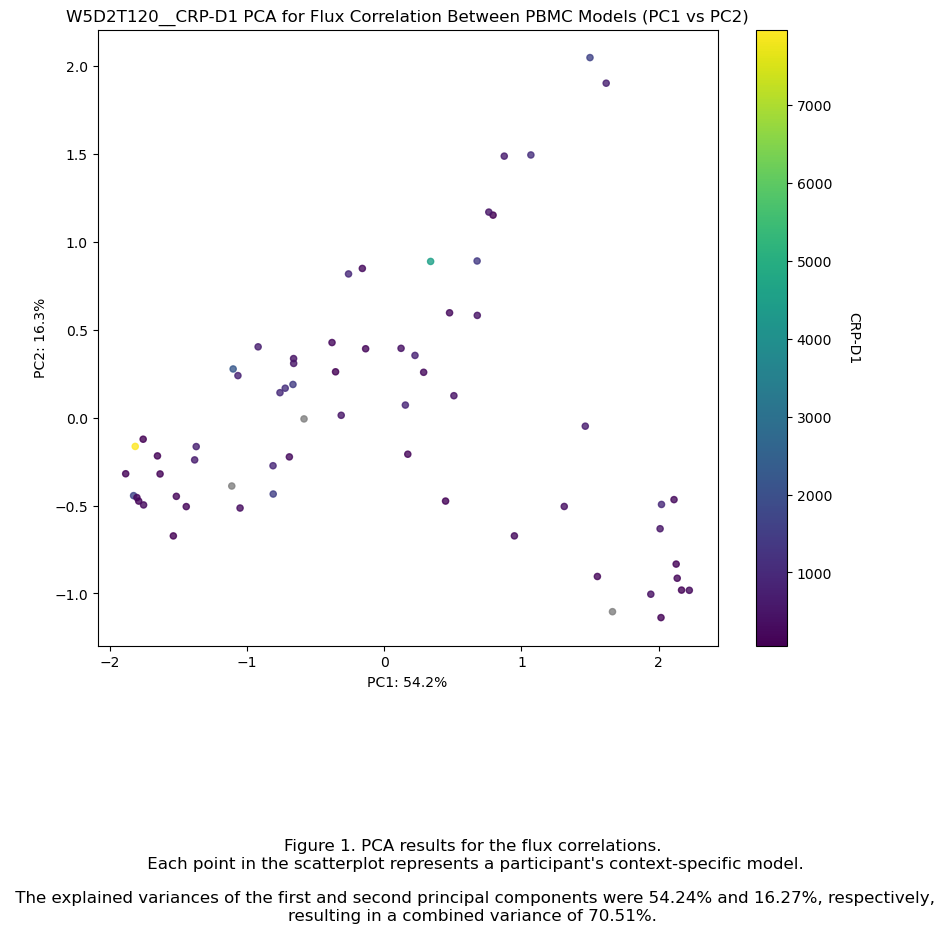

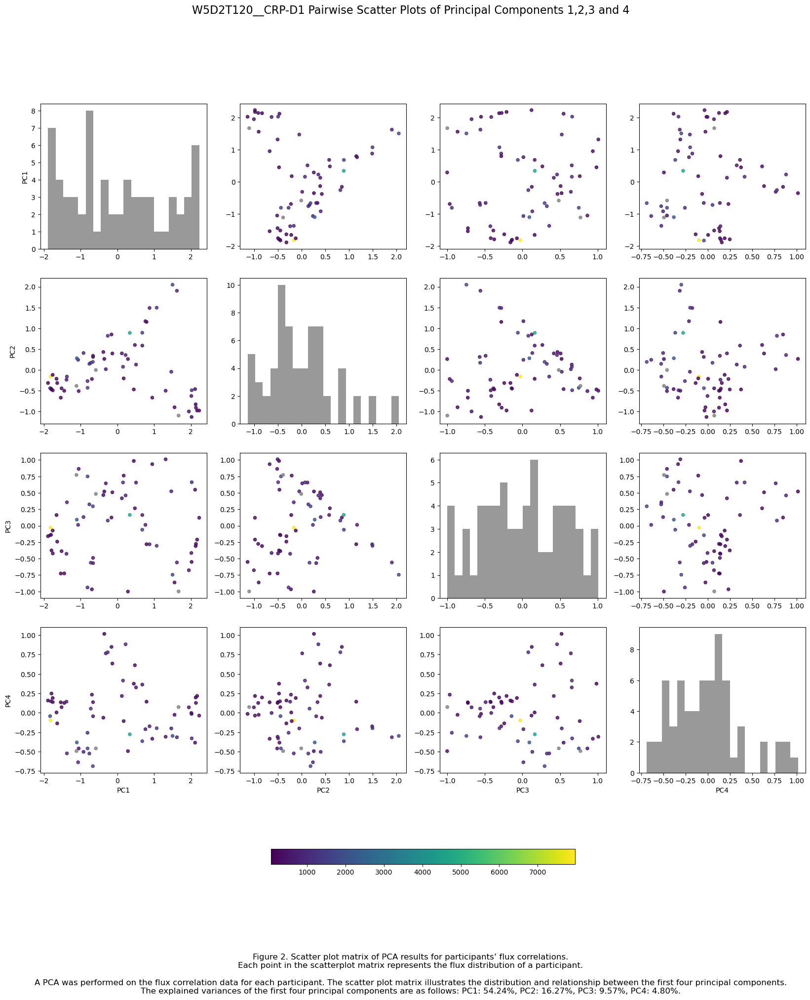

[0.54239113 0.16269086 0.09566434]


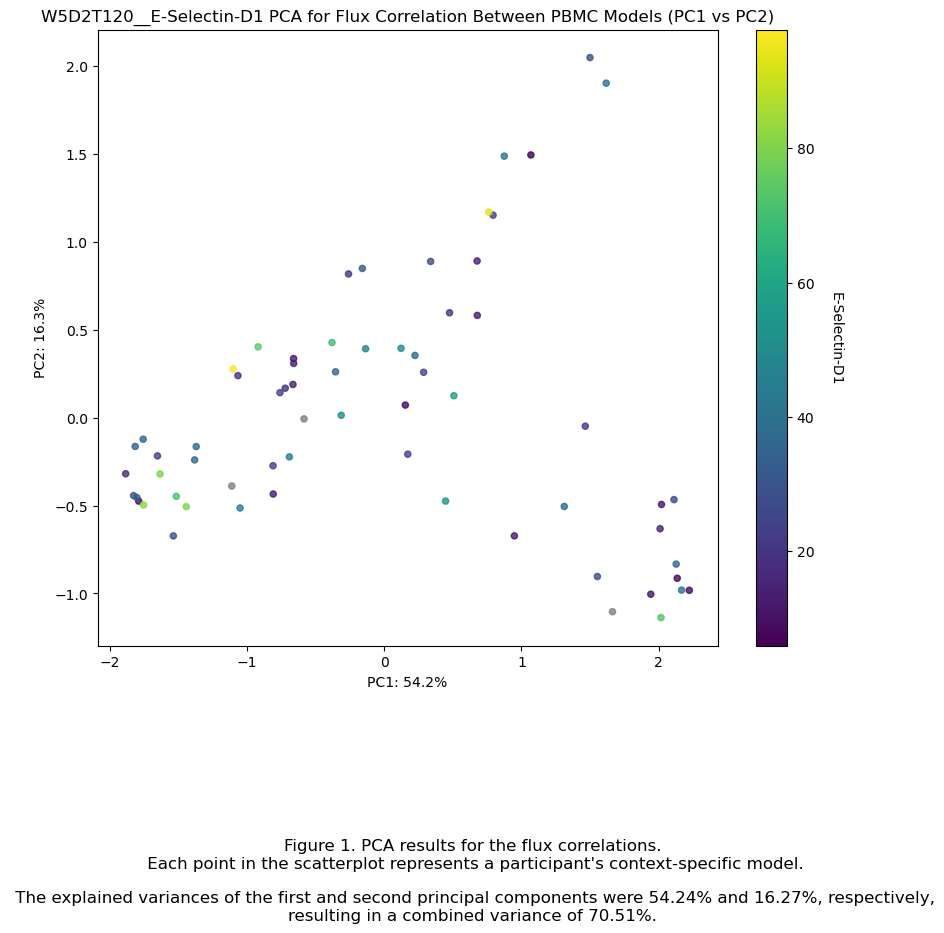

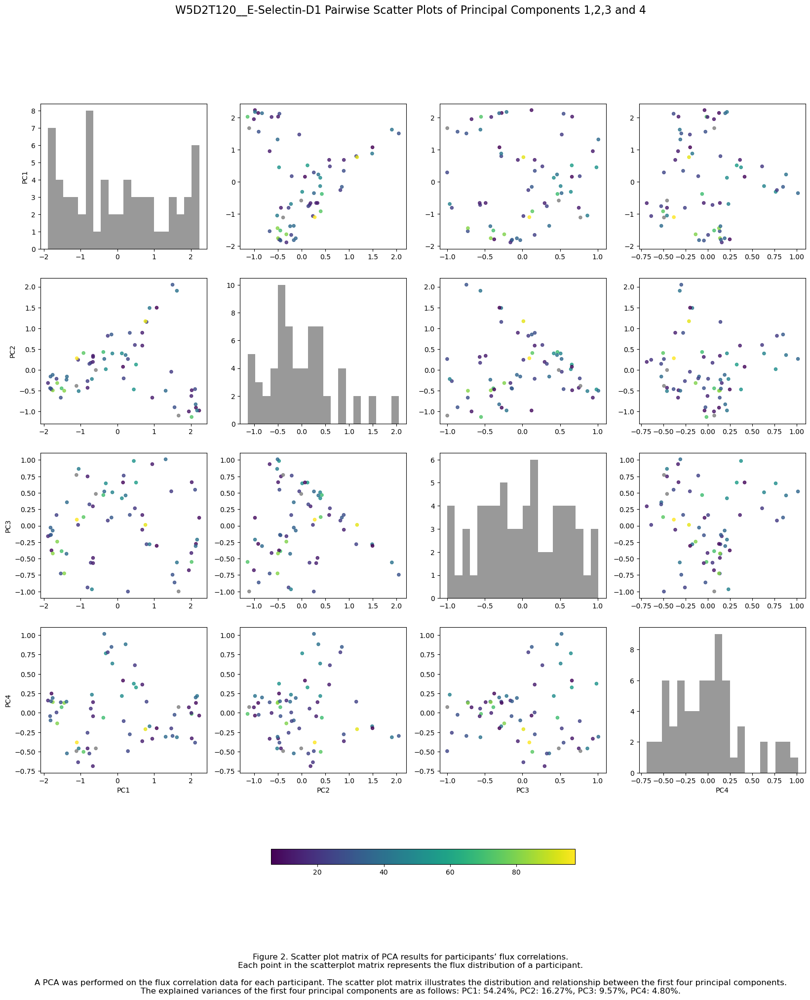

In [2]:
### with grey

import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D2T120_'
pw_flx1 = pd.read_csv('pw_flx2.csv')
columns_to_compare = ['Age', 'Body weight ', 'Body height ', 'BMI ', 'fasting glucose', '2hr glucose', 
                      'fasting insulin', 'fasting triglyceride', 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2', 
                      'MCP1-(D2+D3)/2', 'ICAM1-(D2+D3)/2', 'HOMA-IR', 'Matsuda', 'IGI', 'CRP-D1', 
                      'E-Selectin-D1', ]

# Load the entire Excel file
file_path = '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 12/NutriTech_otherdata_AVG.xlsx'
xls = pd.ExcelFile(file_path)

# Print the sheet names to see what sheets are available
print(xls.sheet_names)

# Load a sheet into a DataFrame by sheet name
df_week5_before = pd.read_excel(xls, sheet_name='week5_before_intervention', header=1)

# Extract the participant IDs from NutriTech data (assuming they are in 'name' column)
nutritech_ids = df_week5_before['name'].tolist()
# Extract the participant IDs from pw_flx1.csv column names
pw_flx1_ids = pw_flx1.columns.str.extract(r'(NT\d+)_')[0]

# Initialize lists to capture missing IDs and unmatched columns
missing_ids = []
unmatched_columns = pw_flx1.columns.tolist()

# Map the NutriTech IDs to the corresponding columns in pw_flx1.csv
mapping = {}
for nt_id in nutritech_ids:
    if nt_id in pw_flx1_ids.values:
        matched_column = pw_flx1.columns[pw_flx1_ids[pw_flx1_ids == nt_id].index[0]]
        mapping[nt_id] = matched_column
        unmatched_columns.remove(matched_column)
    else:
        missing_ids.append(nt_id)

# Print results
print("Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:")
print(mapping)

if missing_ids:
    print("\nWarning: The following NutriTech IDs were not found in pw_flx1.csv:")
    print(missing_ids)

if unmatched_columns:
    print("\nWarning: The following columns in pw_flx1.csv did not match any NutriTech IDs:")
    print(unmatched_columns)

for NT_data in columns_to_compare:
    # Extract corresponding labels (numeric values) for the columns in pw_flx1.csv based on the mapping
    pca_labels = []
    for column in pw_flx1.columns:
        matched_id = next((key for key, value in mapping.items() if value == column), None)
        if matched_id:
            label = df_week5_before.loc[df_week5_before['name'] == matched_id, NT_data].values[0]
            pca_labels.append(label)
        else:
            pca_labels.append(np.nan)  # Handle missing data

    # Perform PCA
    pca = PCA(n_components=3)
    pcaData = pca.fit_transform(pw_flx1.T)  # Transpose to make samples as rows
    print(pca.explained_variance_ratio_)

    # Convert pca_labels to a numpy array for easier handling
    pca_labels = np.array(pca_labels)

    # Normalize pca_labels for color mapping
    norm = plt.Normalize(vmin=np.nanmin(pca_labels), vmax=np.nanmax(pca_labels))
    cmap = plt.cm.viridis  # You can choose any colormap

    # Define a color array: use cmap for valid data and grey for NaN
    colors = np.array([cmap(norm(val)) if not np.isnan(val) else (0.5, 0.5, 0.5, 1.0) for val in pca_labels])

    title_font = {
        'weight': 'medium',
        'size': 12,
    }
    axis_font = {
        'weight': 'normal',
        'size': 10,
    }

    # Plot PCA scatter plot with color gradient
    fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
    sc = plt.scatter(pcaData[:, 0], pcaData[:, 1], s=20, marker='o', color=colors, alpha=0.8)

    # Add color bar for non-NaN values only
    valid_sc = plt.scatter([], [], c=[], cmap=cmap, norm=norm)
    cbar = plt.colorbar(valid_sc)
    cbar.set_label(f'{NT_data}', rotation=270, labelpad=20)

    plt.title(f'{file_ID}_{NT_data} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', title_font)
    plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), axis_font)
    plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), axis_font)
    plt.figtext(0.5, -0.23, (f'Figure 1. PCA results for the flux correlations.\n Each point in the scatterplot represents a participant\'s context-specific model.\n\n The explained variances of the first and second principal components were {pca.explained_variance_ratio_[0]*100:.2f}% and {pca.explained_variance_ratio_[1]*100:.2f}%, respectively, resulting in a combined variance of {((pca.explained_variance_ratio_[0]*100)+(pca.explained_variance_ratio_[1]*100)):.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)
    #plt.savefig(f'{file_ID}fig.1_{NT_data}_PCA_for_Flux_Correlation.png', dpi=1000)

    ####################### Create a 4x4 plot matrix of PC1, PC2, PC3, and PC4
    # Perform PCA
    pca = PCA(n_components=4)
    pcaData = pca.fit_transform(pw_flx1.T)
    explained_variance = pca.explained_variance_ratio_

    fig, axs = plt.subplots(4, 4, figsize=(20, 20))

    pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
    components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

    for i in range(4):
        for j in range(4):
            if i == j:
                axs[i, j].hist(components[i], bins=20, color='gray', alpha=0.8)  # Histogram does not need color mapping
            else:
                sc = axs[i, j].scatter(components[j], components[i], color=colors, s=20, alpha=0.8)
            if i == 3:
                axs[i, j].set_xlabel(pc_labels[j])
            if j == 0:
                axs[i, j].set_ylabel(pc_labels[i])

    # Add a shared color bar
    fig.colorbar(valid_sc, ax=axs, orientation='horizontal', fraction=0.02, pad=0.1)

    plt.suptitle(f'{file_ID}_{NT_data} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
    plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                             f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                             f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                             f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

    #plt.savefig(f'{file_ID}fig.2_{NT_data}_Pairwise_Scatter_Plots_of_PC1_to_PC4.png', dpi=1000)
    plt.show()


# W5D2T*, code from docs, FBA = true

[0.50501586 0.22732293 0.13261931]


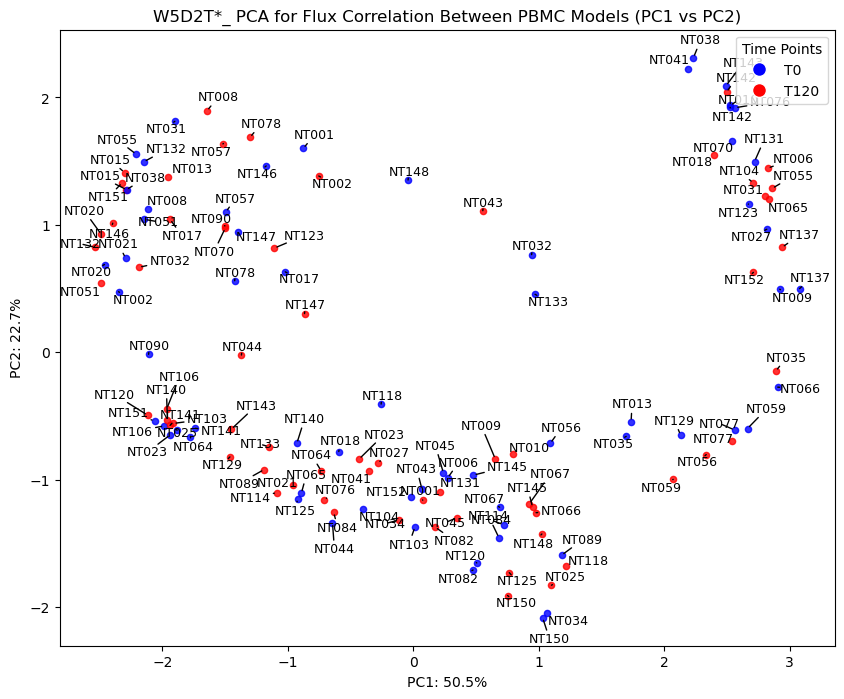

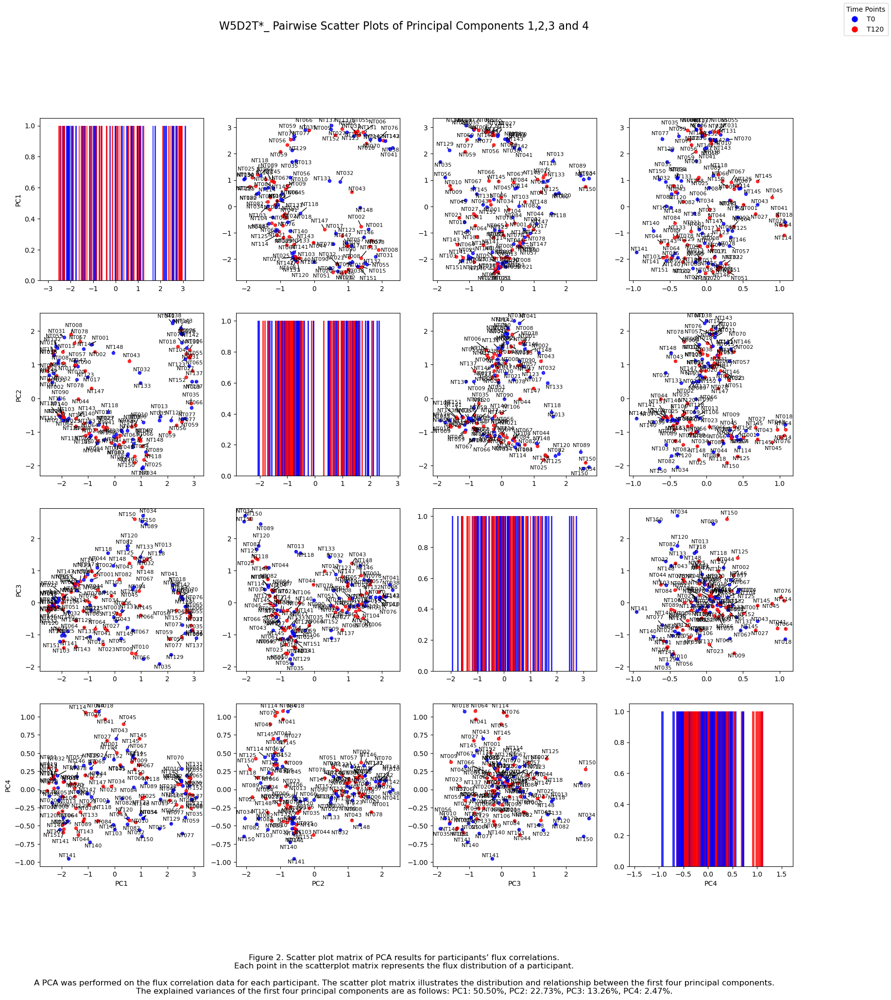

In [1]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Load your pw_flx3 data from the CSV file
pw_flxload = pd.read_csv('pw_flx3.csv')

# Extract sample labels (T0 or T120) from the column names
labels = [col.split('T')[-1] for col in pw_flxload.columns]

# Extract NT numbers from column names
nt_numbers = [col.split('/')[-1].split('_')[0] for col in pw_flxload.columns]

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D2T*_'

# Perform PCA
pca = PCA(n_components=3)
pcaData = pca.fit_transform(pw_flxload.T)  # Transpose to make samples as rows
print(pca.explained_variance_ratio_)

# Color coding based on time points
colors = ['blue' if label == '0' else 'red' for label in labels]

# Plot PCA scatter plot
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
texts = []
for i in range(len(labels)):
    xs = pcaData[i, 0]
    ys = pcaData[i, 1]
    plt.scatter(xs, ys, s=20, marker='o', color=colors[i], alpha=0.8)
    texts.append(plt.text(xs, ys, nt_numbers[i], fontsize=9, ha='center', color='black'))

# Adjust text to avoid overlap
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'))

# Add legend and labels
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='T0'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='T120')]
plt.legend(handles=handles, title="Time Points")

plt.title(f'{file_ID} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', fontsize=12)
plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), fontsize=10)
plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), fontsize=10)
plt.show()

# Perform PCA
pca = PCA(n_components=4)
pcaData = pca.fit_transform(pw_flxload.T)
explained_variance = pca.explained_variance_ratio_

fig, axs = plt.subplots(4, 4, figsize=(20, 20))

pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

# Annotate points with NT numbers and adjust text positions
for i in range(4):
    for j in range(4):
        if i == j:
            for k, c in zip(components[i], colors):
                axs[i, j].hist(k, bins=20, color=c, alpha=0.8)
        else:
            texts = []
            for x, y, c, nt_number in zip(components[j], components[i], colors, nt_numbers):
                axs[i, j].scatter(x, y, color=c, s=20, alpha=0.8)
                texts.append(axs[i, j].text(x, y, nt_number, fontsize=8, ha='center', color='black'))
            adjust_text(texts, ax=axs[i, j], arrowprops=dict(arrowstyle='-', color='black'))  # Adjust text

        if i == 3:
            axs[i, j].set_xlabel(pc_labels[j])
        if j == 0:
            axs[i, j].set_ylabel(pc_labels[i])

# Add a legend
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='T0'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='T120')]
fig.legend(handles=handles, title="Time Points", loc='upper right')

plt.suptitle(f'{file_ID} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                         f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                         f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                         f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

#plt.savefig(f'{file_ID}fig.2_Pairwise_Scatter_Plots_of_PC1_to_PC4.png', dpi=1000)
plt.show()


# W5D3T120, code from docs, FBA = true

['week5_before_intervention', 'week13_after_intervention']
Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:
{'NT001': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D3T120/NT001_W5D3T120', 'NT002': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D3T120/NT002_W5D3T120', 'NT006': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 11, Get FBA working or Sampling,/W5D3T120/NT006_W5D3T120', 'NT008': '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork

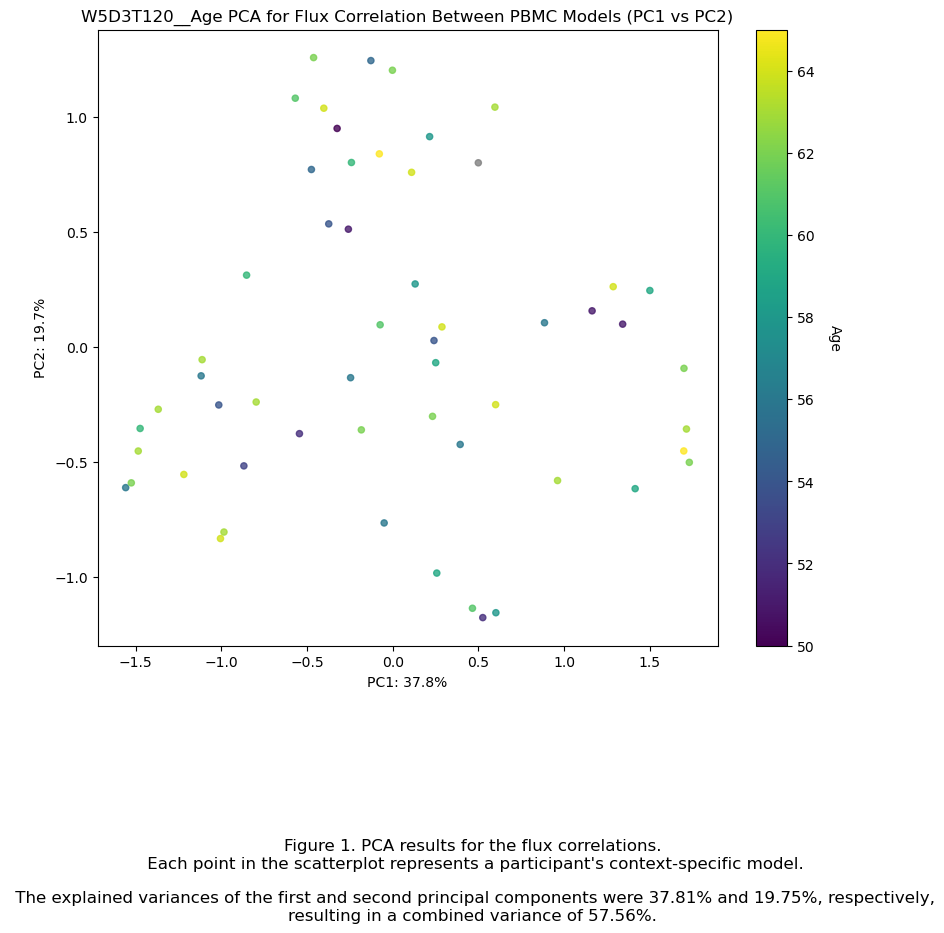

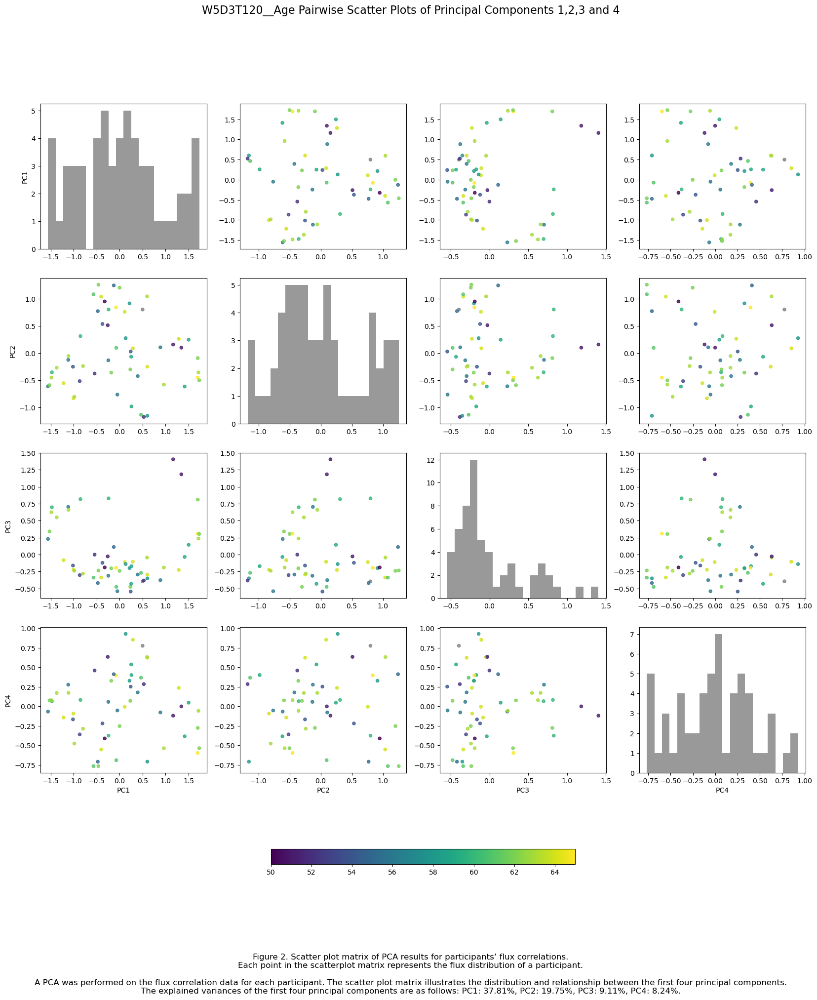

[0.378123   0.19748016 0.09114667]


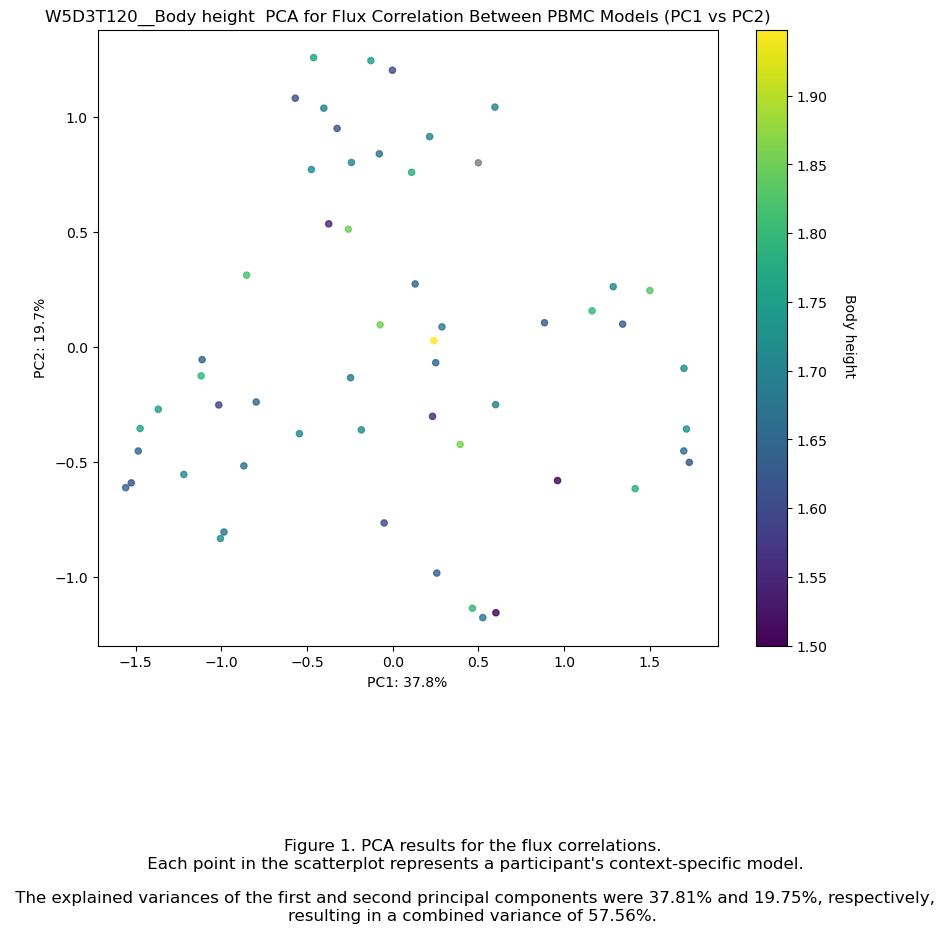

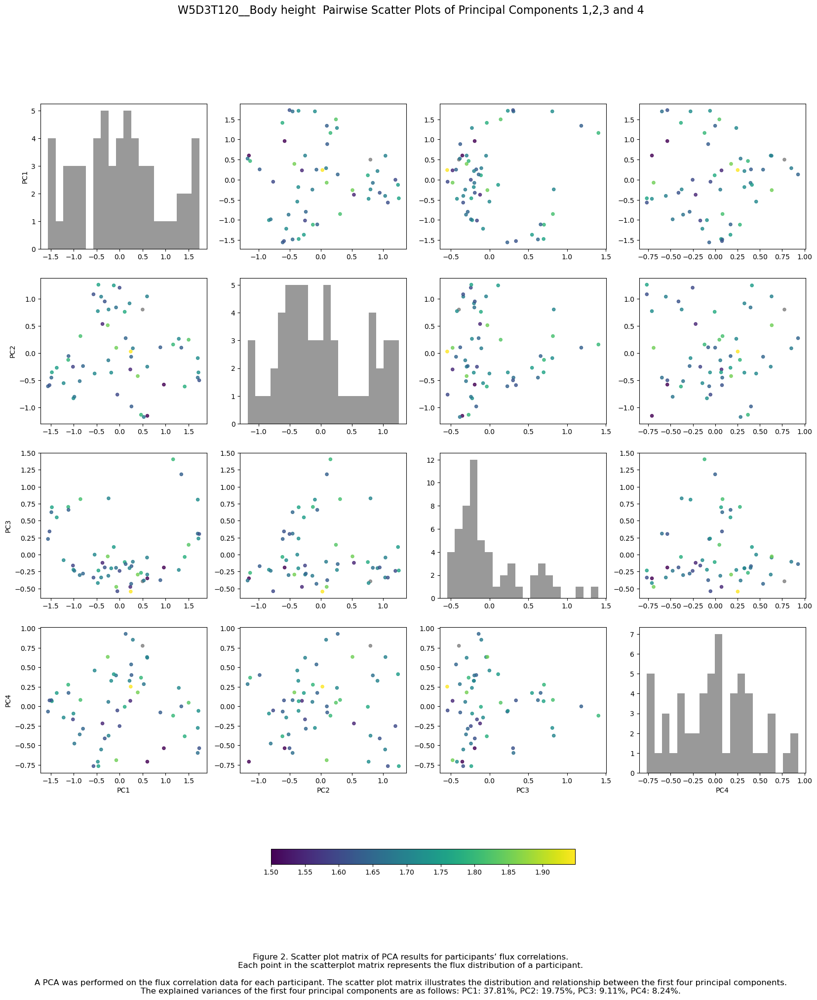

[0.378123   0.19748016 0.09114667]


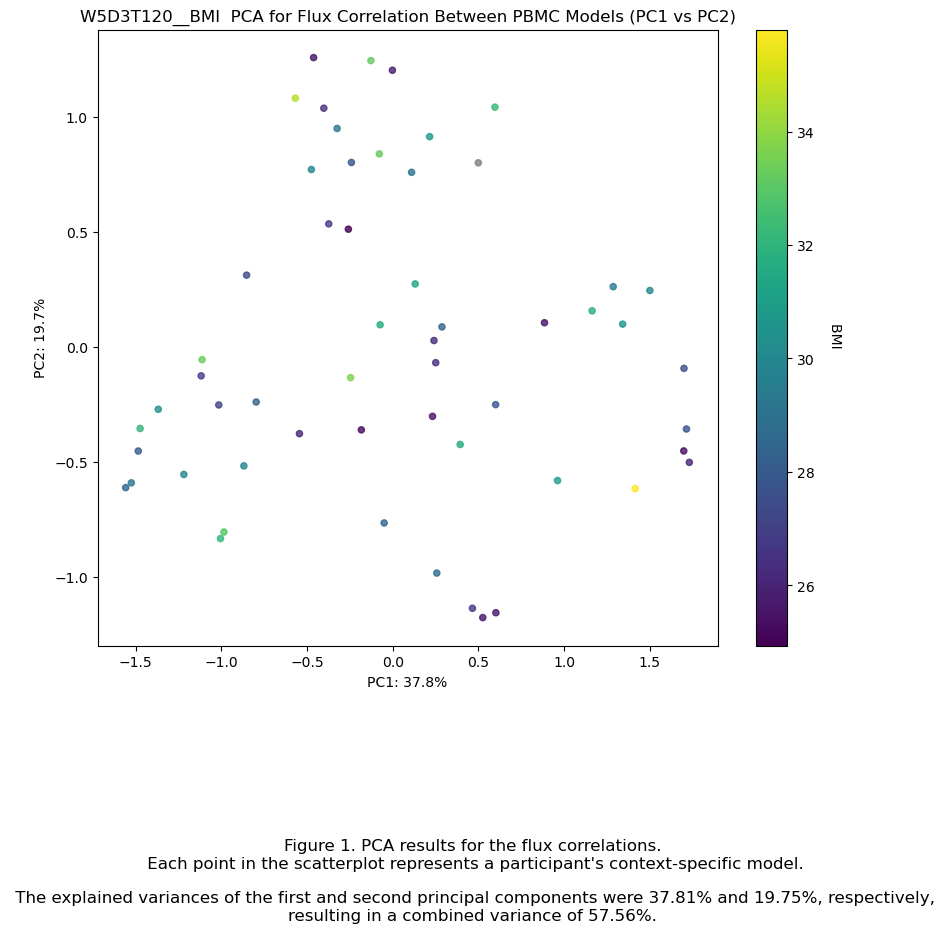

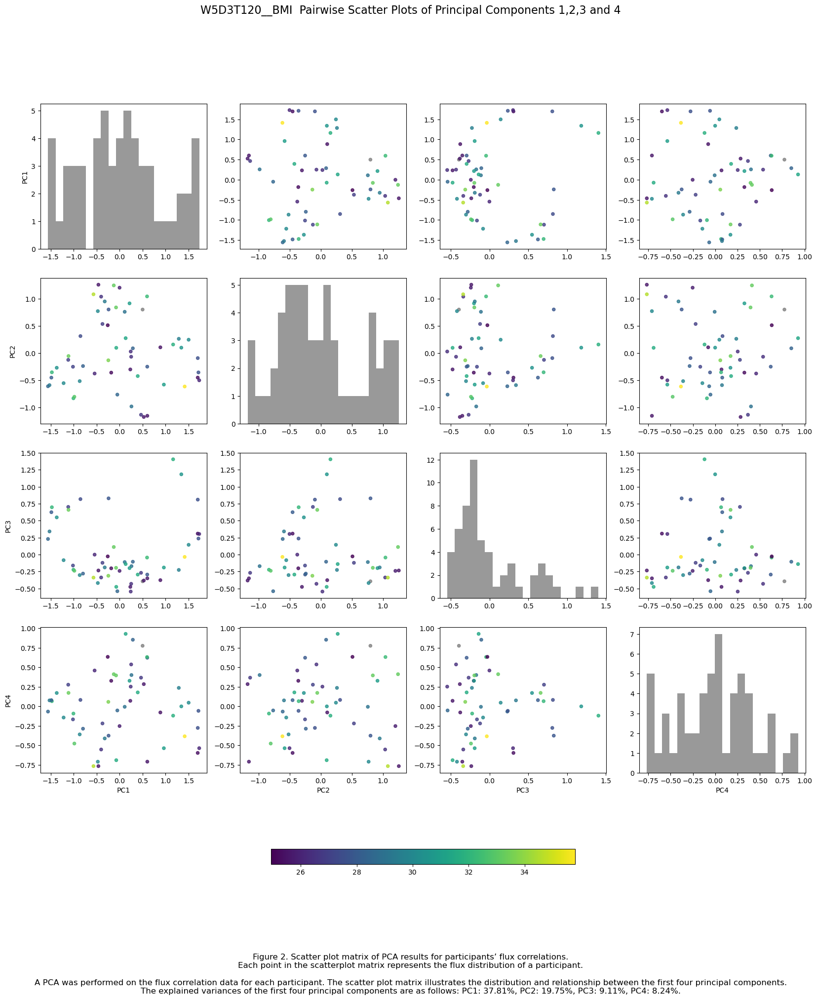

[0.378123   0.19748016 0.09114667]


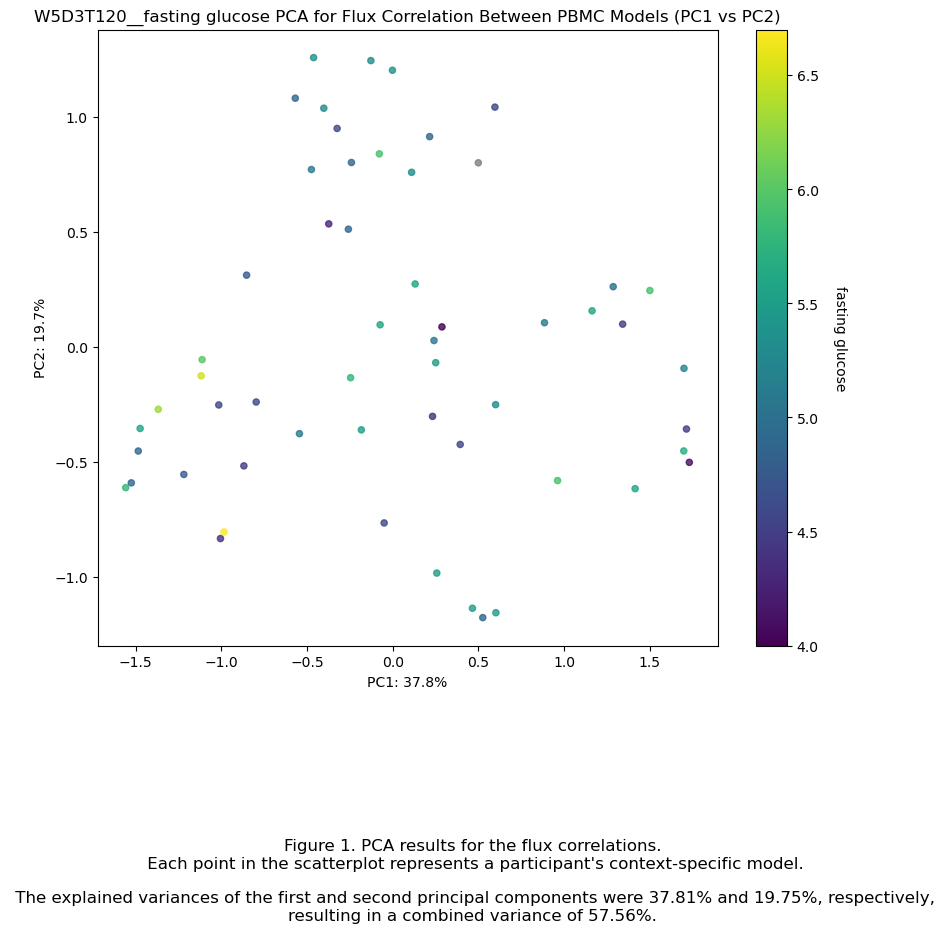

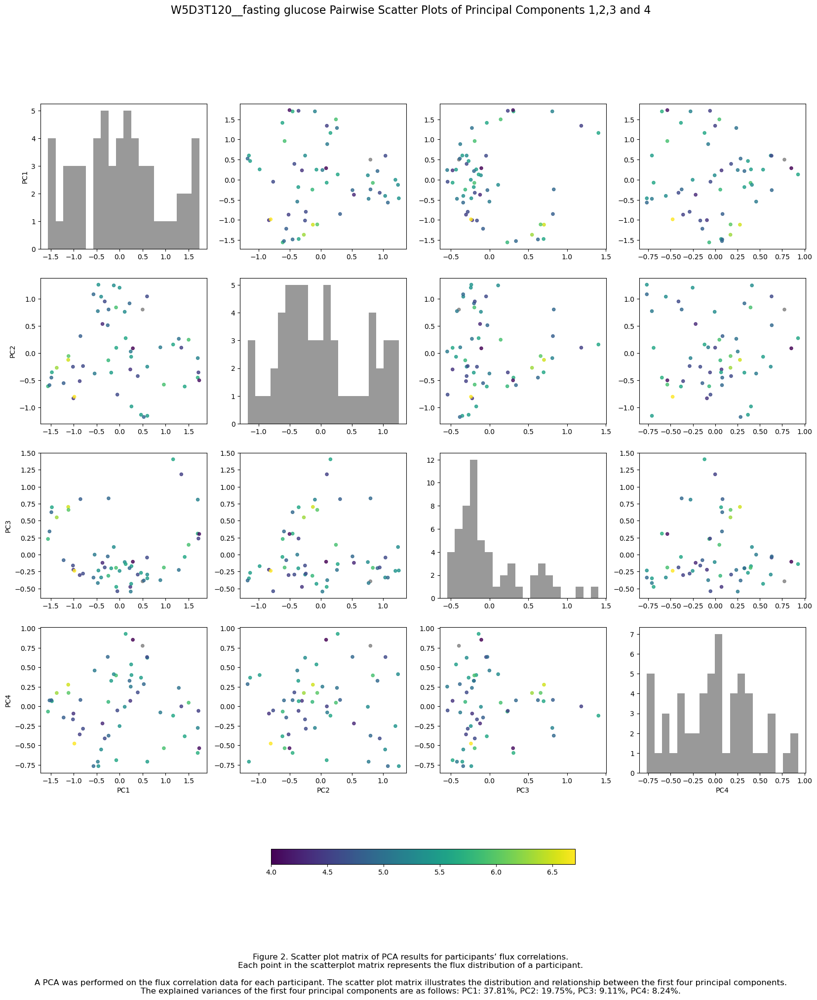

[0.378123   0.19748016 0.09114667]


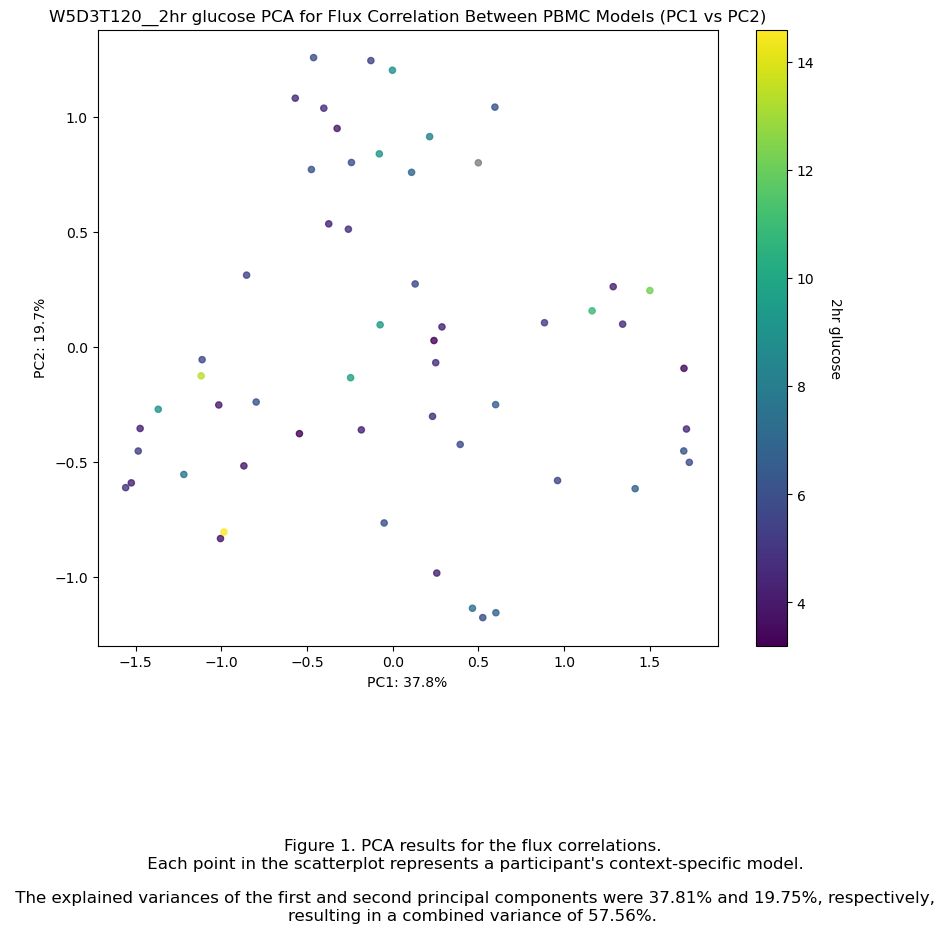

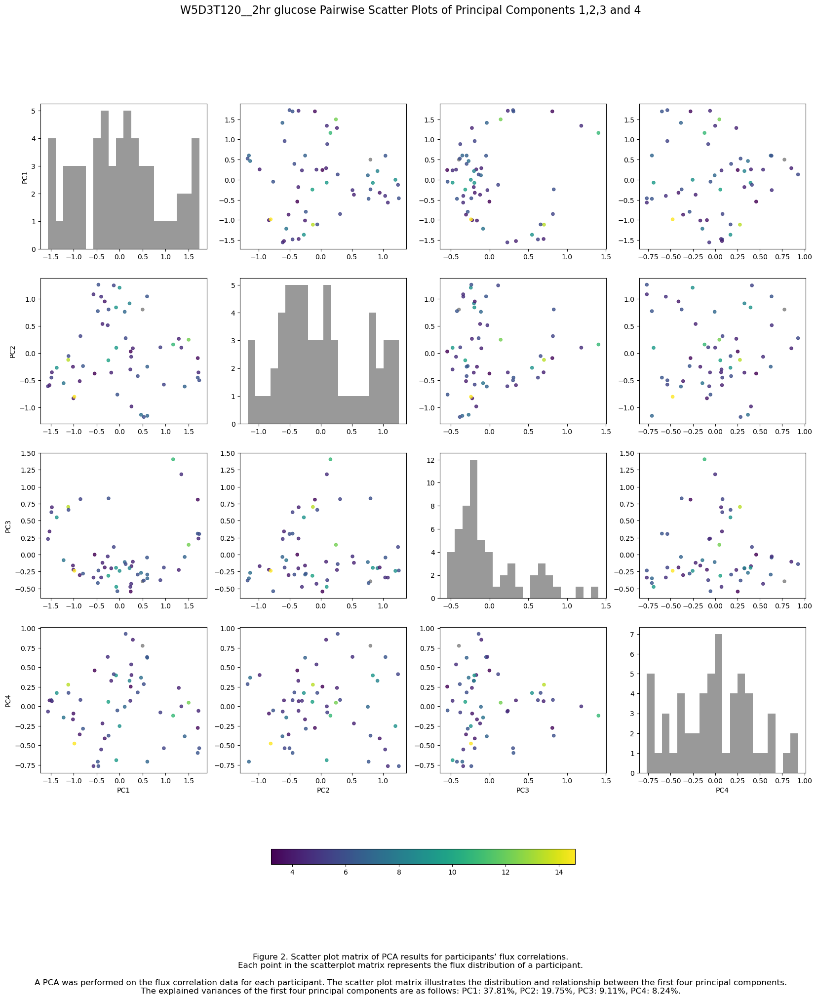

[0.378123   0.19748016 0.09114667]


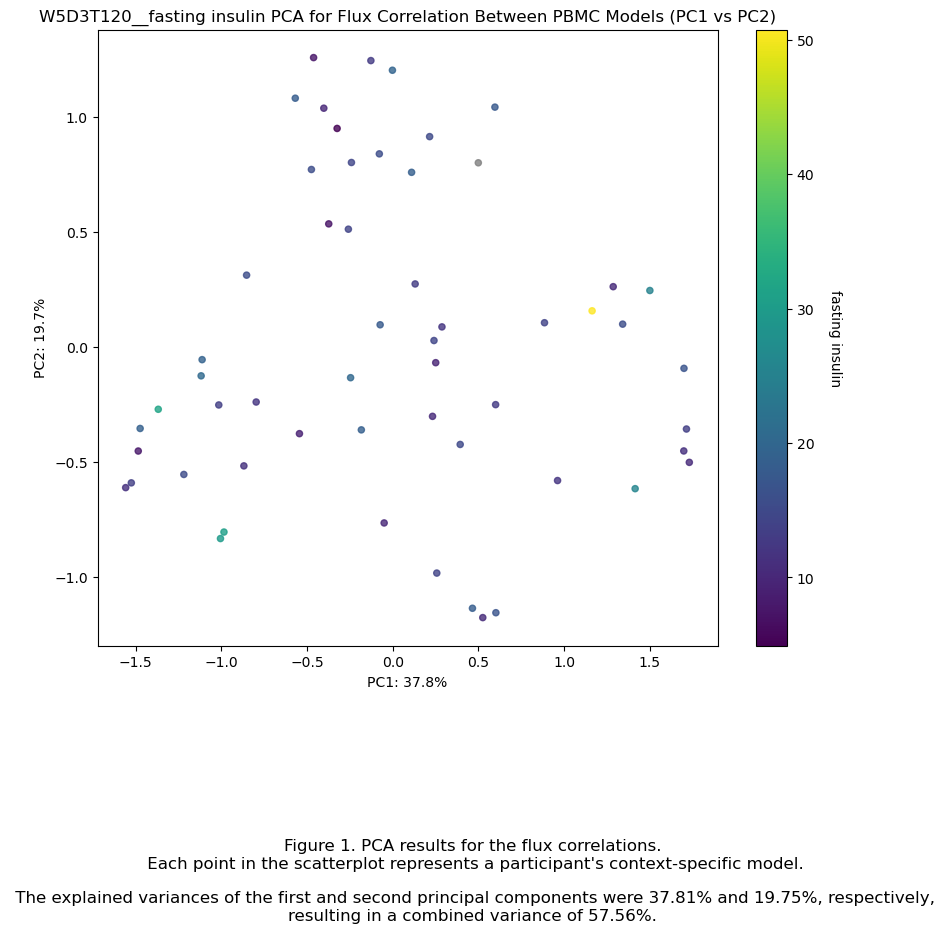

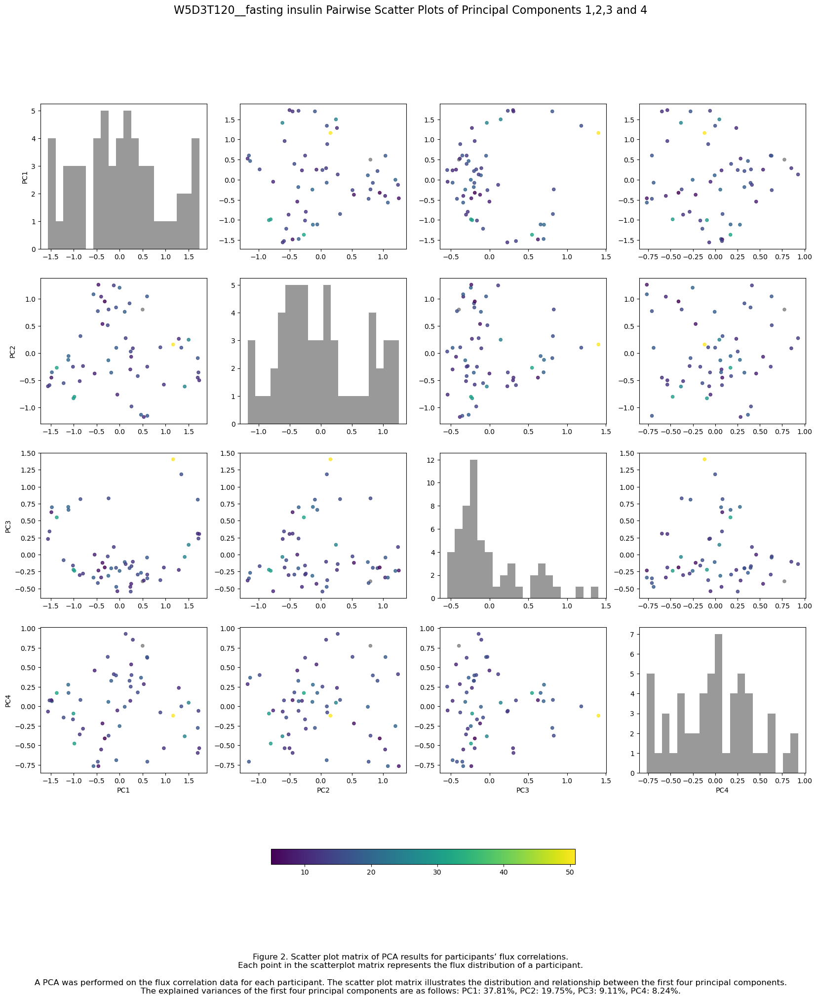

[0.378123   0.19748016 0.09114667]


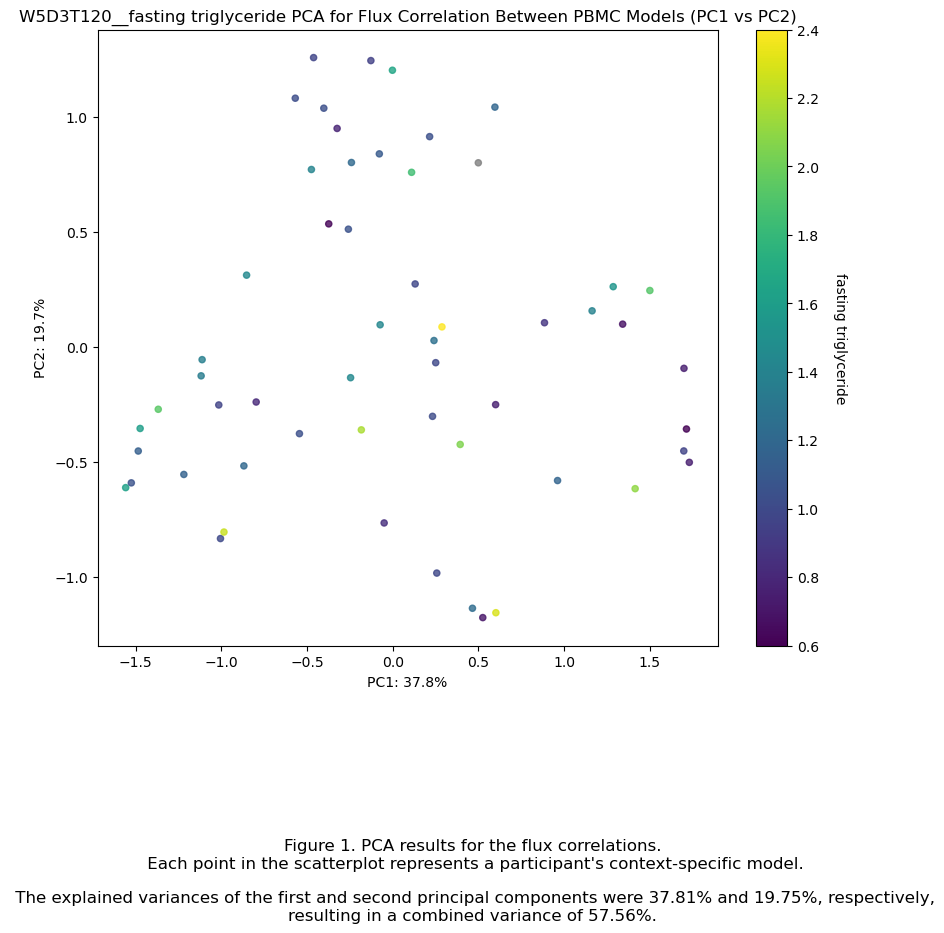

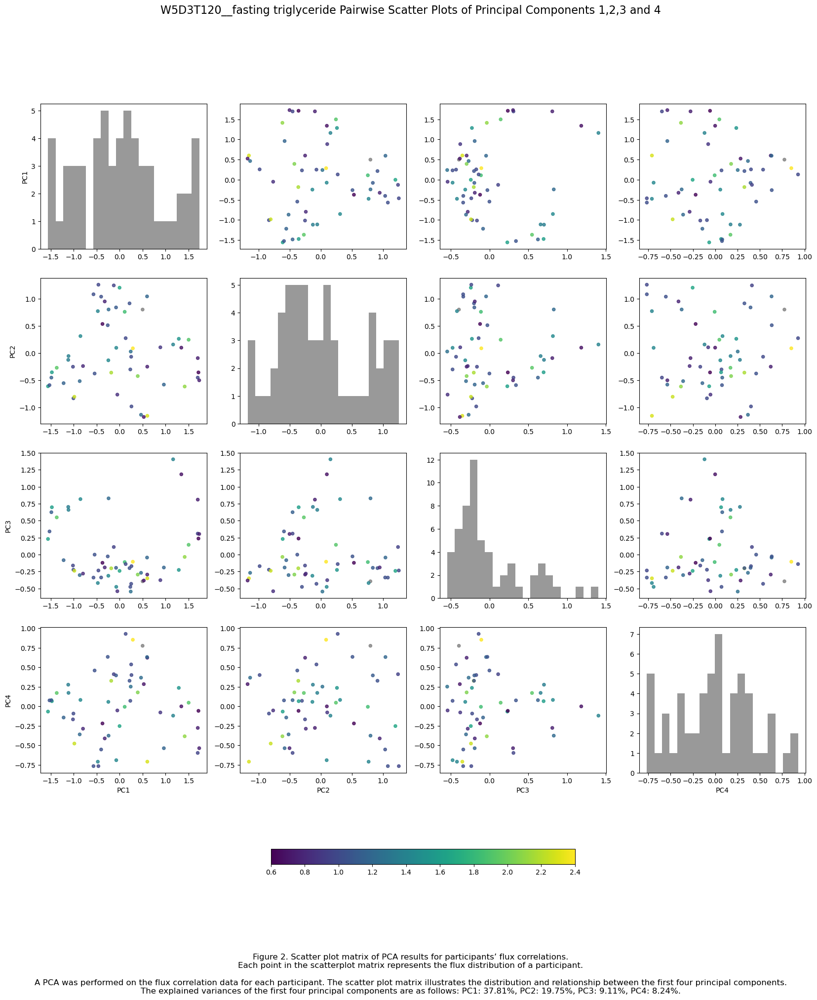

[0.378123   0.19748016 0.09114667]


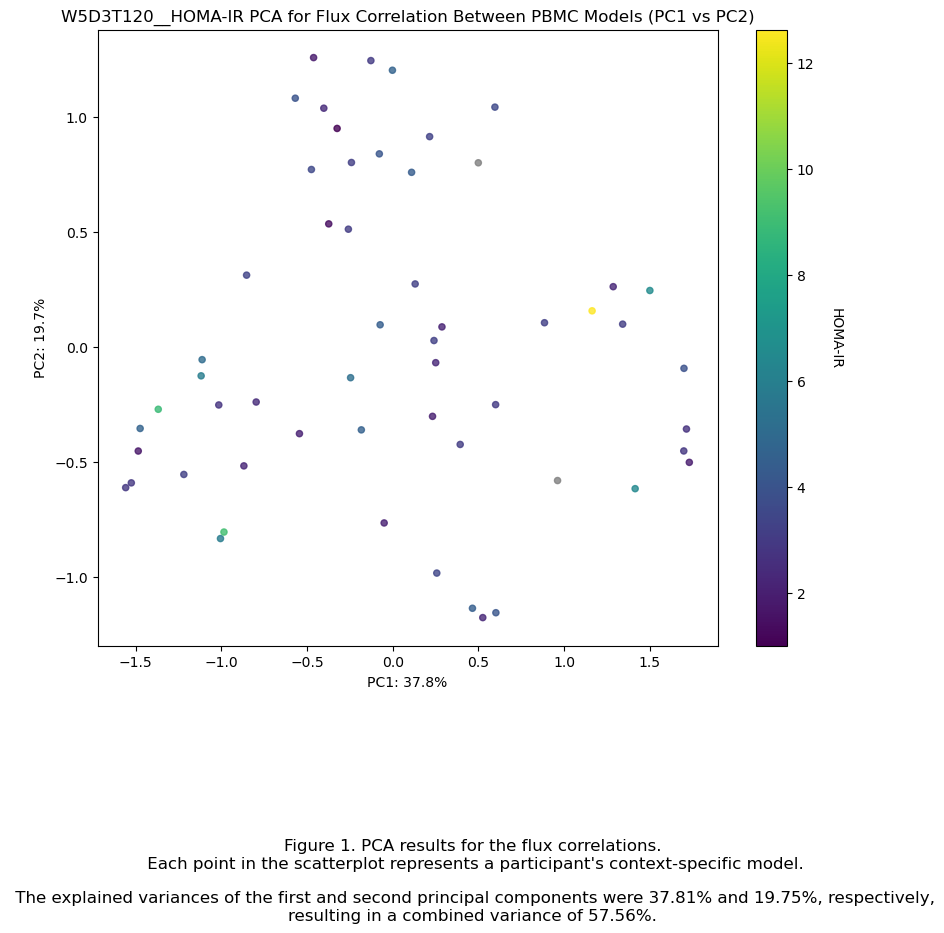

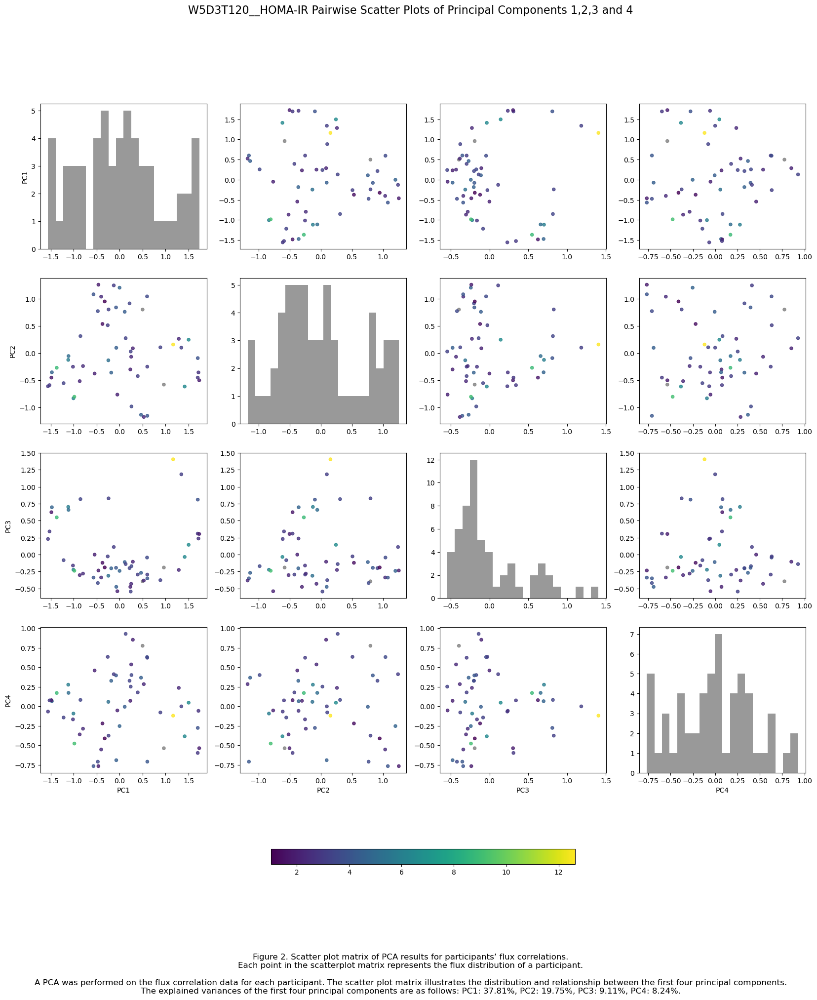

[0.378123   0.19748016 0.09114667]


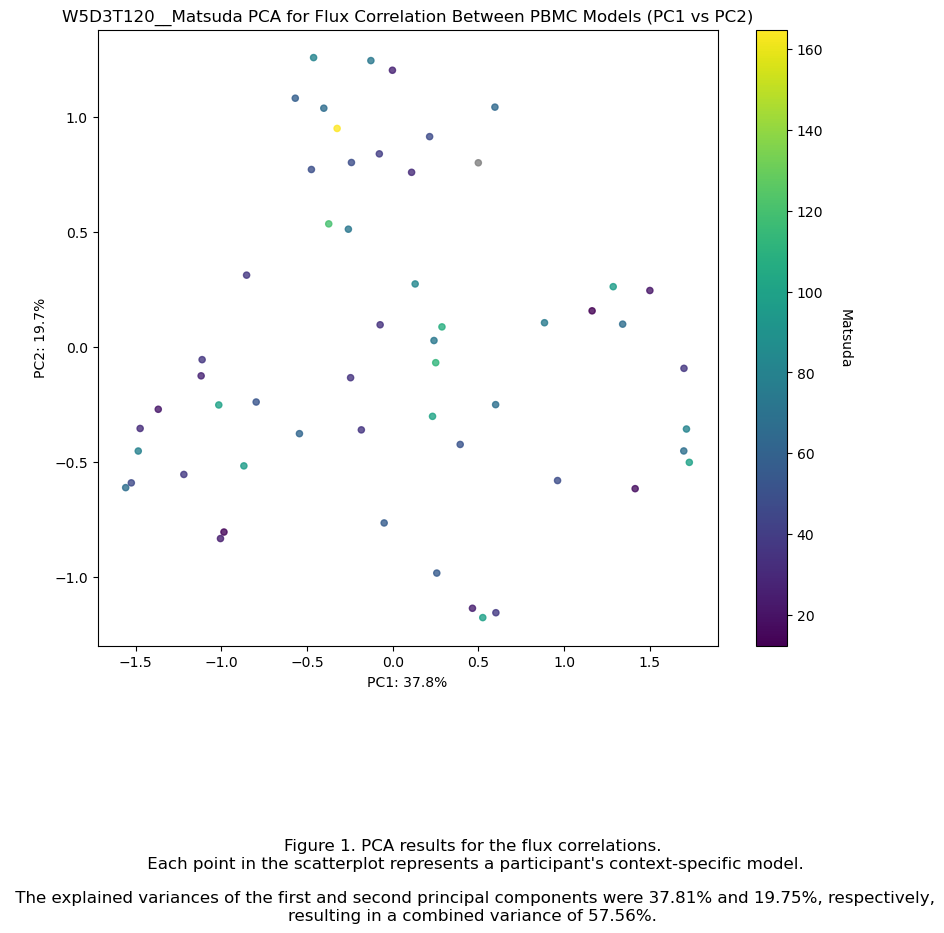

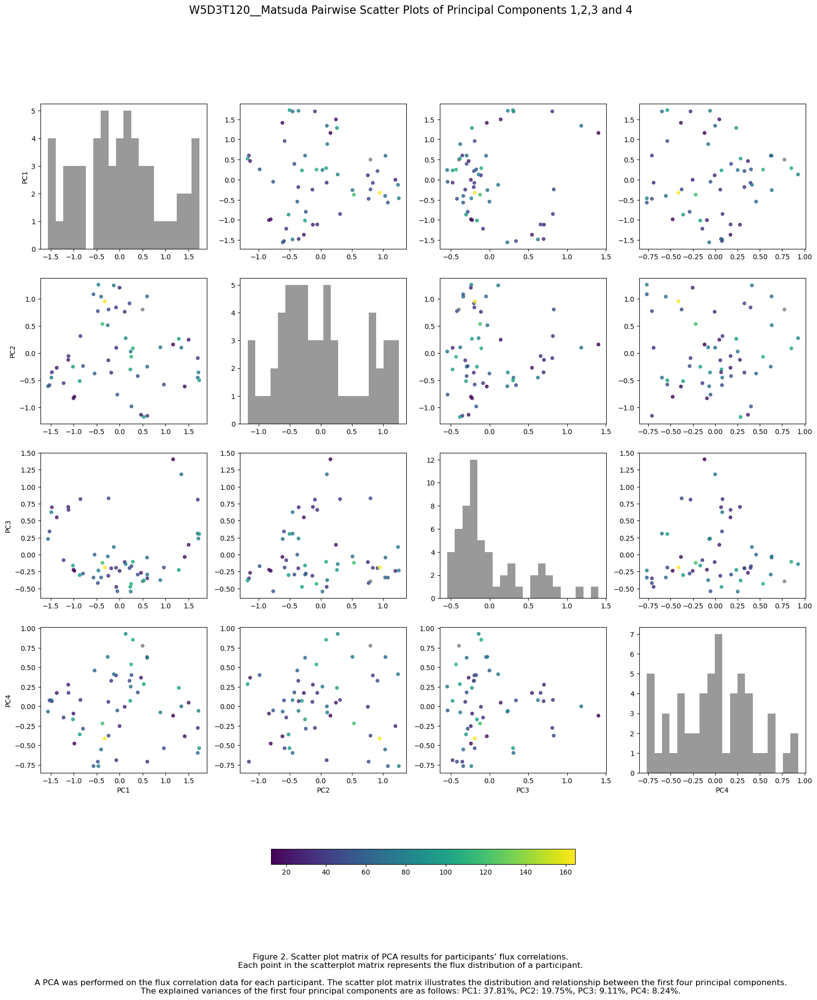

[0.378123   0.19748016 0.09114667]


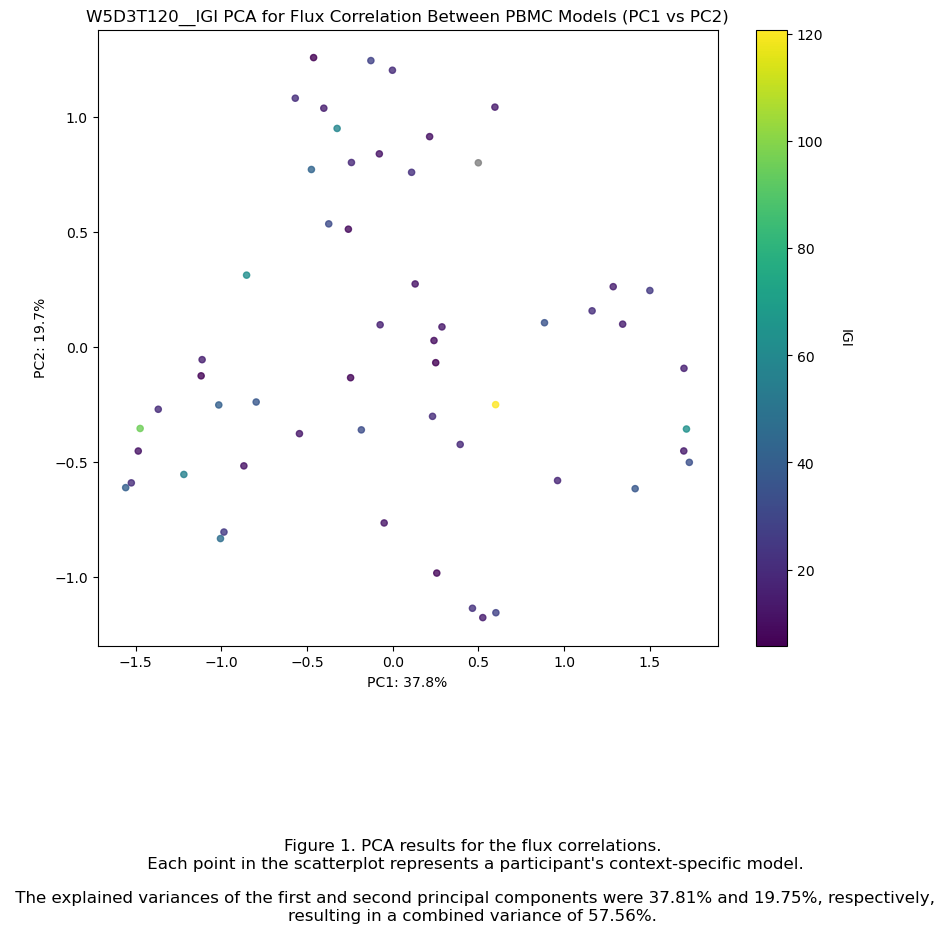

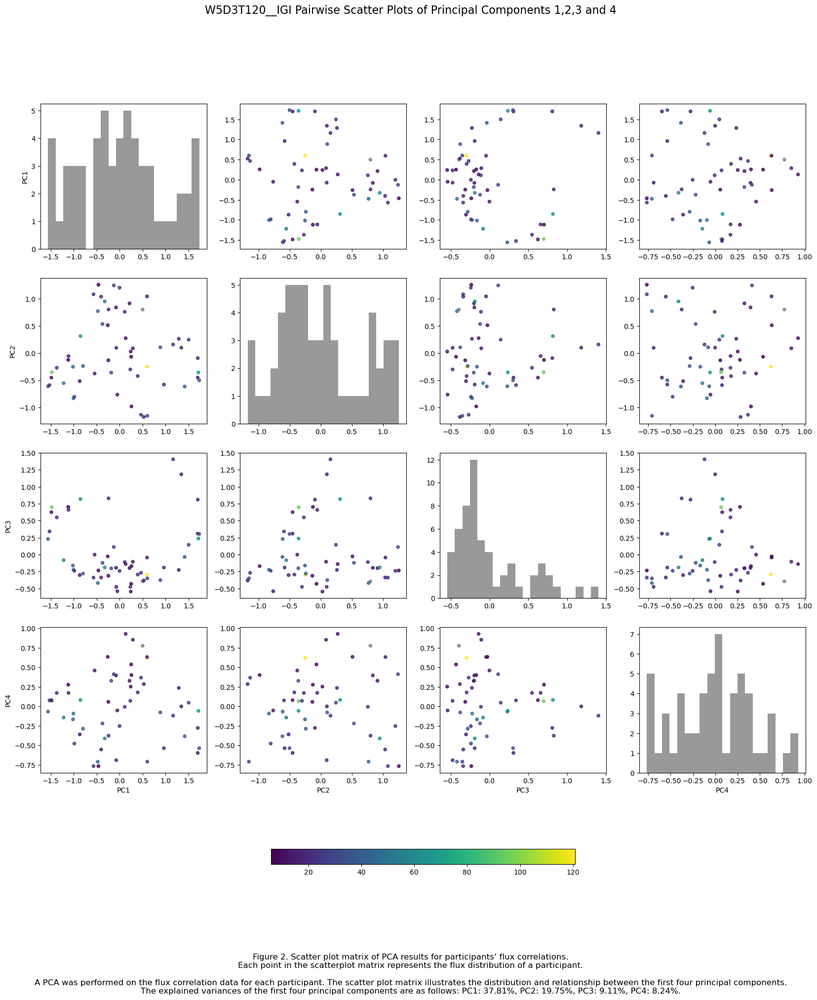

[0.378123   0.19748016 0.09114667]


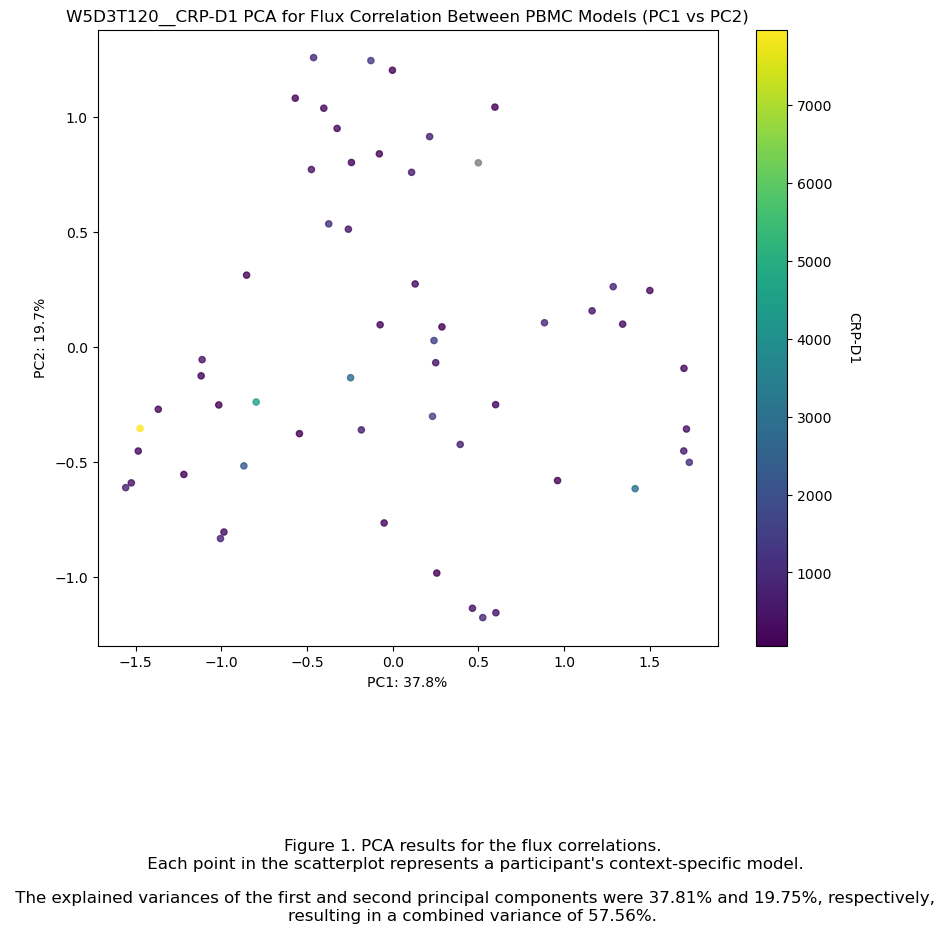

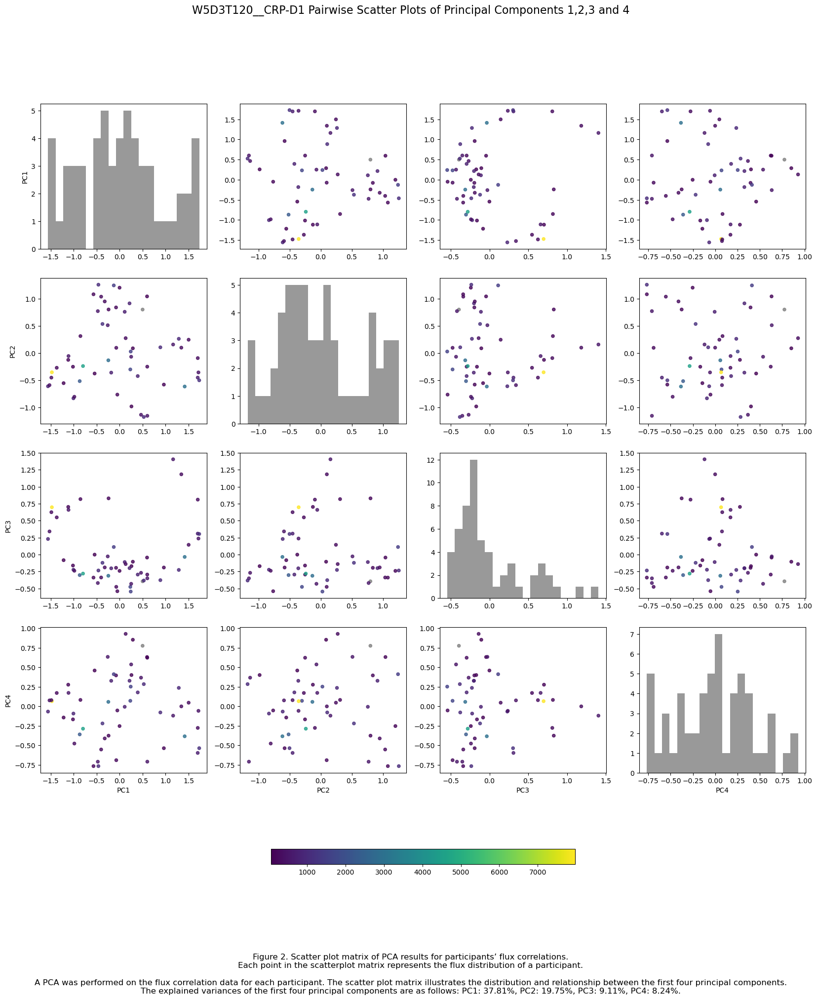

[0.378123   0.19748016 0.09114667]


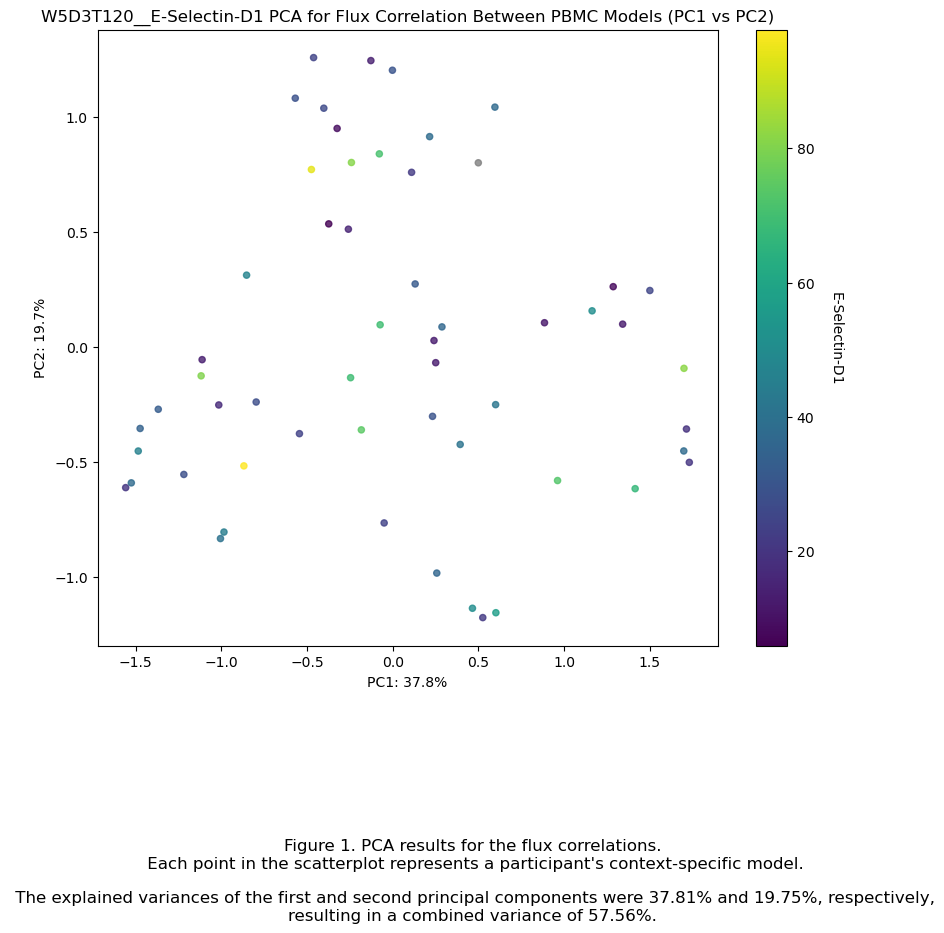

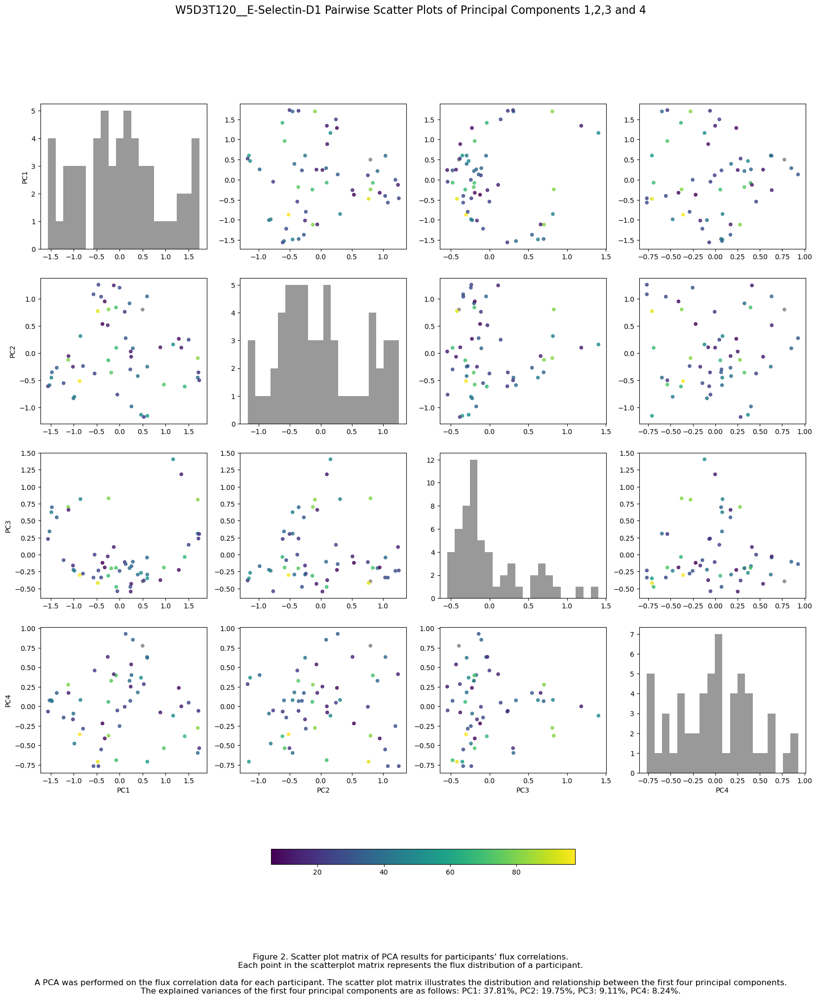

[0.378123   0.19748016 0.09114667]


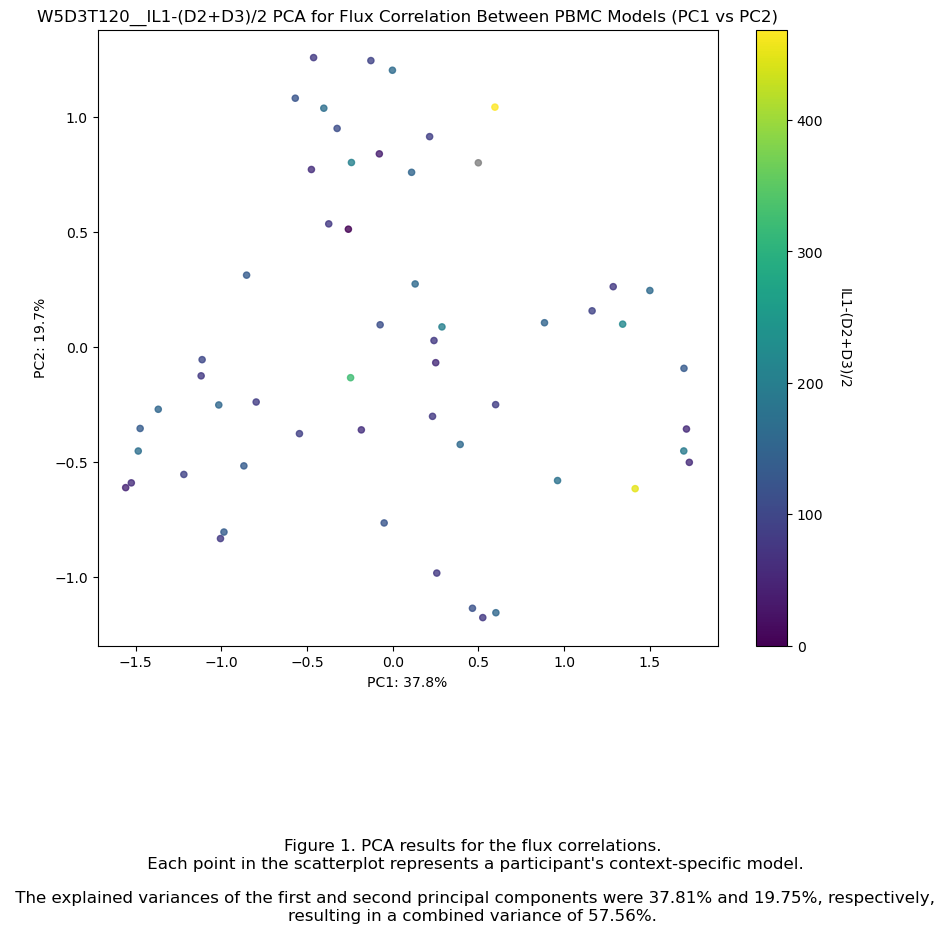

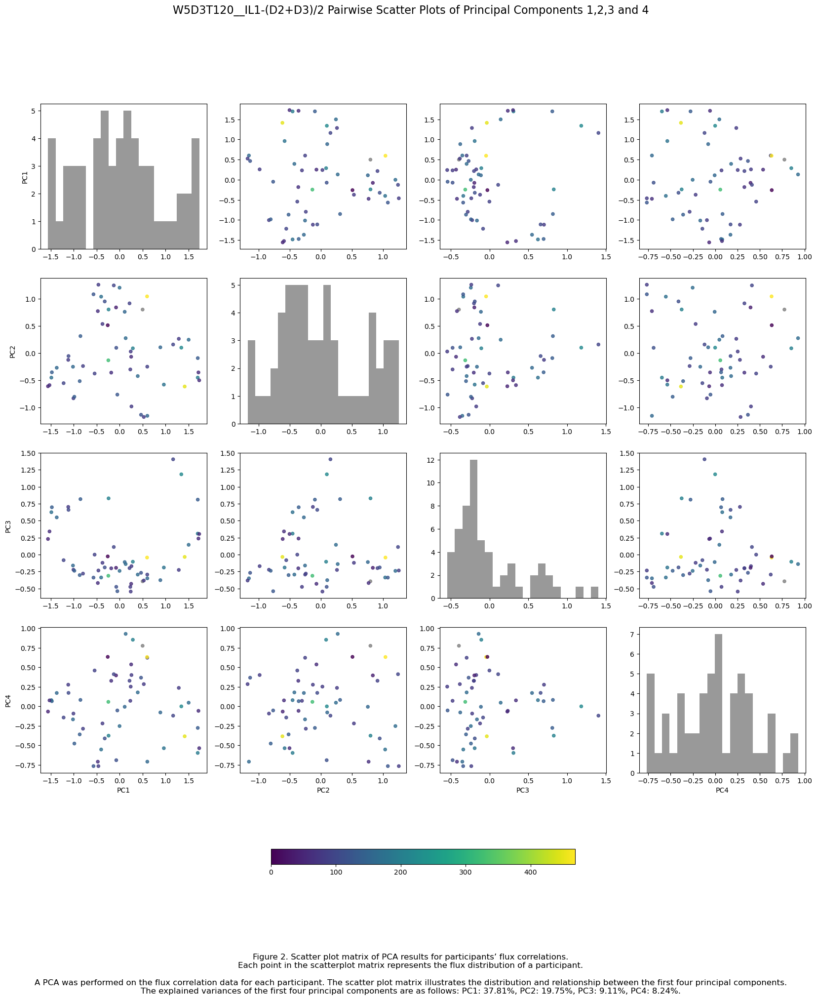

[0.378123   0.19748016 0.09114667]


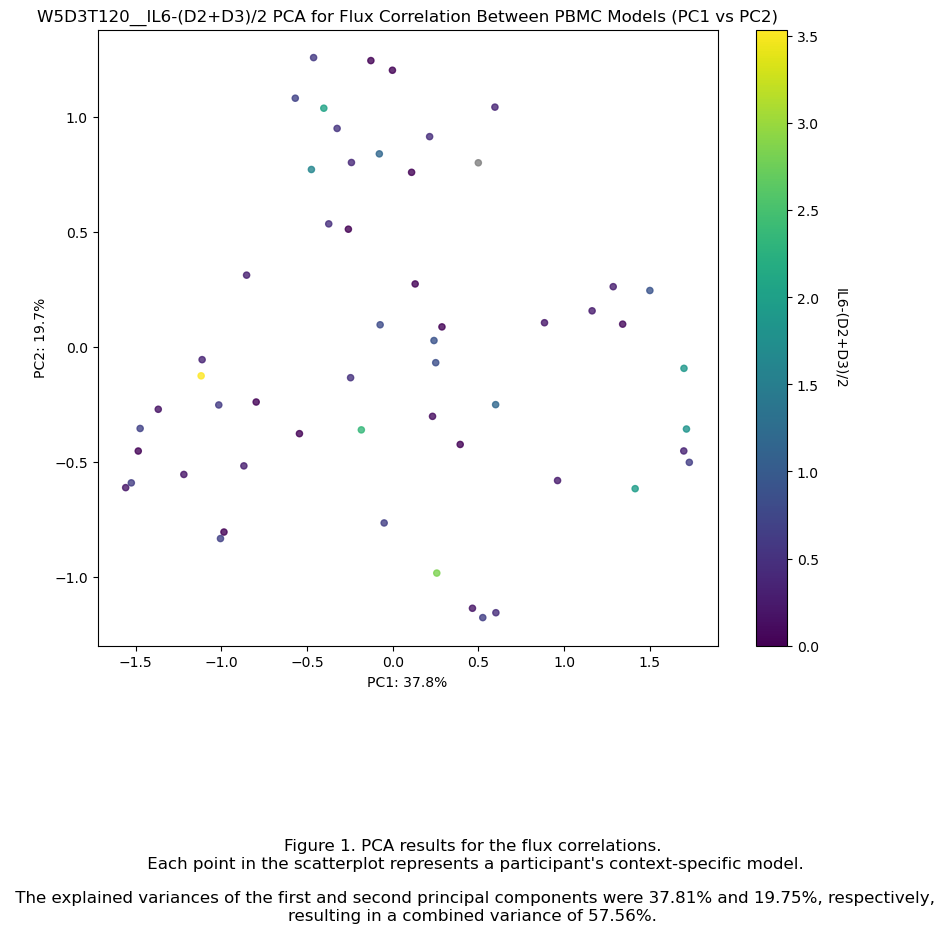

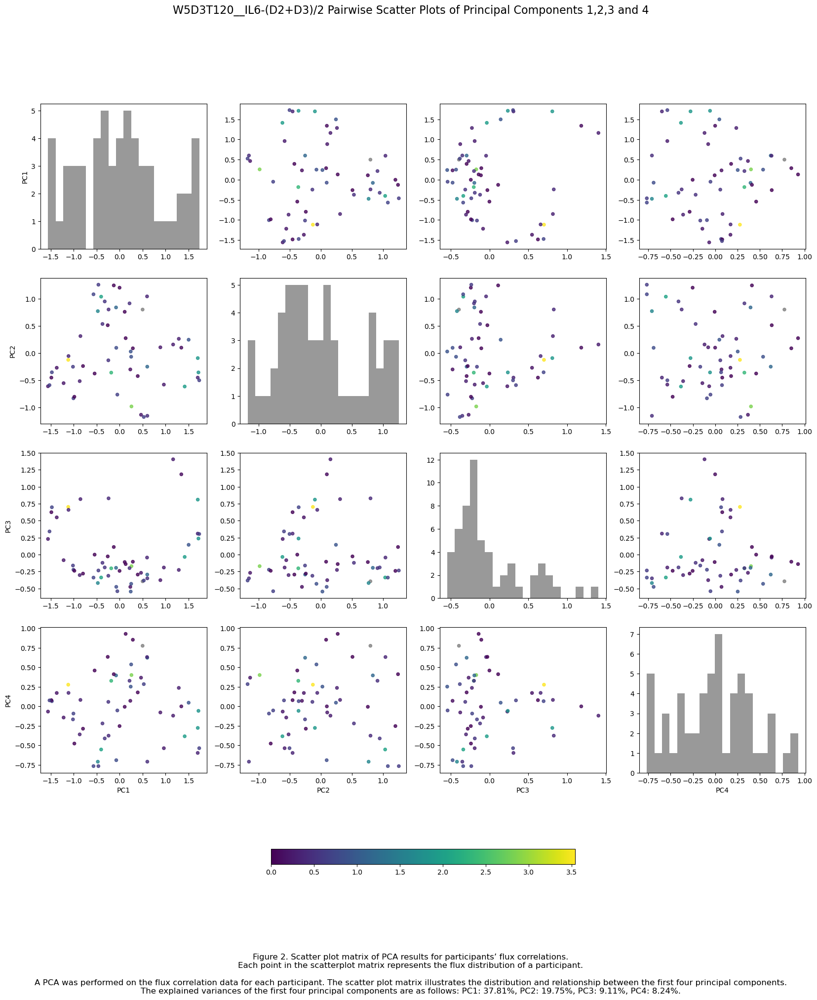

[0.378123   0.19748016 0.09114667]


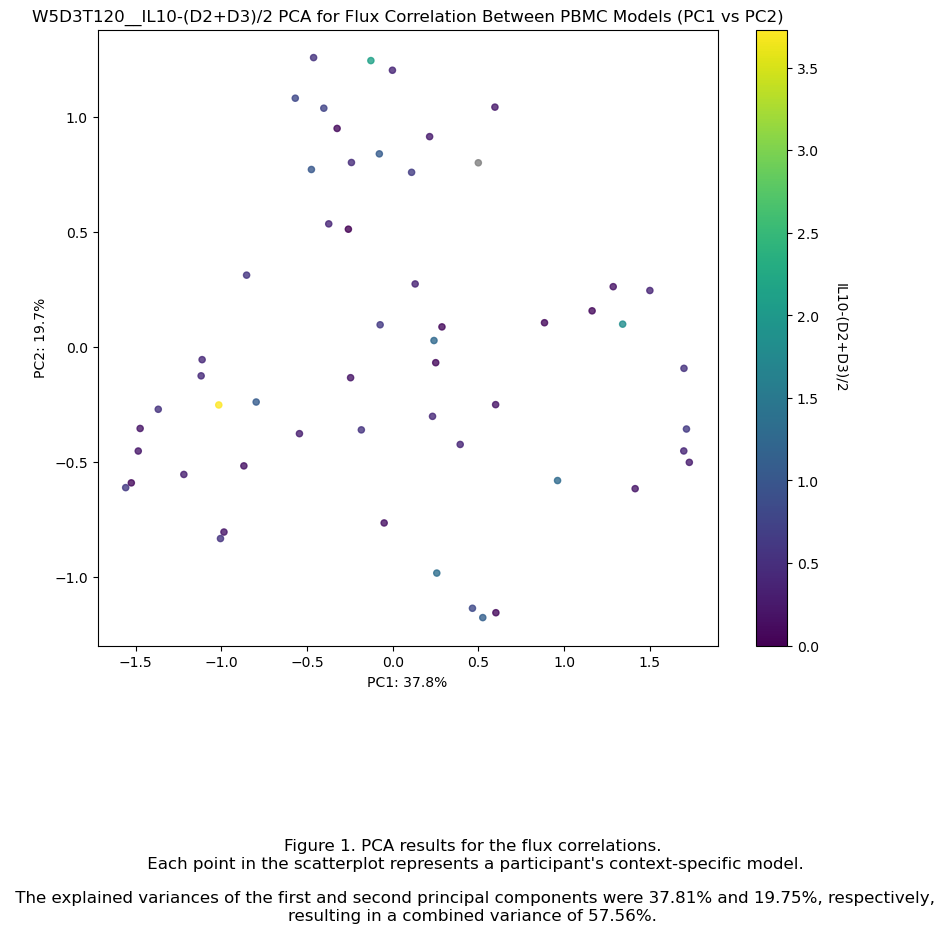

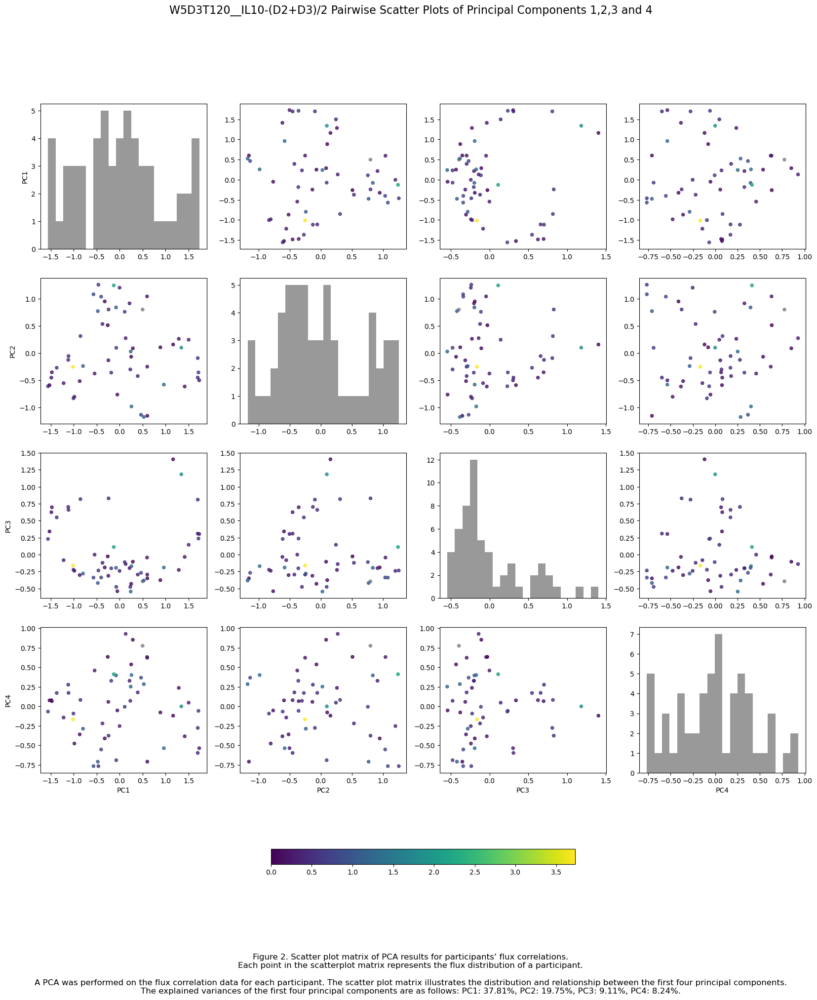

[0.378123   0.19748016 0.09114667]


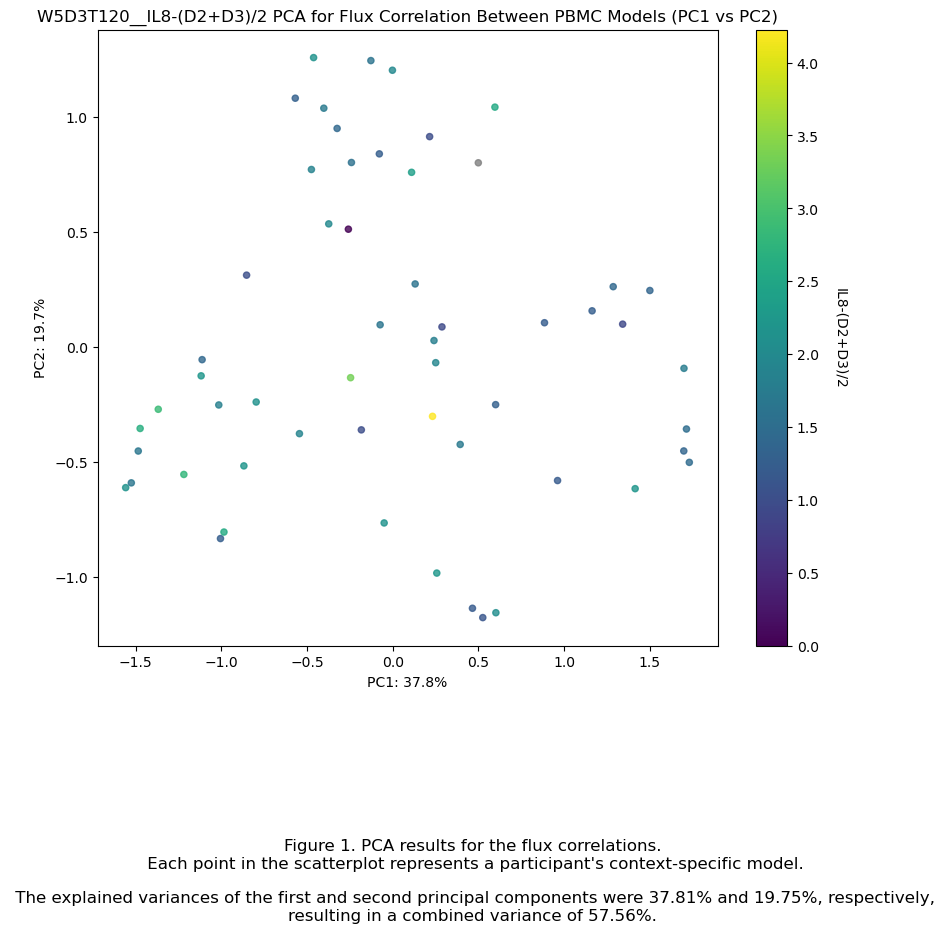

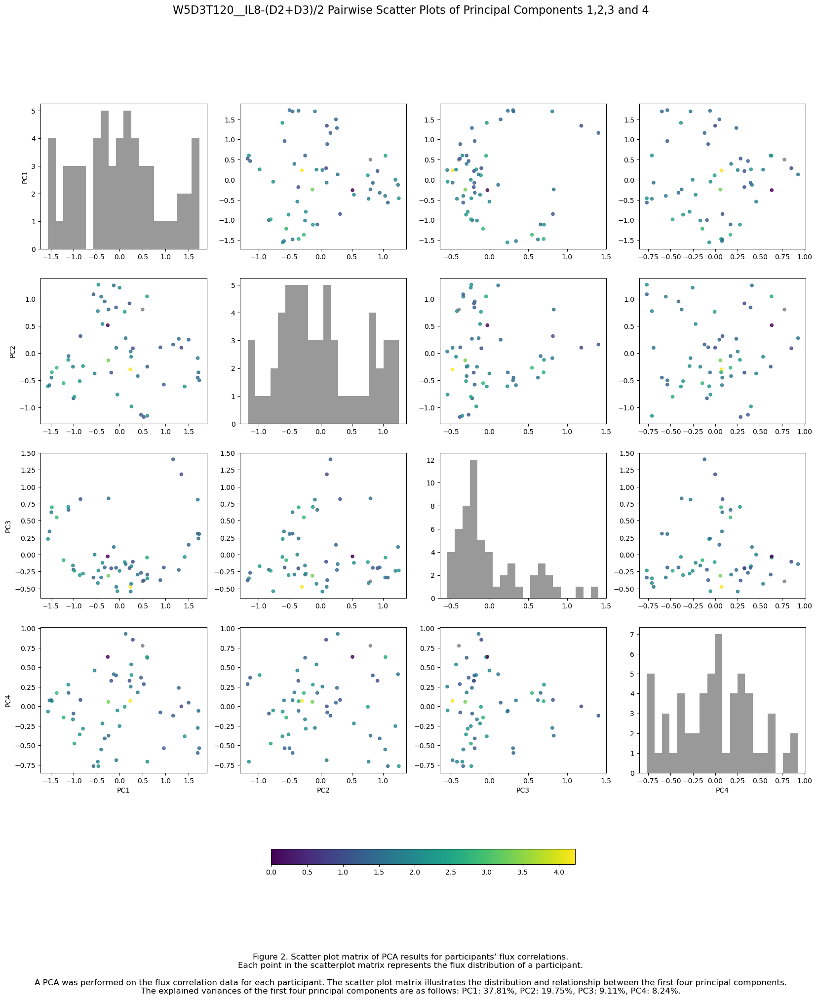

[0.378123   0.19748016 0.09114667]


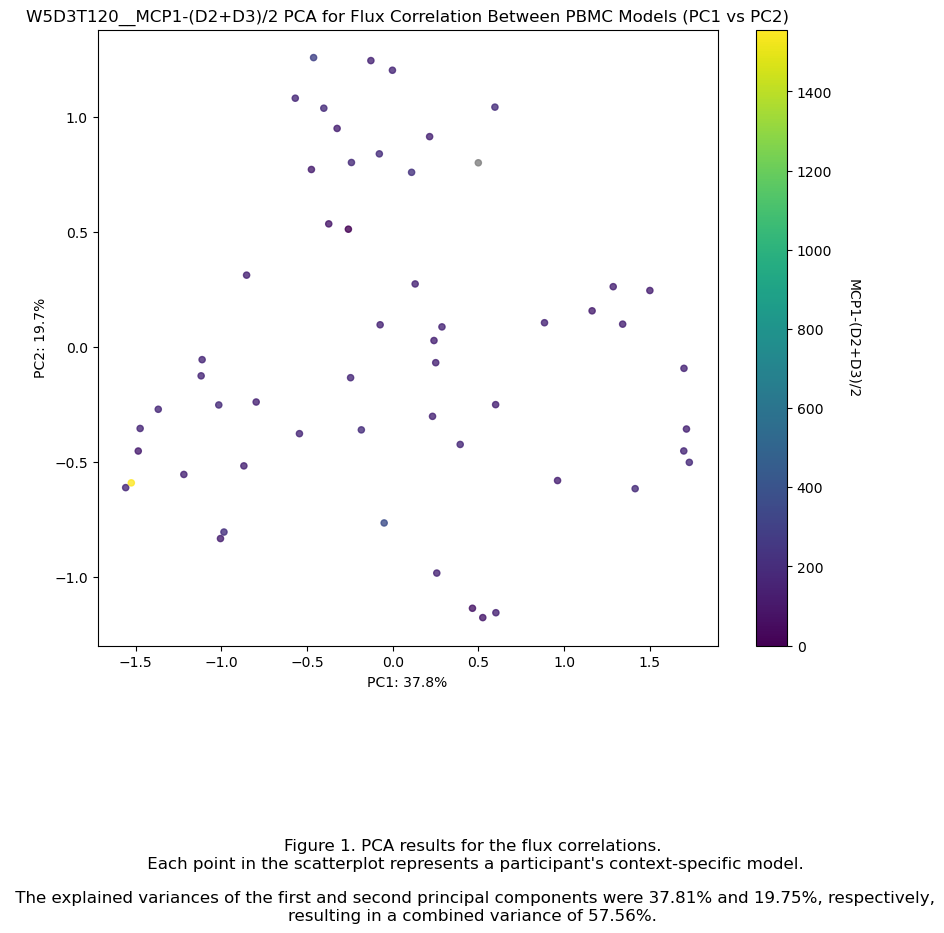

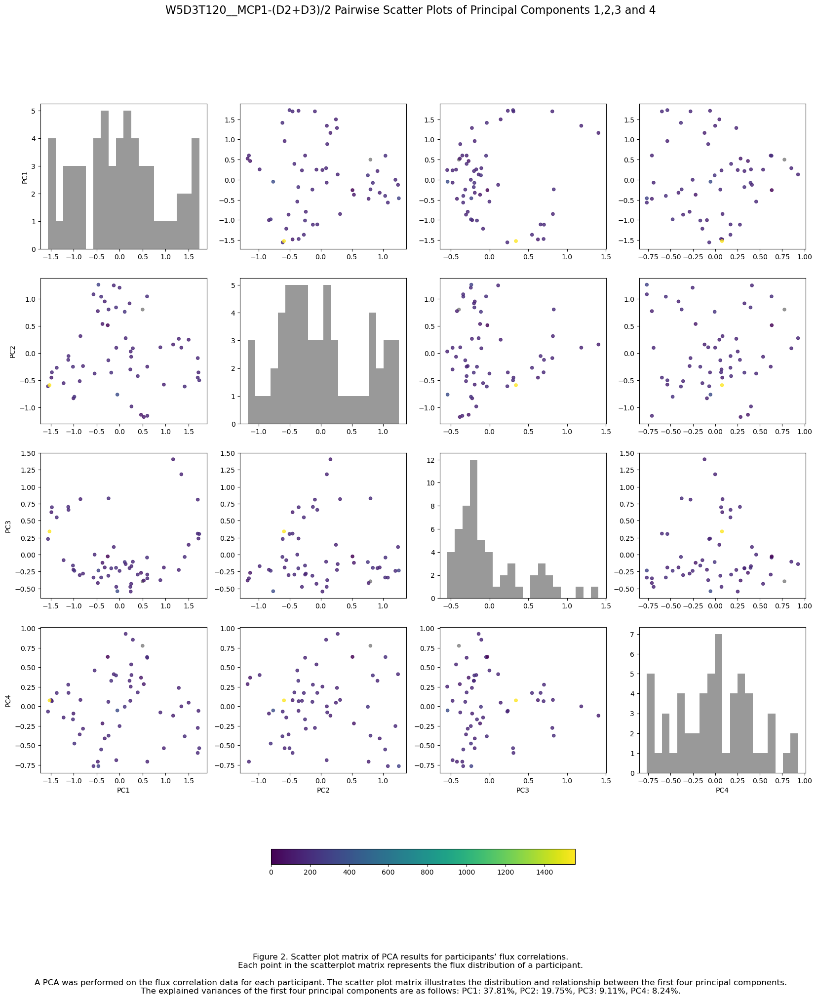

[0.378123   0.19748016 0.09114667]


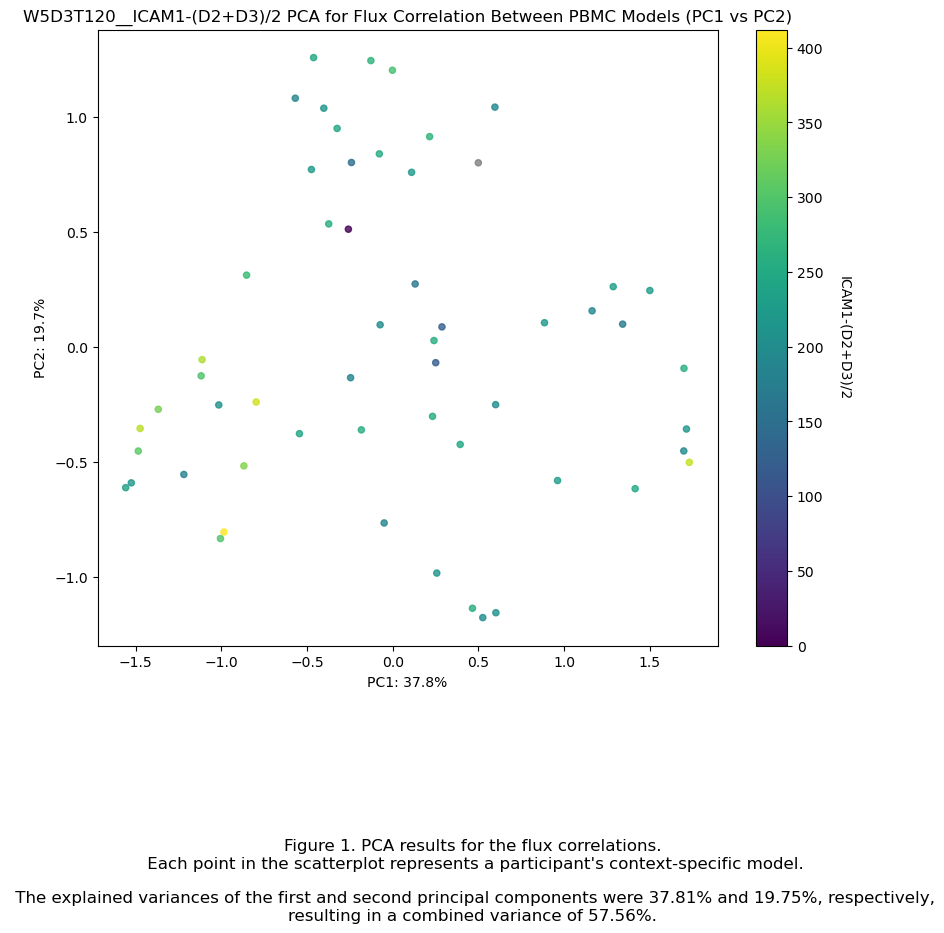

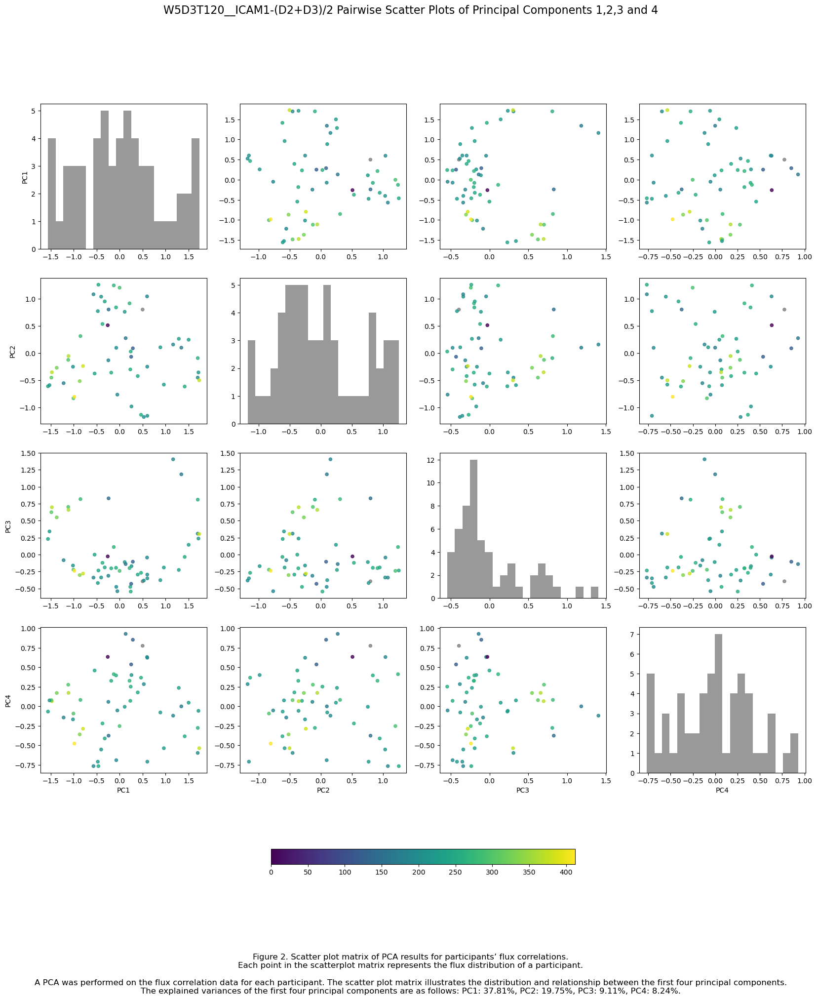

In [5]:
### with grey

import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D3T120_'
pw_flx1 = pd.read_csv('pw_flx2_2.csv')
columns_to_compare = ['Age', 'Body height ', 'BMI ', 'fasting glucose', '2hr glucose', 
                      'fasting insulin', 'fasting triglyceride', 'HOMA-IR', 'Matsuda', 'IGI', 'CRP-D1', 
                      'E-Selectin-D1', 'TNF-alpha-D1', 'VCAM-1-D1','adiponectin-D1', 'IL1b-D1', 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2', 
                      'MCP1-(D2+D3)/2', 'ICAM1-(D2+D3)/2']

#Index(['name', 'Age', 'Gender', 'Body weight ', 'Body height ', 'BMI ',
 #      'Start group', 'fasting glucose', '2hr glucose', 'fasting insulin',
  #     'fasting triglyceride', 'HOMA-IR', 'Matsuda', 'IGI', 'CRP-D1',
   #    'E-Selectin-D1', 'IL18-D1', 'IL1b-D1', 'TNF-alpha-D1', 'VCAM-1-D1',
    #   'adiponectin-D1', 'ICAM-D2', 'ICAM1-D3', 'IL1-D2', 'IL1-D3', 'IL10-D2',
     #  'IL10-D3', 'IL6-D2', 'IL6-D3', 'IL8-D2', 'IL8-D3', 'MCP1-D2', 'MCP1-D3',
      # 'IL1-(D2+D3)/2', 'IL6-(D2+D3)/2', 'IL10-(D2+D3)/2', 'IL8-(D2+D3)/2',
       #'MCP1-(D2+D3)/2', 'ICAM1-(D2+D3)/2'],
      #dtype='object')

# Load the entire Excel file
file_path = '/Users/douglas/Library/CloudStorage/OneDrive-UniversityCollegeCork/Msc Bioinformatics and Computational Biology/MB6303 Dissertion in Bioinformatics & Computational Biology/Practical Work/python_/week 12/NutriTech_otherdata_AVG.xlsx'
xls = pd.ExcelFile(file_path)

# Print the sheet names to see what sheets are available
print(xls.sheet_names)

# Load a sheet into a DataFrame by sheet name
df_week5_before = pd.read_excel(xls, sheet_name='week5_before_intervention', header=1)

# Extract the participant IDs from NutriTech data (assuming they are in 'name' column)
nutritech_ids = df_week5_before['name'].tolist()
# Extract the participant IDs from pw_flx1.csv column names
pw_flx1_ids = pw_flx1.columns.str.extract(r'(NT\d+)_')[0]

# Initialize lists to capture missing IDs and unmatched columns
missing_ids = []
unmatched_columns = pw_flx1.columns.tolist()

# Map the NutriTech IDs to the corresponding columns in pw_flx1.csv
mapping = {}
for nt_id in nutritech_ids:
    if nt_id in pw_flx1_ids.values:
        matched_column = pw_flx1.columns[pw_flx1_ids[pw_flx1_ids == nt_id].index[0]]
        mapping[nt_id] = matched_column
        unmatched_columns.remove(matched_column)
    else:
        missing_ids.append(nt_id)

# Print results
print("Correct Mapping of NutriTech IDs to pw_flx1.csv Columns:")
print(mapping)

if missing_ids:
    print("\nWarning: The following NutriTech IDs were not found in pw_flx1.csv:")
    print(missing_ids)

if unmatched_columns:
    print("\nWarning: The following columns in pw_flx1.csv did not match any NutriTech IDs:")
    print(unmatched_columns)

for NT_data in columns_to_compare:
    # Extract corresponding labels (numeric values) for the columns in pw_flx1.csv based on the mapping
    pca_labels = []
    for column in pw_flx1.columns:
        matched_id = next((key for key, value in mapping.items() if value == column), None)
        if matched_id:
            label = df_week5_before.loc[df_week5_before['name'] == matched_id, NT_data].values[0]
            pca_labels.append(label)
        else:
            pca_labels.append(np.nan)  # Handle missing data

    # Perform PCA
    pca = PCA(n_components=3)
    pcaData = pca.fit_transform(pw_flx1.T)  # Transpose to make samples as rows
    print(pca.explained_variance_ratio_)

    # Convert pca_labels to a numpy array for easier handling
    pca_labels = np.array(pca_labels)

    # Normalize pca_labels for color mapping
    norm = plt.Normalize(vmin=np.nanmin(pca_labels), vmax=np.nanmax(pca_labels))
    cmap = plt.cm.viridis  # You can choose any colormap

    # Define a color array: use cmap for valid data and grey for NaN
    colors = np.array([cmap(norm(val)) if not np.isnan(val) else (0.5, 0.5, 0.5, 1.0) for val in pca_labels])

    title_font = {
        'weight': 'medium',
        'size': 12,
    }
    axis_font = {
        'weight': 'normal',
        'size': 10,
    }

    # Plot PCA scatter plot with color gradient
    fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
    sc = plt.scatter(pcaData[:, 0], pcaData[:, 1], s=20, marker='o', color=colors, alpha=0.8)

    # Add color bar for non-NaN values only
    valid_sc = plt.scatter([], [], c=[], cmap=cmap, norm=norm)
    cbar = plt.colorbar(valid_sc)
    cbar.set_label(f'{NT_data}', rotation=270, labelpad=20)

    plt.title(f'{file_ID}_{NT_data} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', title_font)
    plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), axis_font)
    plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), axis_font)
    plt.figtext(0.5, -0.23, (f'Figure 1. PCA results for the flux correlations.\n Each point in the scatterplot represents a participant\'s context-specific model.\n\n The explained variances of the first and second principal components were {pca.explained_variance_ratio_[0]*100:.2f}% and {pca.explained_variance_ratio_[1]*100:.2f}%, respectively, resulting in a combined variance of {((pca.explained_variance_ratio_[0]*100)+(pca.explained_variance_ratio_[1]*100)):.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)
    #plt.savefig(f'{file_ID}fig.1_{NT_data}_PCA_for_Flux_Correlation.png', dpi=1000)

    ####################### Create a 4x4 plot matrix of PC1, PC2, PC3, and PC4
    # Perform PCA
    pca = PCA(n_components=4)
    pcaData = pca.fit_transform(pw_flx1.T)
    explained_variance = pca.explained_variance_ratio_

    fig, axs = plt.subplots(4, 4, figsize=(20, 20))

    pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
    components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

    for i in range(4):
        for j in range(4):
            if i == j:
                axs[i, j].hist(components[i], bins=20, color='gray', alpha=0.8)  # Histogram does not need color mapping
            else:
                sc = axs[i, j].scatter(components[j], components[i], color=colors, s=20, alpha=0.8)
            if i == 3:
                axs[i, j].set_xlabel(pc_labels[j])
            if j == 0:
                axs[i, j].set_ylabel(pc_labels[i])

    # Add a shared color bar
    fig.colorbar(valid_sc, ax=axs, orientation='horizontal', fraction=0.02, pad=0.1)

    plt.suptitle(f'{file_ID}_{NT_data} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
    plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                             f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                             f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                             f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

    #plt.savefig(f'{file_ID}fig.2_{NT_data}_Pairwise_Scatter_Plots_of_PC1_to_PC4.png', dpi=1000)
    plt.show()


# W5D3T*, with plotly


[0.37920059 0.23307487 0.17100745]


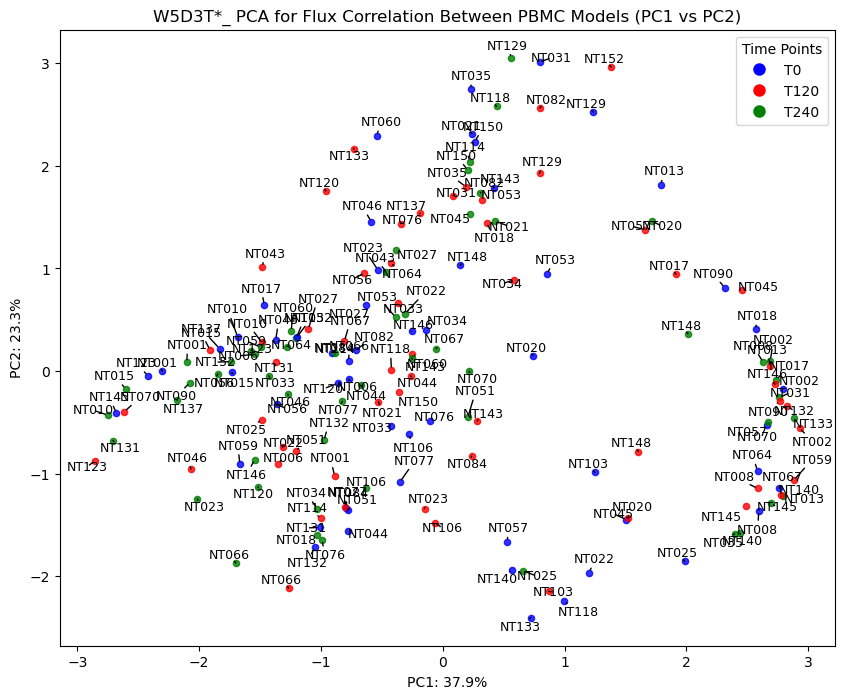

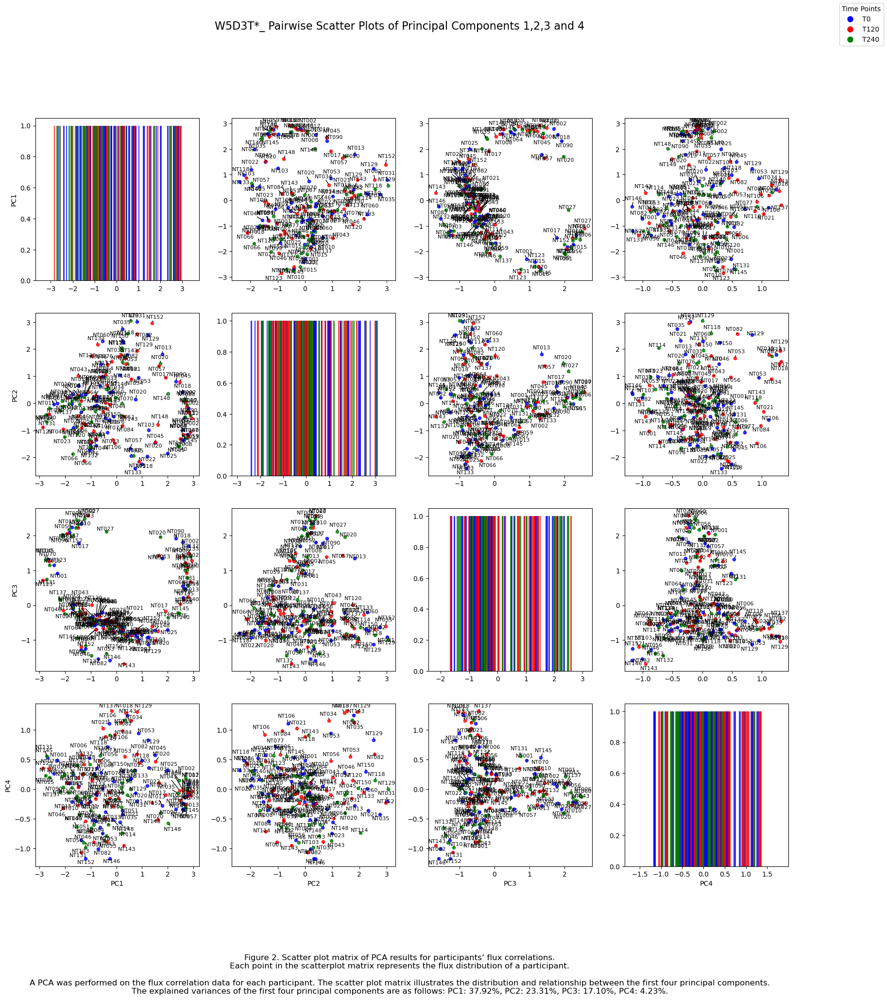

In [2]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Load your pw_flx3 data from the CSV file
pw_flxload = pd.read_csv('pw_flx2_4.csv')

# Extract sample labels (T0, T120, or T240) from the column names
labels = [col.split('T')[-1] for col in pw_flxload.columns]

# Extract NT numbers from column names
nt_numbers = [col.split('/')[-1].split('_')[0] for col in pw_flxload.columns]

# Set the file_ID for naming plots and saved figures
file_ID = 'W5D3T*_'

# Perform PCA for PC1 vs PC2
pca = PCA(n_components=3)
pcaData = pca.fit_transform(pw_flxload.T)  # Transpose to make samples as rows
print(pca.explained_variance_ratio_)

# Color coding based on time points
colors = ['blue' if label == '0' else 'red' if label == '120' else 'green' for label in labels]

# Plot PCA scatter plot with labels
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 8))
texts = []
for i in range(len(labels)):
    xs = pcaData[i, 0]
    ys = pcaData[i, 1]
    plt.scatter(xs, ys, s=20, marker='o', color=colors[i], alpha=0.8)
    texts.append(plt.text(xs, ys, nt_numbers[i], fontsize=9, ha='center', color='black'))

# Adjust text to avoid overlap
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'))

# Add legend and labels
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='T0'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='T120'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='T240')]
plt.legend(handles=handles, title="Time Points")

plt.title(f'{file_ID} PCA for Flux Correlation Between PBMC Models (PC1 vs PC2)', fontsize=12)
plt.xlabel('PC1: {:.1%}'.format(pca.explained_variance_ratio_[0]), fontsize=10)
plt.ylabel('PC2: {:.1%}'.format(pca.explained_variance_ratio_[1]), fontsize=10)
plt.show()

# Perform PCA for PC1 to PC4
pca = PCA(n_components=4)
pcaData = pca.fit_transform(pw_flxload.T)
explained_variance = pca.explained_variance_ratio_

fig, axs = plt.subplots(4, 4, figsize=(20, 20))

pc_labels = ['PC1', 'PC2', 'PC3', 'PC4']
components = [pcaData[:, 0], pcaData[:, 1], pcaData[:, 2], pcaData[:, 3]]

# Annotate points with NT numbers and adjust text positions for scatterplot matrix
for i in range(4):
    for j in range(4):
        if i == j:
            for k, c in zip(components[i], colors):
                axs[i, j].hist(k, bins=20, color=c, alpha=0.8)
        else:
            texts = []
            for x, y, c, nt_number in zip(components[j], components[i], colors, nt_numbers):
                axs[i, j].scatter(x, y, color=c, s=20, alpha=0.8)
                texts.append(axs[i, j].text(x, y, nt_number, fontsize=8, ha='center', color='black'))
            adjust_text(texts, ax=axs[i, j], arrowprops=dict(arrowstyle='-', color='black'))  # Adjust text

        if i == 3:
            axs[i, j].set_xlabel(pc_labels[j])
        if j == 0:
            axs[i, j].set_ylabel(pc_labels[i])

# Add a legend
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='T0'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='T120'),
           plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='T240')]
fig.legend(handles=handles, title="Time Points", loc='upper right')

plt.suptitle(f'{file_ID} Pairwise Scatter Plots of Principal Components 1,2,3 and 4', fontsize=16, weight='medium')
plt.figtext(0.5, -0.02, (f'Figure 2. Scatter plot matrix of PCA results for participants’ flux correlations.\n'
                         f'Each point in the scatterplot matrix represents the flux distribution of a participant.\n\n'
                         f'A PCA was performed on the flux correlation data for each participant. The scatter plot matrix illustrates the distribution and relationship between the first four principal components.\n'
                         f'The explained variances of the first four principal components are as follows: PC1: {explained_variance[0]*100:.2f}%, PC2: {explained_variance[1]*100:.2f}%, PC3: {explained_variance[2]*100:.2f}%, PC4: {explained_variance[3]*100:.2f}%.'), wrap=True, horizontalalignment='center', fontsize=12)

plt.show()


In [3]:
# Set the file_ID for naming plots and saved figures
file_ID = 'W5D3T0_T120'
flxID= 'pw_flx2_5.csv'

